In [1]:
import xarray as xr
#import rioxarray as rxr
import xesmf as xe
import pandas as pd
import numpy as np
import calendar as cld
import matplotlib.pyplot as plt
import matplotlib.colors
colors_land = plt.cm.terrain(np.linspace(0.25, 1, 256))
import proplot as pplt # New plot library (https://proplot.readthedocs.io/en/latest/)
pplt.rc['savefig.dpi'] = 300 # 1200 is too big! #https://proplot.readthedocs.io/en/latest/basics.html#Creating-figures
from scipy.stats import chi2
from numba import njit,prange
import matplotlib as mpl
mpl.rcParams['hatch.linewidth'] = 0.05  # previous pdf hatch linewidth
from matplotlib.dates import DateFormatter

from pyproj import CRS,Transformer,Proj

import sys
sys.path.insert(1, '/home/castelli/Notebooks/PhD/utils') # to include my util file in previous directory
import utils as u
u.check_python_version()

3.10.13 | packaged by conda-forge | (main, Oct 26 2023, 18:07:37) [GCC 12.3.0]


In [2]:
def daily_to_monthly(var_array,leap_year): # var_array must be 365 or 366 days, in shape [time,x,y]
    list_monthly_var = []
    day = 0
    
    if leap_year:
        month_days = [31,29,31,30,31,30,31,31,30,31,30,31]
    else:
        month_days = [31,28,31,30,31,30,31,31,30,31,30,31]
    
    for i in range(12):
        eom = day + month_days[i] #eom : end of month
        result = var_array[day:eom].mean(axis=0)
        list_monthly_var.append(result)
        day = eom

    monthly_var = np.stack(list_monthly_var)
    return monthly_var

In [3]:
ds = xr.open_dataset('/bettik/beaumetj/MARout/MAR-EC-Earth3/MARgrid_EUe.nc')

imin = 32 ; imax = -30
jmin = 20 ; jmax = -15
lon = np.array(ds.LON[jmin:jmax,imin:imax])
lat = np.array(ds.LAT[jmin:jmax,imin:imax])
H = np.array(ds.SH[jmin:jmax,imin:imax])
nlat,nlon = 91, 139

normal_format = {'gridlinewidth':0.1, 'gridcolor':'gray8', 'gridalpha':0.5, 'coast':True,'borders':True ,'reso':'hi', 'labels':True,
                 'lonlines':2, 'latlines':2, 'abc':False, 'latlim':[43.,48.5],'lonlim':[4.,16.]}
big_format = {'gridlinewidth':0.1, 'gridcolor':'gray8', 'gridalpha':0.5, 'coast':True,'borders':True ,'reso':'hi', 'labels':True,
              'lonlines':2, 'latlines':2, 'abc':False, 'latlim':[42.,50],'lonlim':[3.,18.]}
multiplot_format = {'gridlinewidth':0.1, 'gridcolor':'gray8', 'gridalpha':0.5, 'coast':True,'borders':True ,'reso':'hi', 'labels':False, 'lonlines':2,
                    'latlines':2, 'abc':False, 'latlim':[43.,48.5],'lonlim':[4.,16.]}

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

veg_mar = ['No Veg.', # 0
           'Crops Low', # 1
           'Crops Medium', # 2
           'Crops High', # 3
           'Grass low', # 4
           'Grass Medium', # 5
           'Grass High', # 6
           'Broadleaf Low', # 7
           'Broadleaf Medium', # 8
           'Broadleaf High', # 9
           'Needle Low', # 10
           'Needle Medium', # 11
           'Needle High', # 12
           'City'] # 13

In [4]:
ds

<xarray.Dataset>
Dimensions:  (sector: 3, y: 126, x: 201)
Coordinates:
  * sector   (sector) float32 1.0 2.0 3.0
  * x        (x) float32 -483.0 -476.0 -469.0 -462.0 ... 896.0 903.0 910.0 917.0
  * y        (y) float32 -308.0 -301.0 -294.0 -287.0 ... 546.0 553.0 560.0 567.0
Data variables:
    FRV      (sector, y, x) float32 ...
    LAT      (y, x) float32 ...
    LON      (y, x) float32 ...
    MSK      (y, x) float32 ...
    SH       (y, x) float32 ...
    SOL      (y, x) float32 ...
    SRF      (y, x) float32 ...
    VEG      (sector, y, x) float32 ...
Attributes:
    title:        ICE - Exp: y50 - 19811201
    institution:  ULg (Xavier Fettweis)
    history:      Fri Dec 17 11:42:05 2021: ncks -v LAT,LON,MSK,SH,SOL,SRF,VE...
    netcdf:       4.1.1 of Feb 12 2011 08:44:29 $
    NCO:          netCDF Operators version 4.9.1 (Homepage = http://nco.sf.ne...

In [5]:
# function for seasonal mean (from Ian)
def season_mean(ds, calendar="standard"):
    #make a DataArray with the season of each day
    seas_array = ds.time.dt.season
    
    # count days in winter season (varies with leap years)
    nb_DJF = seas_array.str.count('DJF').sum()
    
    wgt_DJF = 1/nb_DJF.values.item()
    wgt_MAM = 1/(31+30+31)
    wgt_JJA = 1/(30+31+31)
    wgt_SON = 1/(30+31+30)

    weight = seas_array.str.replace('DJF',str(wgt_DJF)).str.replace('MAM',str(wgt_MAM)).str.replace('JJA',str(wgt_JJA)).str.replace('SON',str(wgt_SON))
    weight = weight.astype('float')
    
    # Test that the sum of the weights for each season is 1.0
    np.testing.assert_allclose(weight.groupby("time.season").sum().values, np.ones(4))

    # Calculate the weighted average
    return (ds * weight).groupby("time.season").sum(dim="time")

In [6]:
def detect_alps(H):
    nlat,nlon = np.shape(H)
    mask = np.bool_(np.zeros((nlat,nlon)))
    r = 4
    for j in range(r,nlat-r):
        for i in range(r,nlon-r):
            mask[j,i] = np.logical_and(H[j,i]>360 ,np.any(H[j-r:j+r,i-r:i+r]>1300))
            # mask[j,i] = np.std(H[j-r:j+r,i-r:i+r])>200
    return mask
alps = detect_alps(H)
alps[lon<4.8] = False
alps[np.logical_and(lon>10,lat<45.2)] = False

alps_month = np.repeat(alps[np.newaxis,:,:],12,axis=0)


In [7]:
def energy_balance_maps(path):
    vars = ["SWU","SWD","LWU","LWD","SHF","LHF","Melt","GF"]
    Lf = 3.34*10**5 # J.kg**(-1) the latent heat of fusion of water
    t_day = 86400 # 60*60*24 seconds in a day

    f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=3,nrows=3)
    
    for i,var in enumerate(vars):
        if var=="Melt":
            ds_MBm = xr.open_dataset(path)["MBm"][:,:,jmin:jmax,imin:imax]
            ds_FRV = xr.open_dataset('/bettik/castelli/data/MAR-EC-Earth3/ICE.EC-Earth3.EUe.FRV.08.1975.nc').FRV[:,jmin:jmax,imin:imax]
            FRV_sect1 = np.array(ds_FRV.sel(sector=1.0)/100)
            FRV_sect2 = np.array(ds_FRV.sel(sector=2.0)/100)
            FRV_sect3 = np.array(ds_FRV.sel(sector=3.0)/100)
            melt_MBm = ds_MBm.sel(sector=1.0)*FRV_sect1 + ds_MBm.sel(sector=2.0)*FRV_sect2 + ds_MBm.sel(sector=3.0)*FRV_sect3
            ds_var = melt_MBm * Lf / t_day
        else:
            ds_var = xr.open_dataset(path)[var][:,jmin:jmax,imin:imax]

        ax=axs[i]
        m = ax.pcolormesh(lon,lat,ds_var.mean(axis=0),levels=np.linspace(-25,25,11),cmap='RdBu_r',title=var)

    
    f.colorbar(m, label= '?')

    axs.format(**normal_format,suptitle="Ground Flux - Jan 2015 ",titlesize='20px')

In [8]:
def open_monthly_data(month,days_in_month,sim,day_average=True,HAcc_col=True,timestep_in_hours = 2):
    # with GF2 and no GF
    path = '/bettik/castelli/MARout/EU'
    letter = sim[0]
    code = sim[1:]
    if day_average:
        ds_day = xr.open_dataset(path+letter+'/'+letter+code+'/2015/ICE.'+letter+code+'.2015.'+month+'.01-'+days_in_month+'.nc')[["GF2","SWU","SWD",
                                                                                                                                  "HAcc","LWU","LWD","SHF","LHF",
                                                                                                                                  "MBm","MBr","MBmTop","MB",
                                                                                                                                  "FRV","ETSo_d",
                                                                                                                                  "TTz","ST"]].isel(x=slice(imin,imax),
                                                                                                                                y=slice(jmin,jmax)).groupby("time.day").mean()
        if HAcc_col:
            ds_hacc_col = xr.open_dataset(path+letter+'/'+letter+code+'/2015/ICE.'+letter+code+'.2015.'+month+'.01-'+days_in_month+'.nc')["HAcc_col"].isel(x=slice(imin,imax),
                                                                                                              y=slice(jmin,jmax)).groupby("time.day").mean()
            ds_day['HAcc_col'] = ds_hacc_col
    else:
        ds_day = xr.open_dataset(path+letter+'/'+letter+code+'/2015/ICE.'+letter+code+'.2015.'+month+'.01-'+days_in_month+'.nc')[["GF2","SWU","SWD",
                                                                                                                                  "HAcc","LWU","LWD",
                                                                                                                                  "SHF","LHF","MBm","MBr",
                                                                                                                                  "MBmTop","MB","FRV","ETSo_d",
                                                                                                                                  "TTz","ST"]].isel(x=slice(imin,imax),
                                                                                                                                                    y=slice(jmin,jmax))
        if HAcc_col:
            ds_hacc_col = xr.open_dataset(path+letter+'/'+letter+code+'/2015/ICE.'+letter+code+'.2015.'+month+'.01-'+days_in_month+'.nc')["HAcc_col"].isel(x=slice(imin,imax),
                                                                                                              y=slice(jmin,jmax))
            ds_day['HAcc_col'] = ds_hacc_col
    
    # Melt
    Lf = 3.34*10**5 # J.kg**(-1) the latent heat of fusion of water
    #t_timestep = 86400 # 60*60*24 seconds in a day
    t_timestep = 60*60*timestep_in_hours
    melt_MBm = ds_day.MBm.sel(sector=1.0)*ds_day.FRV.sel(sector=1.0)/100 + ds_day.MBm.sel(sector=2.0)*ds_day.FRV.sel(sector=2.0)/100 + \
               ds_day.MBm.sel(sector=3.0)*ds_day.FRV.sel(sector=3.0)/100
    freez_MBr = ds_day.MBr.sel(sector=1.0)*ds_day.FRV.sel(sector=1.0)/100 + ds_day.MBr.sel(sector=2.0)*ds_day.FRV.sel(sector=2.0)/100 + \
               ds_day.MBr.sel(sector=3.0)*ds_day.FRV.sel(sector=3.0)/100
    melt_MBm_top = ds_day.MBmTop.sel(sector=1.0)*ds_day.FRV.sel(sector=1.0)/100 + ds_day.MBmTop.sel(sector=2.0)*ds_day.FRV.sel(sector=2.0)/100 + \
                   ds_day.MBmTop.sel(sector=3.0)*ds_day.FRV.sel(sector=3.0)/100
    ds_day_melt = melt_MBm * Lf / t_timestep
    ds_day_freez = freez_MBr * Lf / t_timestep
    ds_day_melt_top = melt_MBm_top * Lf / t_timestep



    ds_day['NSW'] = ds_day.SWD - ds_day.SWU
    ds_day['NLW'] = ds_day.LWD - ds_day.LWU
    ds_day['melt'] = -ds_day_melt # minus sign because energy is LOST by surface in order to melt snow
    ds_day['freeze'] = ds_day_freez
    ds_day['melt_top'] = -ds_day_melt_top # minus sign because energy is LOST by surface in order to melt snow
    ds_day['TT2'] = ds_day.TTz.sel(ztqlev=2.0)

    ds_day_surf_balance = ds_day.NSW + ds_day.NLW + ds_day.SHF + ds_day.LHF + ds_day.melt_top + ds_day.GF2 + ds_day.HAcc

    ds_day['Surf_Bal'] = ds_day_surf_balance

    return ds_day

In [9]:
def open_monthly_data2(year,month,days_in_month,sim,day_average=True,HAcc_col=True,timestep_in_hours = 2):
    path = '/bettik/castelli/MARout/EU'
    letter = sim[0]
    code = sim[1:]
    if day_average:
        ds_day = xr.open_dataset(path+letter+'/'+letter+code+'/'+year+'/ICE.'+letter+code+'.'+year+'.'+month+'.01-'+days_in_month+'.nc')[["GF","GF2","SWU","SWD",
                                                                                                                                  "HAcc","LWU","LWD","SHF","LHF",
                                                                                                                                  "MBm","MBr","MBmTop","MB",
                                                                                                                                  "FRV","ETSo_d","SAbs_v","SAbs",
                                                                                                                                  "TTz","ST","SWt"]].isel(x=slice(imin,imax),
                                                                                                                                y=slice(jmin,jmax)).groupby("time.day").mean()
        if HAcc_col:
            ds_hacc_col = xr.open_dataset(path+letter+'/'+letter+code+'/'+year+'/ICE.'+letter+code+'.'+year+'.'+month+'.01-'+days_in_month+'.nc')["HAcc_col"].isel(x=slice(imin,imax),
                                                                                                              y=slice(jmin,jmax)).groupby("time.day").mean()
            ds_day['HAcc_col'] = ds_hacc_col
    else:
        ds_day = xr.open_dataset(path+letter+'/'+letter+code+'/'+year+'/ICE.'+letter+code+'.'+year+'.'+month+'.01-'+days_in_month+'.nc')[["GF","GF2","SWU","SWD",
                                                                                                                                  "HAcc","LWU","LWD","SHF","LHF",
                                                                                                                                  "MBm","MBr","MBmTop","MB",
                                                                                                                                  "FRV","ETSo_d","SAbs_v","SAbs",
                                                                                                                                  "TTz","ST","SWt"]].isel(x=slice(imin,imax),
                                                                                                                                                    y=slice(jmin,jmax))
        if HAcc_col:
            ds_hacc_col = xr.open_dataset(path+letter+'/'+letter+code+'/'+year+'/ICE.'+letter+code+'.'+year+'.'+month+'.01-'+days_in_month+'.nc')["HAcc_col"].isel(x=slice(imin,imax),
                                                                                                              y=slice(jmin,jmax))
            ds_day['HAcc_col'] = ds_hacc_col
    
    # Melt
    Lf = 3.34*10**5 # J.kg**(-1) the latent heat of fusion of water
    #t_day = 86400 # 60*60*24 seconds in a day
    t_timestep = 60*60*timestep_in_hours
    melt_MBm = ds_day.MBm.sel(sector=1.0)*ds_day.FRV.sel(sector=1.0)/100 + ds_day.MBm.sel(sector=2.0)*ds_day.FRV.sel(sector=2.0)/100 + \
               ds_day.MBm.sel(sector=3.0)*ds_day.FRV.sel(sector=3.0)/100 # in mm = L.m**(-2) = kg.m**(-2) because for liquid water 1L=1kg
    freez_MBr = ds_day.MBr.sel(sector=1.0)*ds_day.FRV.sel(sector=1.0)/100 + ds_day.MBr.sel(sector=2.0)*ds_day.FRV.sel(sector=2.0)/100 + \
               ds_day.MBr.sel(sector=3.0)*ds_day.FRV.sel(sector=3.0)/100
    melt_MBm_top = ds_day.MBmTop.sel(sector=1.0)*ds_day.FRV.sel(sector=1.0)/100 + ds_day.MBmTop.sel(sector=2.0)*ds_day.FRV.sel(sector=2.0)/100 + \
                   ds_day.MBmTop.sel(sector=3.0)*ds_day.FRV.sel(sector=3.0)/100
    ds_day_melt = melt_MBm * Lf / t_timestep # kg.m**(-2) * J.kg**(-1) / s = J/s.m**(-2) = W.m**(-2)
    ds_day_freez = freez_MBr * Lf / t_timestep
    ds_day_melt_top = melt_MBm_top * Lf / t_timestep



    ds_day['NSW'] = ds_day.SWD - ds_day.SWU
    ds_day['NLW'] = ds_day.LWD - ds_day.LWU
    ds_day['melt'] = -ds_day_melt # minus sign because energy is LOST by surface in order to melt snow
    ds_day['freeze'] = ds_day_freez
    ds_day['melt_top'] = -ds_day_melt_top
    ds_day['TT2'] = ds_day.TTz.sel(ztqlev=2.0)

    ds_day_surf_balance = ds_day.NSW + ds_day.NLW + ds_day.SHF + ds_day.LHF + ds_day.melt_top + ds_day.GF + ds_day.HAcc

    ds_day['Surf_Bal'] = ds_day_surf_balance

    return ds_day

In [10]:
def open_monthly_data_k(year,month,days_in_month,sim,day_average=True,HA_col=True,timestep_in_hours = 2):
    path = '/bettik/castelli/MARout/EU'
    letter = sim[0]
    code = sim[1:]
    if day_average:
        ds_day = xr.open_dataset(path+letter+'/'+letter+code+'/'+year+'/ICE.'+letter+code+'.'+year+'.'+month+'.01-'+days_in_month+'.nc')[["GFk","SWUk","SWD",
                                                                                                                                  "HAcck","LWUk","LWD","SHFk","LHFk",
                                                                                                                                  "MBm","MBr","MBmTop","MBrTop","MB",
                                                                                                                                  "FRV","VEG","ETSo_d","SAbs_vk","SAbs",
                                                                                                                                  "TTz","ST","SWtk"]].isel(x=slice(imin,imax),
                                                                                                                                y=slice(jmin,jmax)).groupby("time.day").mean()
        if HA_col:
            ds_ha_col = xr.open_dataset(path+letter+'/'+letter+code+'/'+year+'/ICE.'+letter+code+'.'+year+'.'+month+'.01-'+days_in_month+'.nc')["HA_colk"].isel(x=slice(imin,imax),
                                                                                                              y=slice(jmin,jmax)).groupby("time.day").mean()
            ds_day['HA_colk'] = ds_ha_col
    else:
        ds_day = xr.open_dataset(path+letter+'/'+letter+code+'/'+year+'/ICE.'+letter+code+'.'+year+'.'+month+'.01-'+days_in_month+'.nc')[["GFk","SWUk","SWD",
                                                                                                                                  "HAcck","LWUk","LWD","SHFk","LHFk",
                                                                                                                                  "MBm","MBr","MBmTop","MBrTop","MB",
                                                                                                                                  "FRV","VEG","ETSo_d","SAbs_vk","SAbs",
                                                                                                                                  "TTz","ST","SWtk"]].isel(x=slice(imin,imax),
                                                                                                                                                    y=slice(jmin,jmax))
        if HA_col:
            ds_ha_col = xr.open_dataset(path+letter+'/'+letter+code+'/'+year+'/ICE.'+letter+code+'.'+year+'.'+month+'.01-'+days_in_month+'.nc')["HA_colk"].isel(x=slice(imin,imax),
                                                                                                              y=slice(jmin,jmax))
            ds_day['HA_colk'] = ds_ha_col
    
    # Melt
    Lf = 3.34*10**5 # J.kg**(-1) the latent heat of fusion of water
    #t_day = 86400 # 60*60*24 seconds in a day
    t_timestep = 60*60*timestep_in_hours
    ds_day_melt = ds_day.MBm * Lf / t_timestep # kg.m**(-2) * J.kg**(-1) / s = J/s.m**(-2) = W.m**(-2)
    ds_day_freez = ds_day.MBr * Lf / t_timestep
    ds_day_melt_top = ds_day.MBmTop * Lf / t_timestep
    ds_day_freez_top = ds_day.MBrTop * Lf / t_timestep



    ds_day['NSWk'] = ds_day.SWD - ds_day.SWUk
    ds_day['NLWk'] = ds_day.LWD - ds_day.LWUk
    ds_day['meltk'] = -ds_day_melt # minus sign because energy is LOST by surface in order to melt snow
    ds_day['freezek'] = ds_day_freez
    ds_day['melt_topk'] = -ds_day_melt_top
    ds_day['freeze_topk'] = ds_day_freez_top
    ds_day['TT2'] = ds_day.TTz.sel(ztqlev=2.0)
    ds_day['SWtk'] = -ds_day['SWtk'] # - sign because the energy transmitted to lower layers is LOST by the surface

    ds_day_surf_balance = ds_day.NSWk + ds_day.NLWk + ds_day.SHFk + ds_day.LHFk + ds_day.melt_topk + ds_day.freeze_topk + ds_day.GFk + ds_day.HAcck + ds_day.SWtk

    ds_day['Surf_Balk'] = ds_day_surf_balance

    return ds_day

In [11]:
def open_monthly_data_ave(year,month,days_in_month,sim,day_average=True,HA_col=True,timestep_in_hours = 2):
    # average of mosaics
    path = '/bettik/castelli/MARout/EU'
    letter = sim[0]
    code = sim[1:]
    if day_average:
        ds_day = xr.open_dataset(path+letter+'/'+letter+code+'/'+year+'/ICE.'+letter+code+'.'+year+'.'+month+'.01-'+days_in_month+'.nc')[["GF","SWU","SWD",
                                                                                                                                  "HAcc","LWU","LWD","SHF","LHF",
                                                                                                                                  "MBm","MBr","MBmTop","MBrTop","MB",
                                                                                                                                  "FRV","VEG","ETSo_d","SAbs_v","SAbs",
                                                                                                                                  "TTz","ST","SWt"]].isel(x=slice(imin,imax),
                                                                                                                                y=slice(jmin,jmax)).groupby("time.day").mean()
        if HA_col:
            ds_ha_col = xr.open_dataset(path+letter+'/'+letter+code+'/'+year+'/ICE.'+letter+code+'.'+year+'.'+month+'.01-'+days_in_month+'.nc')["HA_col"].isel(x=slice(imin,imax),
                                                                                                              y=slice(jmin,jmax)).groupby("time.day").mean()
            ds_day['HA_col'] = ds_ha_col
    else:
        ds_day = xr.open_dataset(path+letter+'/'+letter+code+'/'+year+'/ICE.'+letter+code+'.'+year+'.'+month+'.01-'+days_in_month+'.nc')[["GF","SWU","SWD",
                                                                                                                                  "HAcc","LWU","LWD","SHF","LHF",
                                                                                                                                  "MBm","MBr","MBmTop","MBrTop","MB",
                                                                                                                                  "FRV","VEG","ETSo_d","SAbs_v","SAbs",
                                                                                                                                  "TTz","ST","SWt"]].isel(x=slice(imin,imax),
                                                                                                                                                    y=slice(jmin,jmax))
        if HA_col:
            ds_ha_col = xr.open_dataset(path+letter+'/'+letter+code+'/'+year+'/ICE.'+letter+code+'.'+year+'.'+month+'.01-'+days_in_month+'.nc')["HA_col"].isel(x=slice(imin,imax),
                                                                                                              y=slice(jmin,jmax))
            ds_day['HA_col'] = ds_ha_col
    
    # Melt
    Lf = 3.34*10**5 # J.kg**(-1) the latent heat of fusion of water
    #t_day = 86400 # 60*60*24 seconds in a day
    t_timestep = 60*60*timestep_in_hours
    melt_MBm = ds_day.MBm.sel(sector=1.0)*ds_day.FRV.sel(sector=1.0)/100 + ds_day.MBm.sel(sector=2.0)*ds_day.FRV.sel(sector=2.0)/100 + \
               ds_day.MBm.sel(sector=3.0)*ds_day.FRV.sel(sector=3.0)/100 # in mm = L.m**(-2) = kg.m**(-2) because for liquid water 1L=1kg
    freez_MBr = ds_day.MBr.sel(sector=1.0)*ds_day.FRV.sel(sector=1.0)/100 + ds_day.MBr.sel(sector=2.0)*ds_day.FRV.sel(sector=2.0)/100 + \
               ds_day.MBr.sel(sector=3.0)*ds_day.FRV.sel(sector=3.0)/100
    melt_MBm_top = ds_day.MBmTop.sel(sector=1.0)*ds_day.FRV.sel(sector=1.0)/100 + ds_day.MBmTop.sel(sector=2.0)*ds_day.FRV.sel(sector=2.0)/100 + \
                   ds_day.MBmTop.sel(sector=3.0)*ds_day.FRV.sel(sector=3.0)/100
    freez_MBr_top = ds_day.MBrTop.sel(sector=1.0)*ds_day.FRV.sel(sector=1.0)/100 + ds_day.MBrTop.sel(sector=2.0)*ds_day.FRV.sel(sector=2.0)/100 + \
                   ds_day.MBrTop.sel(sector=3.0)*ds_day.FRV.sel(sector=3.0)/100
    average_snow = ds_day.MB.sel(sector=1.0)*ds_day.FRV.sel(sector=1.0)/100 + ds_day.MB.sel(sector=2.0)*ds_day.FRV.sel(sector=2.0)/100 + \
               ds_day.MB.sel(sector=3.0)*ds_day.FRV.sel(sector=3.0)/100
    
    ds_day_melt = melt_MBm * Lf / t_timestep # kg.m**(-2) * J.kg**(-1) / s = J/s.m**(-2) = W.m**(-2)
    ds_day_freez = freez_MBr * Lf / t_timestep
    ds_day_melt_top = melt_MBm_top * Lf / t_timestep
    ds_day_freez_top = freez_MBr_top * Lf / t_timestep



    ds_day['NSW'] = ds_day.SWD - ds_day.SWU
    ds_day['NLW'] = ds_day.LWD - ds_day.LWU
    ds_day['melt'] = -ds_day_melt # minus sign because energy is LOST by surface in order to melt snow
    ds_day['freeze'] = ds_day_freez
    ds_day['melt_top'] = -ds_day_melt_top
    ds_day['freeze_top'] = ds_day_freez_top
    ds_day['TT2'] = ds_day.TTz.sel(ztqlev=2.0)
    ds_day['MBave'] = average_snow
    ds_day['SWt'] = -ds_day['SWt'] # - sign because the energy transmitted to lower layers is LOST by the surface

    ds_day_surf_balance = ds_day.NSW + ds_day.NLW + ds_day.SHF + ds_day.LHF + ds_day.melt_top + ds_day.freeze_top + ds_day.GF + ds_day.HAcc + ds_day.SWt

    ds_day['Surf_Bal'] = ds_day_surf_balance

    return ds_day

In [12]:
def plot_by_mosaic(ds_var,ds_var_ave,first,last,iloc,jloc,ymin,ymax,names_var,colors):
# ------------------------------------------------- Map ------------------------------------------------
        
    colors_land = plt.cm.terrain(np.linspace(0.25, 1, 256))
    f, ax = pplt.subplots(proj='cyl', axwidth=5)
    m=ax.pcolormesh(ds.LON, ds.LAT, ds.SH, levels=17,cmap=colors_land)
    f.colorbar(m,label= 'm.a.s.l.',labelsize='large',ticklabelsize='large')

    ax.plot(lon[iloc,jloc], lat[iloc,jloc],'rx',markersize=8,markeredgewidth=1.5)

    ax.format(**normal_format)
    ax.format(ocean=True,oceancolor='royalblue',reso='hi')

# ------------------------------------------------- Mosaic plots ------------------------------------------------

    longitude_point = round(float(lon[iloc,jloc]),2)
    latitude_point = round(float(lat[iloc,jloc]),2)
    f, axs = pplt.subplots(axwidth=5,axheight=0.4,ncols=2,nrows=4,hratios=(1,5,1,5),ref=1,sharey=False)
    pplt.rc.update(small=10, large=12)

    ds_var_ave['Surf_Bal_noSWt'] = ds_var_ave.NSW + ds_var_ave.NLW + ds_var_ave.SHF + ds_var_ave.LHF + ds_var_ave.melt_top + ds_var_ave.freeze_top + ds_var_ave.GF + \
                                ds_var_ave.HAcc
    ds_var['Surf_Bal_noSWtk'] = ds_var.NSWk + ds_var.NLWk + ds_var.SHFk + ds_var.LHFk + ds_var.melt_topk + ds_var.freeze_topk + ds_var.GFk + \
                                ds_var.HAcck
    
    ds_var_ave['Surf_Bal_HA_col'] = ds_var_ave.NSW + ds_var_ave.NLW + ds_var_ave.SHF + ds_var_ave.LHF + ds_var_ave.melt + ds_var_ave.freeze + ds_var_ave.HA_col
    ds_var['Surf_Bal_HA_colk'] = ds_var.NSWk + ds_var.NLWk + ds_var.SHFk + ds_var.LHFk + ds_var.meltk + ds_var.freezek + ds_var.HA_colk
    
    ds_var_ave['Surf_Bal_nofreeze'] = ds_var_ave.NSW + ds_var_ave.NLW + ds_var_ave.SHF + ds_var_ave.LHF + ds_var_ave.melt_top + ds_var_ave.GF + ds_var_ave.HAcc + \
                                        ds_var_ave.SWt
    ds_var['Surf_Bal_nofreezek'] = ds_var.NSWk + ds_var.NLWk + ds_var.SHFk + ds_var.LHFk + ds_var.melt_topk + ds_var.GFk + ds_var.HAcck + ds_var.SWtk
    
    ds_var_ave['Surf_Bal_noHAcc'] = ds_var_ave.NSW + ds_var_ave.NLW + ds_var_ave.SHF + ds_var_ave.LHF + ds_var_ave.melt_top + ds_var_ave.freeze + ds_var_ave.GF + \
                                    ds_var_ave.SWt
    ds_var['Surf_Bal_noHAcck'] = ds_var.NSWk + ds_var.NLWk + ds_var.SHFk + ds_var.LHFk + ds_var.melt_topk + ds_var.freezek + ds_var.GFk + ds_var.SWtk

    for i,var in enumerate(names_var):
        if(var=='Surf_Bal' or var=='Surf_Bal_HA_col' or var=='Surf_Bal_nofreeze' or var=='Surf_Bal_noHAcc'):
            line_width=2.5
        else:
            line_width=1
        ax=axs[2]
        ax.set_ylim([ymin,ymax])
        ax.format(ylabel='W/$m^2$')
        ax.scatter(ds_var_ave.time[first:last], np.array(ds_var_ave[var])[first:last,iloc,jloc], c=colors[i], s=10)
        ax.plot(ds_var_ave.time[first:last], np.array(ds_var_ave[var])[first:last,iloc,jloc], c=colors[i],linewidth=line_width)
        
        ax=axs[3]
        ax.set_ylim([ymin,ymax])
        ax.scatter(ds_var.time[first:last], np.array(ds_var[var+'k'].sel(sector="1.0"))[first:last,iloc,jloc], c=colors[i], s=10)
        ax.plot(ds_var.time[first:last], np.array(ds_var[var+'k'].sel(sector="1.0"))[first:last,iloc,jloc], c=colors[i],linewidth=line_width)
        ax=axs[6]
        ax.set_ylim([ymin,ymax])
        ax.format(ylabel='W/$m^2$')
        ax.scatter(ds_var.time[first:last], np.array(ds_var[var+'k'].sel(sector="2.0"))[first:last,iloc,jloc], c=colors[i], s=10)
        ax.plot(ds_var.time[first:last], np.array(ds_var[var+'k'].sel(sector="2.0"))[first:last,iloc,jloc], c=colors[i],linewidth=line_width)
        ax=axs[7]
        ax.set_ylim([ymin,ymax])
        ax.scatter(ds_var.time[first:last], np.array(ds_var[var+'k'].sel(sector="3.0"))[first:last,iloc,jloc], c=colors[i], s=10)
        ax.plot(ds_var.time[first:last], np.array(ds_var[var+'k'].sel(sector="3.0"))[first:last,iloc,jloc], c=colors[i],linewidth=line_width,label=var)


    max_MB = np.array(ds_var['MB'])[:,first:last,iloc,jloc].max()
    ax=axs[0]
    ax.format(title='Average of sectors',ylabel='Snow \n(mmWe)')
    ax.set_ylim([-0.1,max_MB])
    ax.plot(ds_var_ave.time[first:last], np.array(ds_var_ave['MBave'])[first:last,iloc,jloc], c='skyblue',linewidth=line_width)
    
    ax=axs[1]
    ax.format(title=f'Sector 1 : {veg_mar[int(ds_var.VEG[0,iloc,jloc])]}')
    ax.set_ylim([-0.1,max_MB])
    ax.plot(ds_var.time[first:last], np.array(ds_var['MB'].sel(sector="1.0"))[first:last,iloc,jloc], c='skyblue',linewidth=line_width)
    ax=axs[4]
    ax.format(title=f'Sector 2 : {veg_mar[int(ds_var.VEG[1,iloc,jloc])]}',ylabel='Snow \n(mmWe)')
    ax.set_ylim([-0.1,max_MB])
    ax.plot(ds_var.time[first:last], np.array(ds_var['MB'].sel(sector="2.0"))[first:last,iloc,jloc], c='skyblue',linewidth=line_width)
    ax=axs[5]
    ax.format(title=f'Sector 3 : {veg_mar[int(ds_var.VEG[2,iloc,jloc])]}')
    ax.set_ylim([-0.1,max_MB])
    ax.plot(ds_var.time[first:last], np.array(ds_var['MB'].sel(sector="3.0"))[first:last,iloc,jloc], c='skyblue',linewidth=line_width)

    f.format(titlesize='20px',suptitle=f'Gridpoint (lon {longitude_point}°, lat {latitude_point}°)')
    f.legend(loc='b',prop = { "size": 10 },ncols=4)

In [13]:
# Random point in the Alps
i1 = 75 # y
j1 = 90 # x

# Random point near Mediterranean
i2 = 25
j2 = 55

# Strong melt
i_m = 84
j_m = 92

# Strong refreeze
i_f = 68
j_f = 104

In [14]:
path_ju = '/bettik/beaumetj/MARout/MAR-ERA5/daily/ICE.ERA5_v1.EUl.'
#path_ian = '/bettik/castelli/data/MAR3.14/MAR-ERA5/EUb/ICE.ERA5.EUb.'
path_ian = '/bettik/castelli/data/MAR3.14/MAR-ERA5/EUc/ICE.ERA5.EUc.'

### EUe

#### e02

In [30]:
ds_e02_GF = xr.open_dataset('/bettik/castelli/MARout/EUe/e02/2015/ICE.e02.2015.01.01-05.nc').GF[:,jmin:jmax,imin:imax]

ds_e02 = open_monthly_data(month='01',days_in_month='05',sim='e02',day_average=False,HAcc_col=False)


/tmp/ipykernel_1699481/4262358575.py:2: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_1699481/4262358575.py:2: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


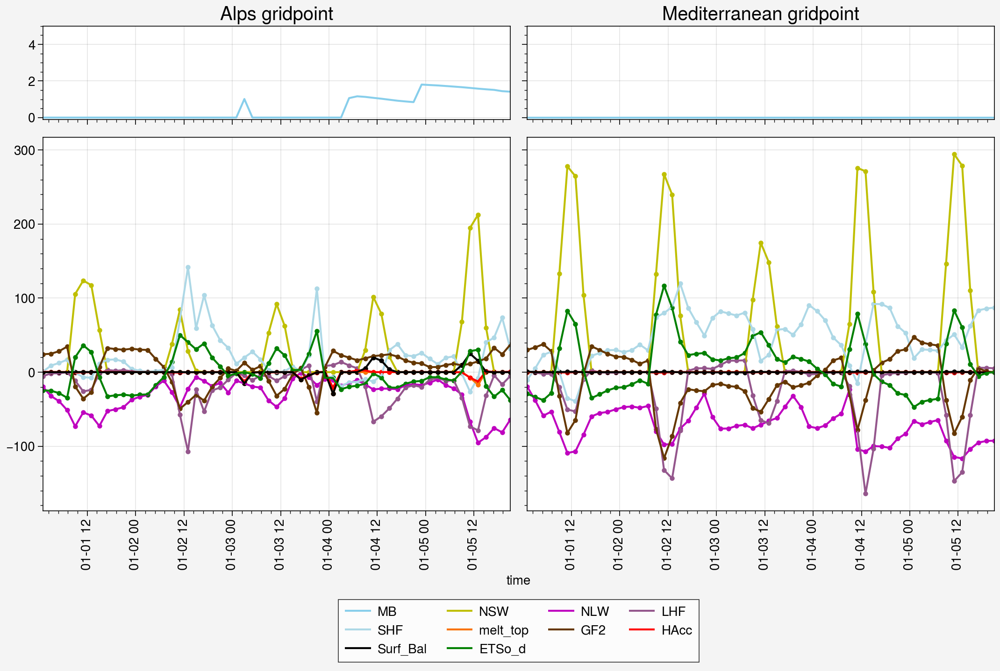

In [34]:
f, axs = pplt.subplots(axwidth=5,axheight=4,ncols=2,nrows=2,hratios=(1,4),ref=3)
pplt.rc.update(small=10, large=12)

first=0
last=-1

names_var = ['NSW','NLW','LHF','SHF','melt_top','GF2','HAcc','Surf_Bal','ETSo_d']
colors = ['y','m','purple','lightblue','orange','brown','r','k','green']

#ax=axs[2]
#ax.scatter(ds_e02_GF.time[first:last], np.array(ds_e02_GF)[first:last,i1,j1], c='pink', s=10)
#ax.plot(ds_e02_GF.time[first:last], np.array(ds_e02_GF)[first:last,i1,j1], c='pink')
    
#ax=axs[3]
#ax.scatter(ds_e02_GF.time[first:last], np.array(ds_e02_GF)[first:last,i2,j2], c='pink', s=10)
#ax.plot(ds_e02_GF.time[first:last], np.array(ds_e02_GF)[first:last,i2,j2], c='pink', label='GF')

for i,var in enumerate(names_var):
    ax=axs[2]
    ax.scatter(ds_e02.time[first:last], np.array(ds_e02[var])[first:last,i1,j1], c=colors[i], s=10)
    ax.plot(ds_e02.time[first:last], np.array(ds_e02[var])[first:last,i1,j1], c=colors[i])
    
    ax=axs[3]
    ax.scatter(ds_e02.time[first:last], np.array(ds_e02[var])[first:last,i2,j2], c=colors[i], s=10)
    ax.plot(ds_e02.time[first:last], np.array(ds_e02[var])[first:last,i2,j2], c=colors[i], label=var)

#ax.set_ylim([-300,600])

ax0 = axs[0]
ax0.plot(ds_e02.time[first:last], np.array(ds_e02.MB.max(axis=1))[first:last,i1,j1], c='skyblue')
ax0.set_ylim([-0.1,5])
axs[0].format(titlesize='20px',title='Alps gridpoint')

ax0 = axs[1]
ax0.plot(ds_e02.time[first:last], np.array(ds_e02.MB.max(axis=1))[first:last,i2,j2], c='skyblue', label='MB')
ax0.set_ylim([-0.1,5])
axs[1].format(titlesize='20px',title='Mediterranean gridpoint')

f.legend(loc='b',prop = { "size": 10 },ncols=4)

#### e09

In [14]:
ds_e09 = open_monthly_data(month='01',days_in_month='05',sim='e09',day_average=False,HAcc_col=True,timestep_in_hours = 2)

/tmp/ipykernel_1699481/3918087862.py:2: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_1699481/3918087862.py:2: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


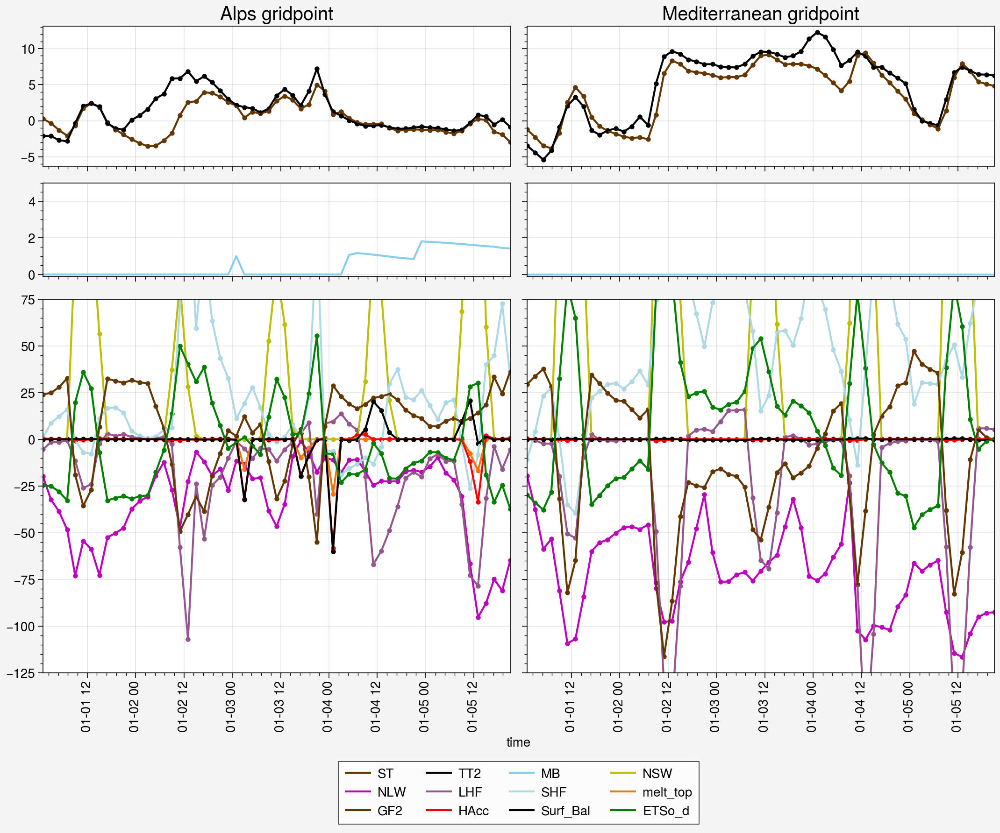

In [36]:
f, axs = pplt.subplots(axwidth=5,axheight=4,ncols=2,nrows=3,hratios=(1.5,1,4),ref=5)
pplt.rc.update(small=10, large=12)

first=0
last=-1

names_var = ['ST','TT2','NSW','NLW','LHF','SHF','melt_top','GF2','HAcc','Surf_Bal','ETSo_d']
colors = ['brown','k','y','m','purple','lightblue','orange','brown','r','k','green']


for i,var in enumerate(names_var):
    ax=axs[4]
    if(var=='TT2' or var=='ST'): ax = axs[0]
    ax.scatter(ds_e09.time[first:last], np.array(ds_e09[var])[first:last,i1,j1], c=colors[i], s=10)
    ax.plot(ds_e09.time[first:last], np.array(ds_e09[var])[first:last,i1,j1], c=colors[i])
    
    ax=axs[5]
    if(var=='TT2' or var=='ST'): ax = axs[1]
    ax.scatter(ds_e09.time[first:last], np.array(ds_e09[var])[first:last,i2,j2], c=colors[i], s=10)
    ax.plot(ds_e09.time[first:last], np.array(ds_e09[var])[first:last,i2,j2], c=colors[i], label=var)

ax.set_ylim([-125,75])

ax0 = axs[2]
ax0.plot(ds_e09.time[first:last], np.array(ds_e09.MB.max(axis=1))[first:last,i1,j1], c='skyblue')
ax0.set_ylim([-0.1,5])
axs[0].format(titlesize='20px',title='Alps gridpoint')

ax0 = axs[3]
ax0.plot(ds_e09.time[first:last], np.array(ds_e09.MB.max(axis=1))[first:last,i2,j2], c='skyblue', label='MB')
ax0.set_ylim([-0.1,5])
axs[1].format(titlesize='20px',title='Mediterranean gridpoint')

f.legend(loc='b',prop = { "size": 10 },ncols=4)

In [16]:
ds_e09 = open_monthly_data2(month='01',days_in_month='05',sim='e09',day_average=False,HAcc_col=True,timestep_in_hours = 2)

In [17]:
i1 = 75 # y
j1 = 90 # x

i2 = 25
j2 = 55

/tmp/ipykernel_1699481/2329804033.py:2: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_1699481/2329804033.py:2: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


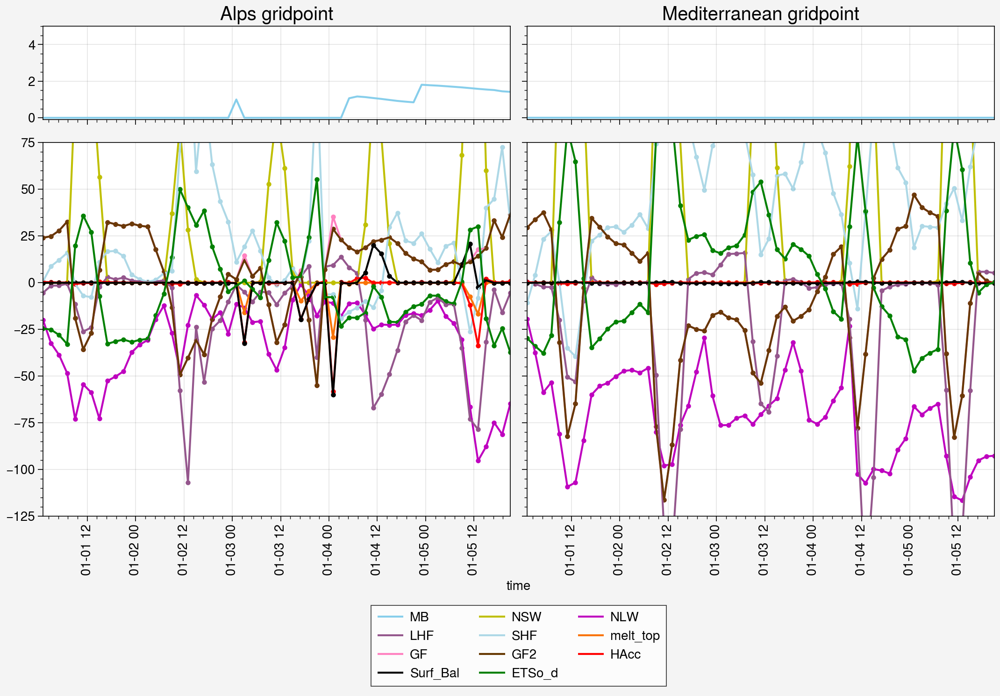

In [38]:
f, axs = pplt.subplots(axwidth=5,axheight=4,ncols=2,nrows=2,hratios=(1,4),ref=3)
pplt.rc.update(small=10, large=12)

first=0
last=-1

names_var = ['NSW','NLW','LHF','SHF','melt_top','GF','GF2','HAcc','Surf_Bal','ETSo_d']
colors = ['y','m','purple','lightblue','orange','pink','brown','r','k','green']



for i,var in enumerate(names_var):
    ax=axs[2]
    ax.scatter(ds_e09.time[first:last], np.array(ds_e09[var])[first:last,i1,j1], c=colors[i], s=10)
    ax.plot(ds_e09.time[first:last], np.array(ds_e09[var])[first:last,i1,j1], c=colors[i])
    
    ax=axs[3]
    ax.scatter(ds_e09.time[first:last], np.array(ds_e09[var])[first:last,i2,j2], c=colors[i], s=10)
    ax.plot(ds_e09.time[first:last], np.array(ds_e09[var])[first:last,i2,j2], c=colors[i], label=var)

ax.set_ylim([-125,75])

ax0 = axs[0]
ax0.plot(ds_e09.time[first:last], np.array(ds_e09.MB.max(axis=1))[first:last,i1,j1], c='skyblue')
ax0.set_ylim([-0.1,5])
axs[0].format(titlesize='20px',title='Alps gridpoint')

ax0 = axs[1]
ax0.plot(ds_e09.time[first:last], np.array(ds_e09.MB.max(axis=1))[first:last,i2,j2], c='skyblue', label='MB')
ax0.set_ylim([-0.1,5])
axs[1].format(titlesize='20px',title='Mediterranean gridpoint')

f.legend(loc='b')#,prop = { "size": 14 },ncols=4)

In [39]:
arr_e09_totMB = np.array(ds_e09.MB.max(axis=1).sum(axis=0))
i1, j1 = np.where(arr_e09_totMB==arr_e09_totMB.max())
i1,j1

(array([70]), array([108]))

In [40]:
i2, j2 = np.where(arr_e09_totMB>=700)[0][5], np.where(arr_e09_totMB>=700)[1][5]
i2,j2

(45, 35)

In [53]:
arr_e09_totfreeze = np.array(ds_e09.freeze.sum(axis=0))
i1, j1 = np.where(arr_e09_totfreeze==arr_e09_totfreeze.max())
i1,j1

(array([68]), array([104]))

In [54]:
i2, j2 = np.where(arr_e09_totfreeze>=350)[0][5], np.where(arr_e09_totfreeze>=350)[1][5]
i2,j2

(67, 78)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

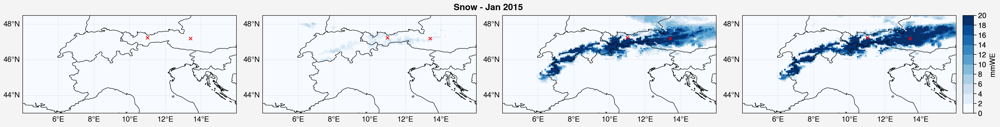

In [55]:
f, axs = pplt.subplots(proj='cyl',axwidth=4,ncols=4)

for t in range(4):
    m = axs[t].pcolormesh(lon,lat,ds_e09.MB.max(axis=1)[18*t+3],levels=np.linspace(0,20,11),cmap='Blues')
    axs[t].plot(lon[i1,j1], lat[i1,j1],'rx',markersize=4)
    axs[t].plot(lon[i2,j2], lat[i2,j2],'rx',markersize=4)

axs.format(titlesize='20px')

f.colorbar(m, label= 'mmWE')

axs.format(**normal_format,suptitle="Snow - Jan 2015 ")
#axs.format(**big_format,suptitle="Snow - Jan 2015 ")

/tmp/ipykernel_1699481/3335881063.py:2: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_1699481/3335881063.py:2: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


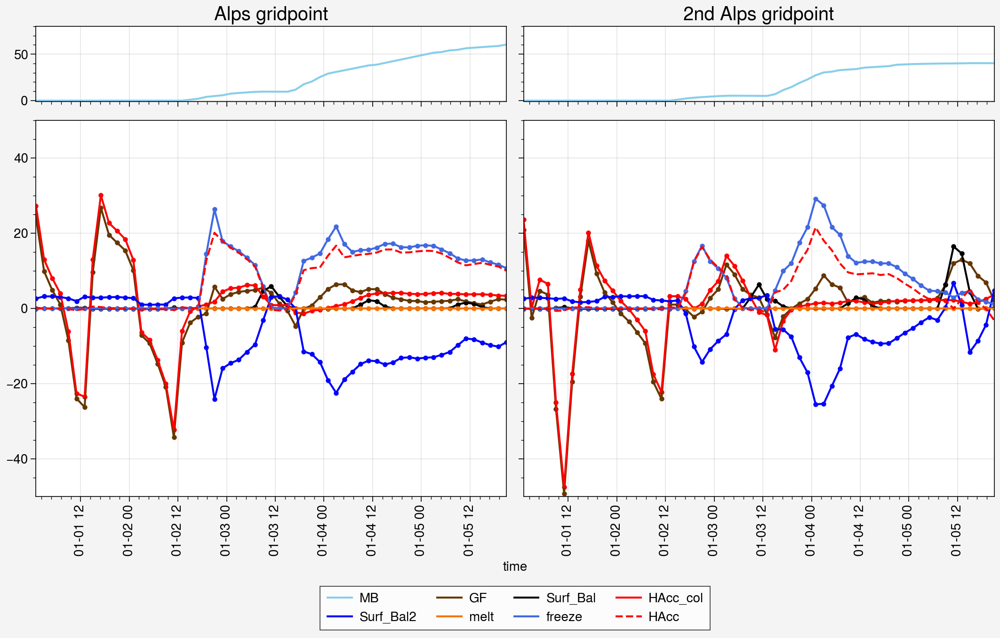

In [62]:
f, axs = pplt.subplots(axwidth=5,axheight=4,ncols=2,nrows=2,hratios=(1,5),ref=3)
pplt.rc.update(small=10, large=12)

first=0
last=-1

names_var = ['GF','Surf_Bal','HAcc_col','Surf_Bal2','melt','freeze']
colors = ['brown','k','red','blue','orange','royalblue']

ds_day_surf_balance = ds_e09.NSW + ds_e09.NLW + ds_e09.SHF + ds_e09.LHF + ds_e09.melt_top + ds_e09.HAcc_col
ds_e09['Surf_Bal2'] = ds_day_surf_balance

for i,var in enumerate(names_var):
    ax=axs[2]
    ax.scatter(ds_e09.time[first:last], np.array(ds_e09[var])[first:last,i1,j1], c=colors[i], s=10)
    ax.plot(ds_e09.time[first:last], np.array(ds_e09[var])[first:last,i1,j1], c=colors[i])
    
    ax=axs[3]
    ax.scatter(ds_e09.time[first:last], np.array(ds_e09[var])[first:last,i2,j2], c=colors[i], s=10)
    ax.plot(ds_e09.time[first:last], np.array(ds_e09[var])[first:last,i2,j2], c=colors[i], label=var)

ax=axs[2]
#ax.scatter(ds_e09.time[first:last], np.array(ds_e09['HAcc'])[first:last,i1,j1], c='r', s=10)
ax.plot(ds_e09.time[first:last], np.array(ds_e09['HAcc'])[first:last,i1,j1], '--r')

ax=axs[3]
#ax.scatter(ds_e09.time[first:last], np.array(ds_e09['HAcc'])[first:last,i2,j2], c='r', s=10)
ax.plot(ds_e09.time[first:last], np.array(ds_e09['HAcc'])[first:last,i2,j2], '--r', label='HAcc')

ax.set_ylim([-50,50])

# ----------------------------------------------------------------------------------------------------------------------------------------------------------

# ds_day_surf_balance = ds_e09.NSW + ds_e09.NLW + ds_e09.SHF + ds_e09.LHF + ds_e09.melt + ds_e09.HAcc_col + ds_e09.freeze
# ds_e09['Surf_Bal2'] = ds_day_surf_balance

# for i,var in enumerate(names_var):
#     ax=axs[4]
#     ax.scatter(ds_e09.time[first:last], np.array(ds_e09[var])[first:last,i1,j1], c=colors[i], s=10)
#     ax.plot(ds_e09.time[first:last], np.array(ds_e09[var])[first:last,i1,j1], c=colors[i])
    
#     ax=axs[5]
#     ax.scatter(ds_e09.time[first:last], np.array(ds_e09[var])[first:last,i2,j2], c=colors[i], s=10)
#     ax.plot(ds_e09.time[first:last], np.array(ds_e09[var])[first:last,i2,j2], c=colors[i])

# ax.set_ylim([-80,80])

# ----------------------------------------------------------------------------------------------------------------------------------------------------------

ax0 = axs[0]
ax0.plot(ds_e09.time[first:last], np.array(ds_e09.MB.max(axis=1))[first:last,i1,j1], c='skyblue')
ax0.set_ylim([-1,80])
axs[0].format(titlesize='20px',title='Alps gridpoint')

ax0 = axs[1]
ax0.plot(ds_e09.time[first:last], np.array(ds_e09.MB.max(axis=1))[first:last,i2,j2], c='skyblue', label='MB')
ax0.set_ylim([-1,80])
axs[1].format(titlesize='20px',title='2nd Alps gridpoint')

f.legend(loc='b',prop = { "size": 10 },ncols=4)

In [48]:
arr_e09_totmelt = np.array(ds_e09.melt.sum(axis=0))
i1, j1 = np.where(arr_e09_totmelt==arr_e09_totmelt.min())
i1,j1

(array([58]), array([55]))

In [49]:
i2, j2 = np.where(arr_e09_totmelt<=-350)[0][5], np.where(arr_e09_totmelt<=-350)[1][5]
i2,j2

(68, 72)

/tmp/ipykernel_1699481/1489173632.py:2: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_1699481/1489173632.py:2: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


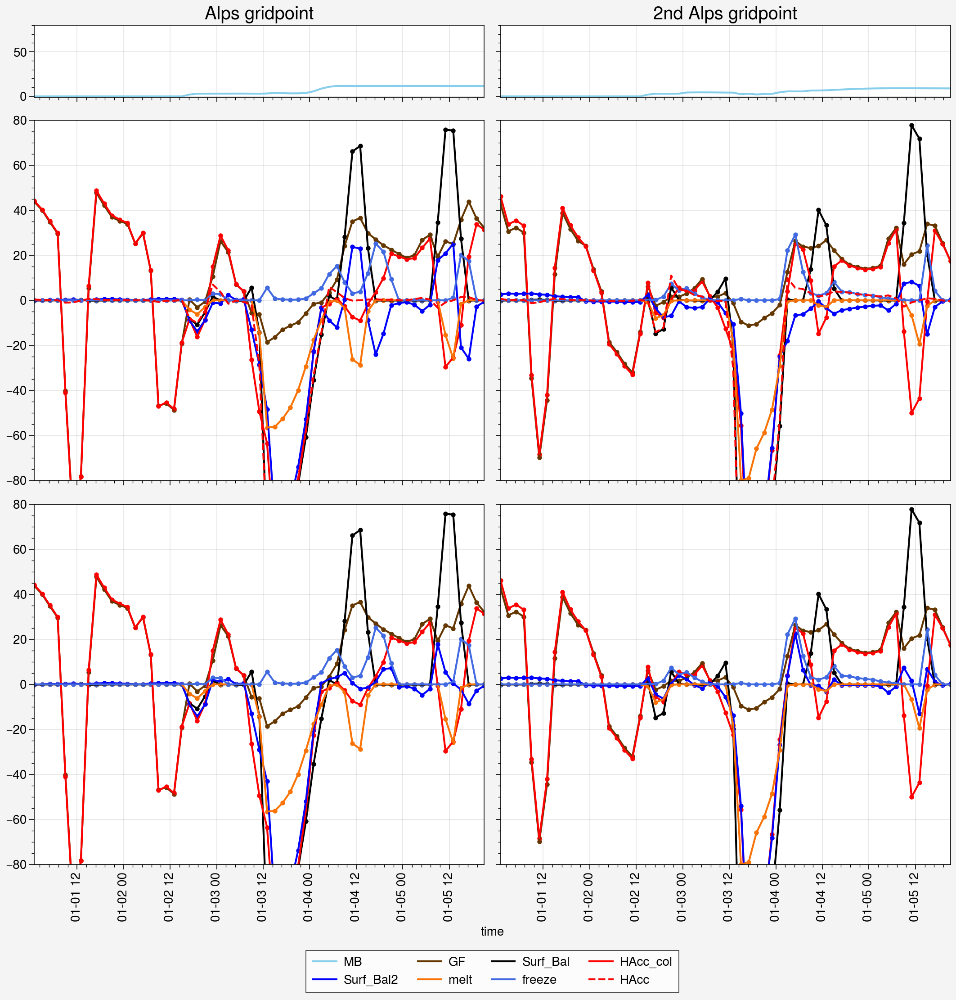

In [50]:
f, axs = pplt.subplots(axwidth=5,axheight=4,ncols=2,nrows=3,hratios=(1,5,5),ref=3)
pplt.rc.update(small=10, large=12)

first=0
last=-1

names_var = ['GF','Surf_Bal','HAcc_col','Surf_Bal2','melt','freeze']
colors = ['brown','k','red','blue','orange','royalblue']

ds_day_surf_balance = ds_e09.NSW + ds_e09.NLW + ds_e09.SHF + ds_e09.LHF + ds_e09.melt_top + ds_e09.HAcc_col
ds_e09['Surf_Bal2'] = ds_day_surf_balance

for i,var in enumerate(names_var):
    ax=axs[2]
    ax.scatter(ds_e09.time[first:last], np.array(ds_e09[var])[first:last,i1,j1], c=colors[i], s=10)
    ax.plot(ds_e09.time[first:last], np.array(ds_e09[var])[first:last,i1,j1], c=colors[i])
    
    ax=axs[3]
    ax.scatter(ds_e09.time[first:last], np.array(ds_e09[var])[first:last,i2,j2], c=colors[i], s=10)
    ax.plot(ds_e09.time[first:last], np.array(ds_e09[var])[first:last,i2,j2], c=colors[i], label=var)

ax=axs[2]
#ax.scatter(ds_e09.time[first:last], np.array(ds_e09['HAcc'])[first:last,i1,j1], c='r', s=10)
ax.plot(ds_e09.time[first:last], np.array(ds_e09['HAcc'])[first:last,i1,j1], '--r')

ax=axs[3]
#ax.scatter(ds_e09.time[first:last], np.array(ds_e09['HAcc'])[first:last,i2,j2], c='r', s=10)
ax.plot(ds_e09.time[first:last], np.array(ds_e09['HAcc'])[first:last,i2,j2], '--r', label='HAcc')

ax.set_ylim([-80,80])

# ----------------------------------------------------------------------------------------------------------------------------------------------------------

ds_day_surf_balance = ds_e09.NSW + ds_e09.NLW + ds_e09.SHF + ds_e09.LHF + ds_e09.melt + ds_e09.HAcc_col + ds_e09.freeze
ds_e09['Surf_Bal2'] = ds_day_surf_balance

for i,var in enumerate(names_var):
    ax=axs[4]
    ax.scatter(ds_e09.time[first:last], np.array(ds_e09[var])[first:last,i1,j1], c=colors[i], s=10)
    ax.plot(ds_e09.time[first:last], np.array(ds_e09[var])[first:last,i1,j1], c=colors[i])
    
    ax=axs[5]
    ax.scatter(ds_e09.time[first:last], np.array(ds_e09[var])[first:last,i2,j2], c=colors[i], s=10)
    ax.plot(ds_e09.time[first:last], np.array(ds_e09[var])[first:last,i2,j2], c=colors[i])

ax.set_ylim([-80,80])

# ----------------------------------------------------------------------------------------------------------------------------------------------------------

ax0 = axs[0]
ax0.plot(ds_e09.time[first:last], np.array(ds_e09.MB.max(axis=1))[first:last,i1,j1], c='skyblue')
ax0.set_ylim([-1,80])
axs[0].format(titlesize='20px',title='Alps gridpoint')

ax0 = axs[1]
ax0.plot(ds_e09.time[first:last], np.array(ds_e09.MB.max(axis=1))[first:last,i2,j2], c='skyblue', label='MB')
ax0.set_ylim([-1,80])
axs[1].format(titlesize='20px',title='2nd Alps gridpoint')

f.legend(loc='b',prop = { "size": 10 },ncols=4)

#### e10 : mosaic by mosaic

In [42]:
ds_e10_k = open_monthly_data_k(month='01',days_in_month='05',sim='e10',day_average=False,HA_col=True,timestep_in_hours = 2)

In [43]:
ds_e10_k

<xarray.Dataset>
Dimensions:      (time: 60, sector: 3, y: 91, x: 139, ztqlev: 3)
Coordinates:
  * time         (time) datetime64[ns] 2015-01-01T01:00:00 ... 2015-01-05T23:...
  * x            (x) float32 -259.0 -252.0 -245.0 -238.0 ... 693.0 700.0 707.0
  * y            (y) float32 -168.0 -161.0 -154.0 -147.0 ... 448.0 455.0 462.0
  * sector       (sector) float32 1.0 2.0 3.0
  * ztqlev       (ztqlev) float32 2.0 10.0 100.0
Data variables: (12/30)
    GFk          (time, sector, y, x) float32 ...
    SWUk         (time, sector, y, x) float32 ...
    SWD          (time, y, x) float32 ...
    HAcck        (time, sector, y, x) float32 ...
    LWUk         (time, sector, y, x) float32 ...
    LWD          (time, y, x) float32 ...
    ...           ...
    meltk        (time, sector, y, x) float32 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0
    freezek      (time, sector, y, x) float32 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0
    melt_topk    (time, sector, y, x) float32 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0
    freeze_topk  (time, sector, y, x) float32 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0
    TT2          (time, y, x) float32 ...
    Surf_Balk    (time, y, x, sector) float32 1.035 261.1 ... 267.6 -0.1413
Attributes:
    title:        ICE - Exp: e10 - 20150101
    institution:  ULg (Xavier Fettweis)
    history:      libUN (2005.04.08) - Fri Apr 18 18:30:31 2025
    netcdf:       4.8.0 of May  2 2023 12:43:48 $

/tmp/ipykernel_3312678/4205150843.py:2: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_3312678/4205150843.py:2: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


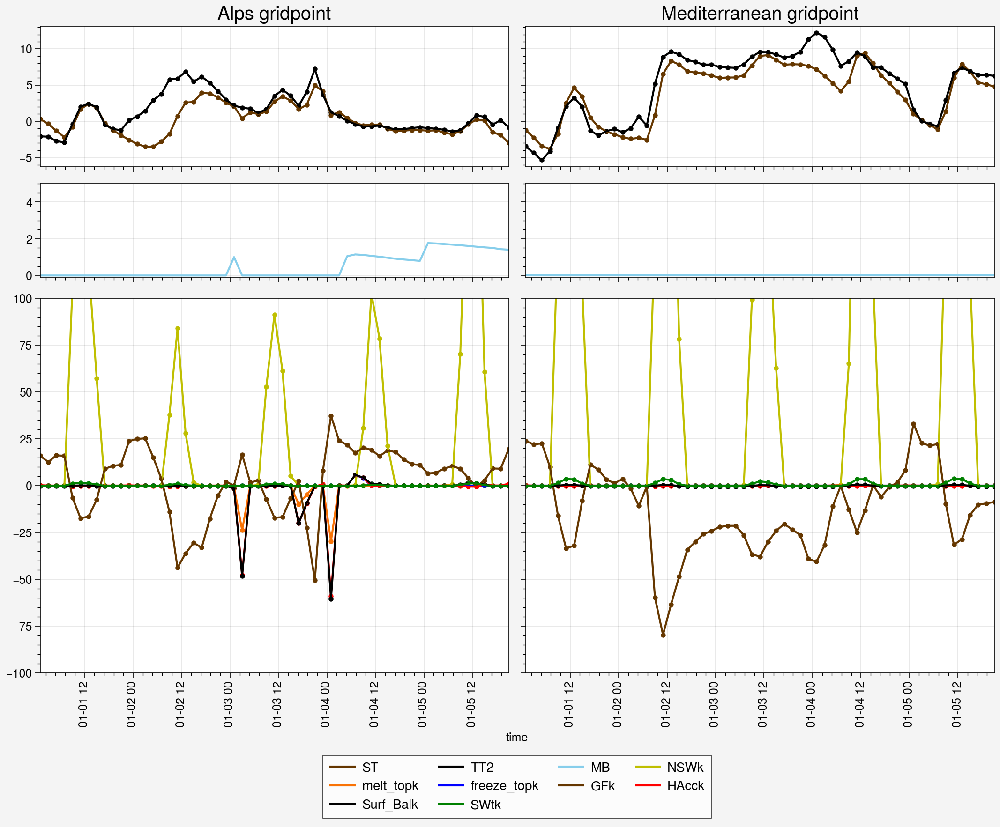

In [16]:
f, axs = pplt.subplots(axwidth=5,axheight=4,ncols=2,nrows=3,hratios=(1.5,1,4),ref=5)
pplt.rc.update(small=10, large=12)

first=0
last=-1

names_var = ['ST','TT2','NSWk','melt_topk','freeze_topk','GFk','HAcck','Surf_Balk','SWtk']
colors = ['brown','k','y','orange','blue','brown','r','k','green']

ds_var = ds_e10_k.sel(sector="1.0")

for i,var in enumerate(names_var):
    ax=axs[4]
    if(var=='TT2' or var=='ST'): ax = axs[0]
    ax.scatter(ds_var.time[first:last], np.array(ds_var[var])[first:last,i1,j1], c=colors[i], s=10)
    ax.plot(ds_var.time[first:last], np.array(ds_var[var])[first:last,i1,j1], c=colors[i])
    
    ax=axs[5]
    if(var=='TT2' or var=='ST'): ax = axs[1]
    ax.scatter(ds_var.time[first:last], np.array(ds_var[var])[first:last,i2,j2], c=colors[i], s=10)
    ax.plot(ds_var.time[first:last], np.array(ds_var[var])[first:last,i2,j2], c=colors[i], label=var)

ax.set_ylim([-100,100])

ax0 = axs[2]
ax0.plot(ds_var.time[first:last], np.array(ds_var.MB)[first:last,i1,j1], c='skyblue')
ax0.set_ylim([-0.1,5])
axs[0].format(titlesize='20px',title='Alps gridpoint')

ax0 = axs[3]
ax0.plot(ds_var.time[first:last], np.array(ds_var.MB)[first:last,i2,j2], c='skyblue', label='MB')
ax0.set_ylim([-0.1,5])
axs[1].format(titlesize='20px',title='Mediterranean gridpoint')

f.legend(loc='b',prop = { "size": 10 },ncols=4)

/tmp/ipykernel_3312678/2721409502.py:2: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_3312678/2721409502.py:2: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


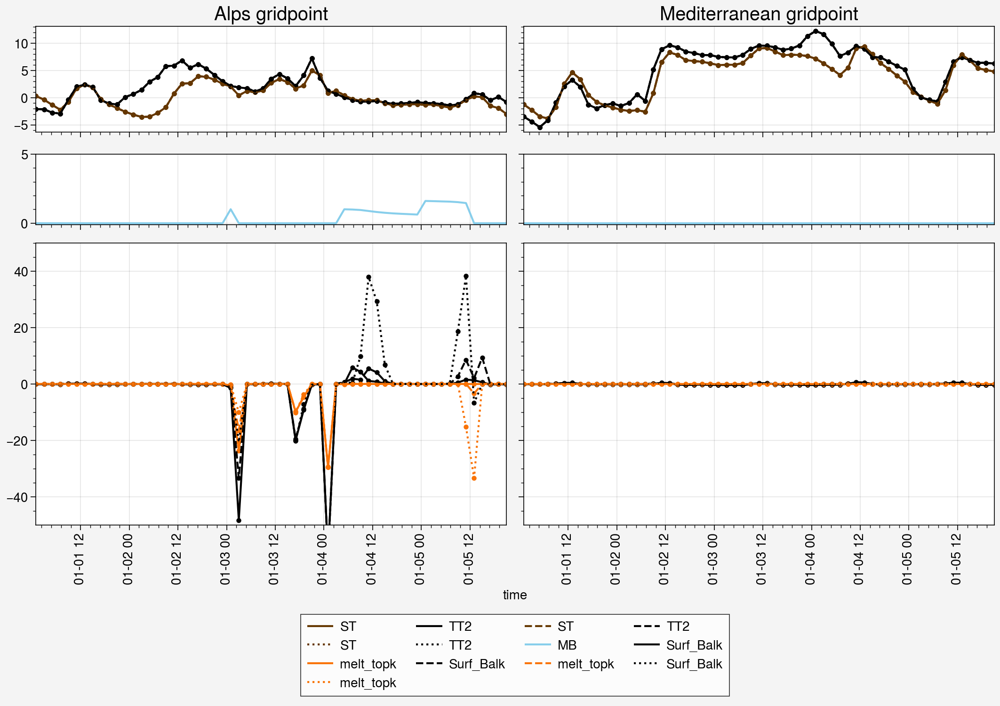

In [17]:
f, axs = pplt.subplots(axwidth=5,axheight=3,ncols=2,nrows=3,hratios=(1.5,1,4),ref=5)
pplt.rc.update(small=10, large=12)

first=0
last=-1

names_var = ['ST','TT2','Surf_Balk','melt_topk']#,'freeze_topk']
colors = ['brown','k','k','orange']#,'blue']
linestyles = ['-','--',':']


for sect in range(3):
    ds_var = ds_e10_k.isel(sector=sect)
    linestyle_k = linestyles[sect]
    for i,var in enumerate(names_var):
        ax=axs[4]
        if(var=='TT2' or var=='ST'): ax = axs[0]
        ax.scatter(ds_var.time[first:last], np.array(ds_var[var])[first:last,i1,j1], c=colors[i], s=10)
        ax.plot(ds_var.time[first:last], np.array(ds_var[var])[first:last,i1,j1], c=colors[i],linestyle=linestyle_k)
        
        ax=axs[5]
        if(var=='TT2' or var=='ST'): ax = axs[1]
        ax.scatter(ds_var.time[first:last], np.array(ds_var[var])[first:last,i2,j2], c=colors[i], s=10)
        ax.plot(ds_var.time[first:last], np.array(ds_var[var])[first:last,i2,j2], c=colors[i], label=var,linestyle=linestyle_k)

ax.set_ylim([-50,50])

ax0 = axs[2]
ax0.plot(ds_var.time[first:last], np.array(ds_var.MB)[first:last,i1,j1], c='skyblue')
ax0.set_ylim([-0.1,5])
axs[0].format(titlesize='20px',title='Alps gridpoint')

ax0 = axs[3]
ax0.plot(ds_var.time[first:last], np.array(ds_var.MB)[first:last,i2,j2], c='skyblue', label='MB')
ax0.set_ylim([-0.1,5])
axs[1].format(titlesize='20px',title='Mediterranean gridpoint')

f.legend(loc='b',prop = { "size": 10 },ncols=4)

In [21]:
print(veg_mar[int(ds_e10_k.VEG[:,i1,j1])])

TypeError: only length-1 arrays can be converted to Python scalars

In [19]:
ds_e10 = open_monthly_data_ave(month='01',days_in_month='05',sim='e10',day_average=False,HA_col=True,timestep_in_hours = 2)

In [24]:
np.array(ds_e10_k.VEG[:,i1,j1])

array([9., 7., 1.], dtype=float32)

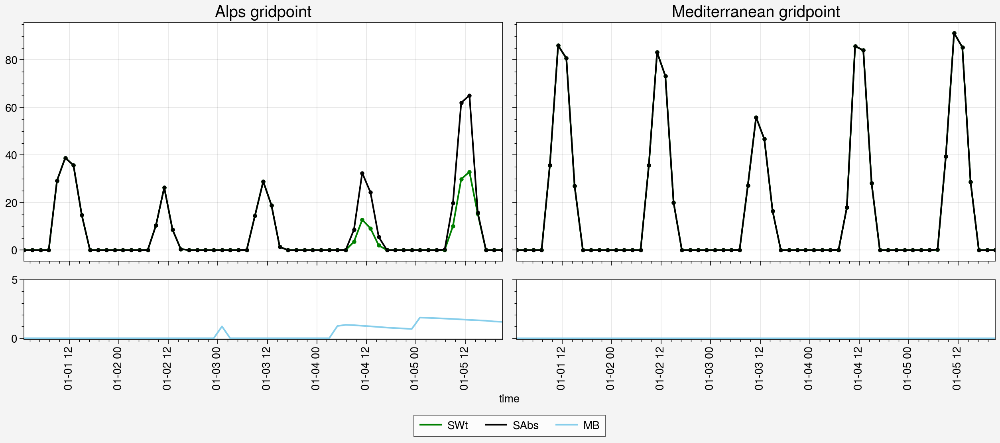

In [20]:
f, axs = pplt.subplots(axwidth = 6,axheight=3,ncols=2,nrows=2,hratios=(4,1),ref=1)

ds_var = ds_e10

names_var = ['SWt','SAbs']
colors = ['green','k']

for i,var in enumerate(names_var):
    axs[0].scatter(ds_var.time[first:last], np.array(ds_var[var])[first:last,i1,j1], c=colors[i], s=10)
    axs[0].plot(ds_var.time[first:last], np.array(ds_var[var])[first:last,i1,j1], c=colors[i])
    
    axs[1].scatter(ds_var.time[first:last], np.array(ds_var[var])[first:last,i2,j2], c=colors[i], s=10)
    axs[1].plot(ds_var.time[first:last], np.array(ds_var[var])[first:last,i2,j2], c=colors[i],label=var)

ax0 = axs[2]
ax0.plot(ds_var.time[first:last], np.array(ds_var.MB.max(axis=1))[first:last,i1,j1], c='skyblue')
ax0.set_ylim([-0.1,5])
axs[0].format(titlesize='20px',title='Alps gridpoint')

ax0 = axs[3]
ax0.plot(ds_var.time[first:last], np.array(ds_var.MB.max(axis=1))[first:last,i2,j2], c='skyblue', label='MB')
ax0.set_ylim([-0.1,5])
axs[1].format(titlesize='20px',title='Mediterranean gridpoint')
#ax.format(suptitle=veg_mar[int(ds_var.VEG[i1,j1])])
f.legend(loc='b',prop = { "size": 10 },ncols=4)

#### e11 (mosaic also)

In [15]:
ds_e11_k = open_monthly_data_k(month='01',days_in_month='05',sim='e11',day_average=False,HA_col=True,timestep_in_hours = 2)
ds_e11_ave = open_monthly_data_ave(month='01',days_in_month='05',sim='e11',day_average=False,HA_col=True,timestep_in_hours = 2)

In [16]:
ds_day = xr.open_dataset('/bettik/castelli/MARout/EUe/e11/2015/ICE.e11.2015.01.01-05.nc')[["ST2"]].isel(x=slice(imin,imax),y=slice(jmin,jmax))
ds_e11_k["ST2"] = ds_day["ST2"]

In [17]:
bare_soil = np.where((np.array(ds_e11_k.VEG.sel(sector="1.0")) == 0) & (np.array(ds_e11_k.melt_topk.sel(sector="1.0")).sum(axis=0) != 0))

In [18]:
bare_soil

(array([43, 44, 45, 45, 45, 46, 46, 47, 49, 50, 50, 51, 52, 52, 52, 52, 52,
        53, 53, 53, 54, 54, 55, 55, 55, 56, 56, 56, 56, 56, 56, 57, 58, 58,
        58, 58, 58, 59, 59, 59, 59, 59, 60, 61, 62, 63, 63, 64, 65, 65, 65,
        65, 69, 70, 70, 71]),
 array([ 32,  35,  40,  41,  45,  36,  45,  46,  45,  75,  78,  64,  40,
         44,  66,  67,  88,  42,  43,  46,  48,  51,  51,  64,  91,  49,
         51,  56,  64,  90,  92,  51,  50,  52,  54,  55,  93,  51,  52,
         54,  56,  78,  69,  60,  80,  82,  97,  88,  89,  90,  99, 104,
         78,  78,  83, 100]))

In [19]:
i_soil = 44
j_soil = 35

In [20]:
np.array(ds_e11_k.VEG[0,i_soil,j_soil])

array(0., dtype=float32)

In [21]:
np.array(ds_e11_k.MB.sel(sector="1.0")).sum(axis=0)[i_soil,j_soil]

531.8089

In [22]:
print(i_soil + jmin)
print(j_soil + imin)

64
67


/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "


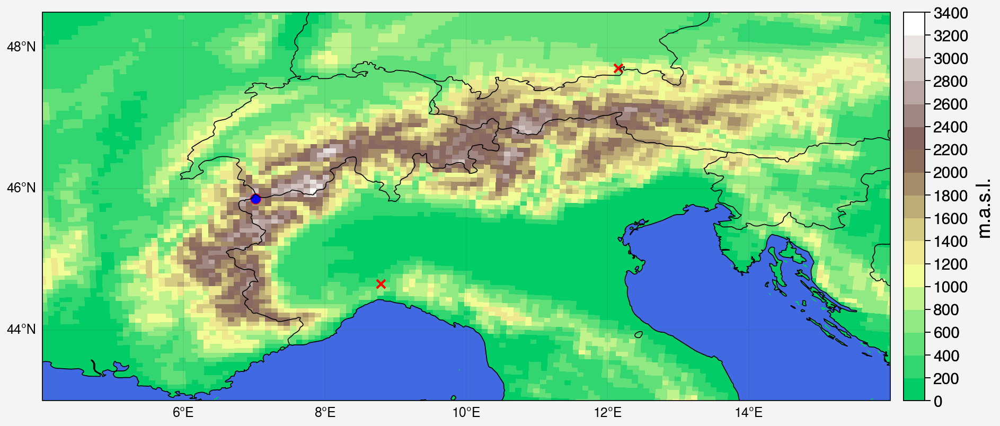

In [26]:
colors_land = plt.cm.terrain(np.linspace(0.25, 1, 256))
f, ax = pplt.subplots(proj='cyl', axwidth=8)
m=ax.pcolormesh(ds.LON, ds.LAT, ds.SH, levels=17,cmap=colors_land)
f.colorbar(m,label= 'm.a.s.l.',labelsize='x-large',ticklabelsize='large')

ax.plot(lon[i1,j1], lat[i1,j1],'rx',markersize=6,markeredgewidth=1.5)
ax.plot(lon[i2,j2], lat[i2,j2],'rx',markersize=6,markeredgewidth=1.5)
ax.plot(lon[i_soil,j_soil], lat[i_soil,j_soil],'ro',markersize=6,markeredgewidth=1.5)
ax.plot(ds.LON[i_soil+jmin,j_soil+imin], ds.LAT[i_soil+jmin,j_soil+imin],'bo',markersize=5,markeredgewidth=1.5)

ax.format(**normal_format)
ax.format(ocean=True,oceancolor='royalblue',reso='hi')

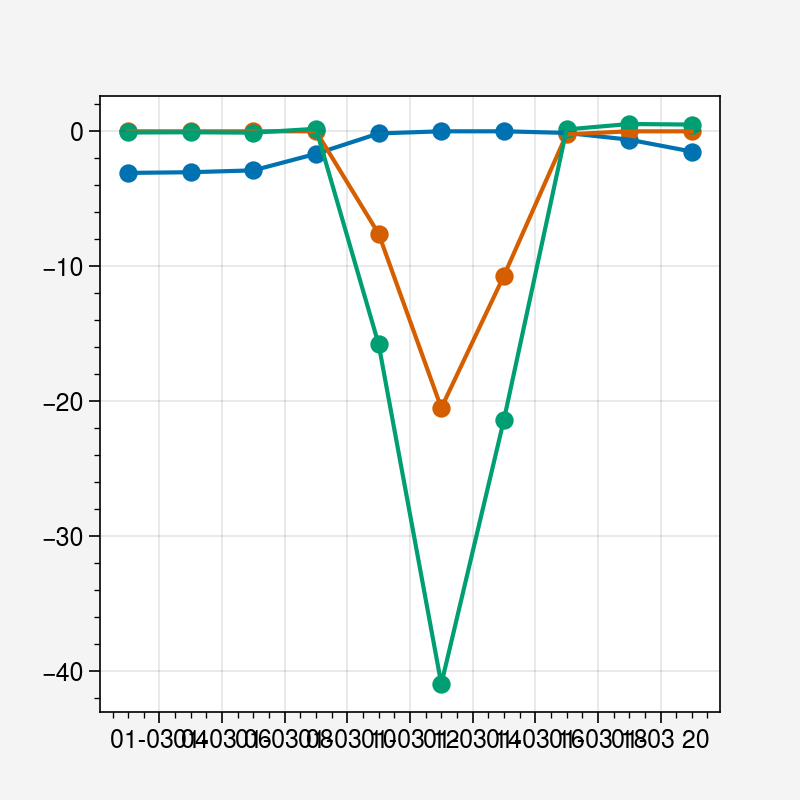

In [27]:
start = 25
end = 35

ds_plo = ds_e11_k

plt.plot(ds_plo.time[start:end],ds_plo['ST2'].sel(sector="1.0")[start:end,i_soil,j_soil])
plt.scatter(ds_plo.time[start:end],ds_plo['ST2'].sel(sector="1.0")[start:end,i_soil,j_soil])
plt.plot(ds_plo.time[start:end],ds_plo['melt_topk'].sel(sector="1.0")[start:end,i_soil,j_soil])
plt.scatter(ds_plo.time[start:end],ds_plo['melt_topk'].sel(sector="1.0")[start:end,i_soil,j_soil])

plt.plot(ds_plo.time[start:end],ds_plo['HAcck'].sel(sector="1.0")[start:end,i_soil,j_soil])
plt.scatter(ds_plo.time[start:end],ds_plo['HAcck'].sel(sector="1.0")[start:end,i_soil,j_soil])
#plt.plot(ds_plo.time,ds_plo['MB'].sel(sector="1.0")[:,i_soil,j_soil])


In [23]:
ds_e11_k['melt_topk'].sel(sector="1.0")[start:end,i_soil,j_soil]

NameError: name 'start' is not defined

In [ ]:
np.array(ds_e11_k['HAcck'].sel(sector="1.0")[start:end,i_soil,j_soil])

In [24]:
2*np.array(ds_e11_k['melt_topk'].sel(sector="1.0")[start:end,i_soil,j_soil])

NameError: name 'start' is not defined

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_225527/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_225527/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


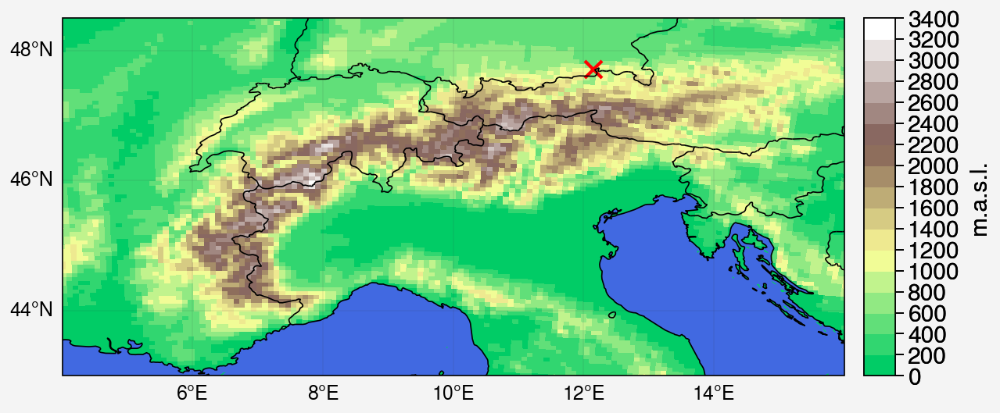

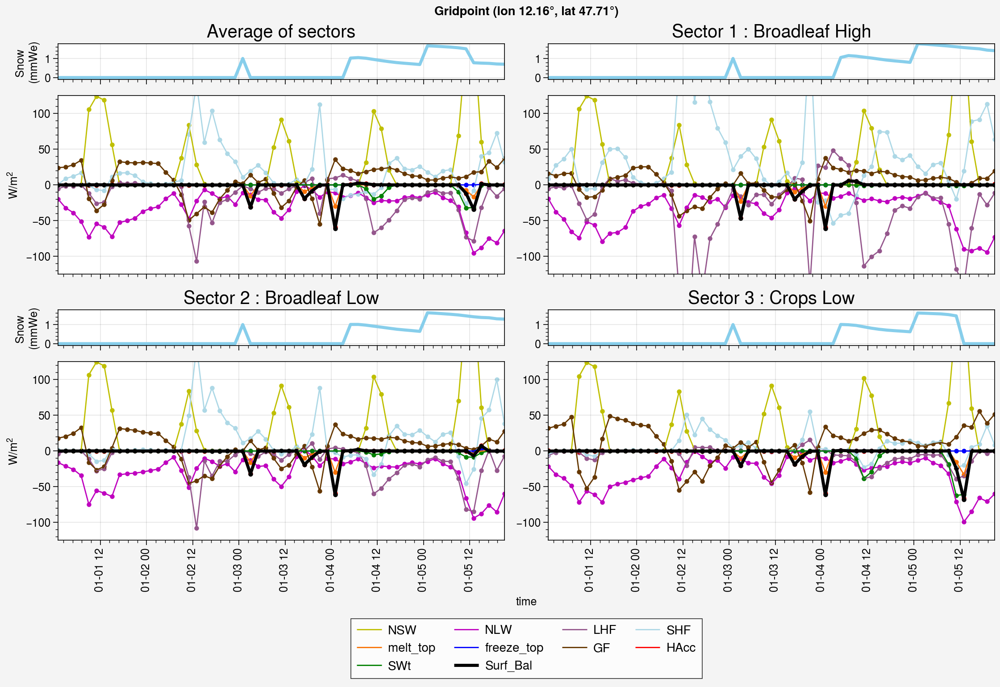

In [25]:
plot_by_mosaic(ds_var = ds_e11_k, ds_var_ave = ds_e11_ave, first=0, last=-1, iloc = i1, jloc = j1, ymin = -125, ymax = 125,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_225527/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_225527/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


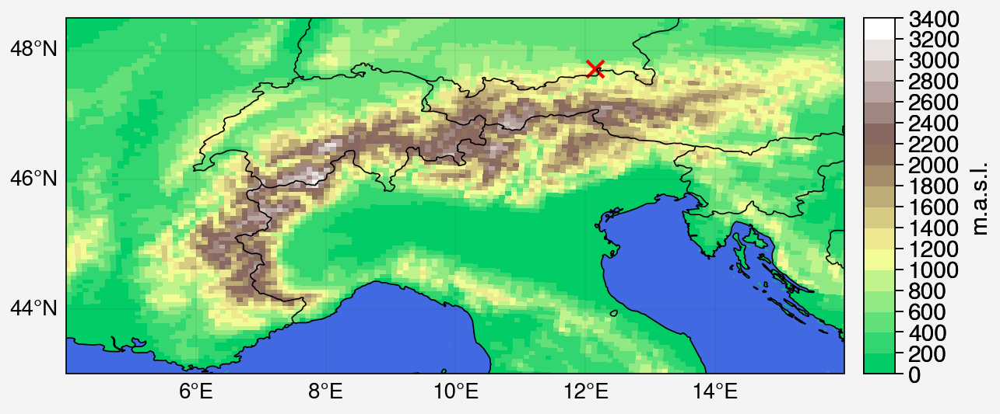

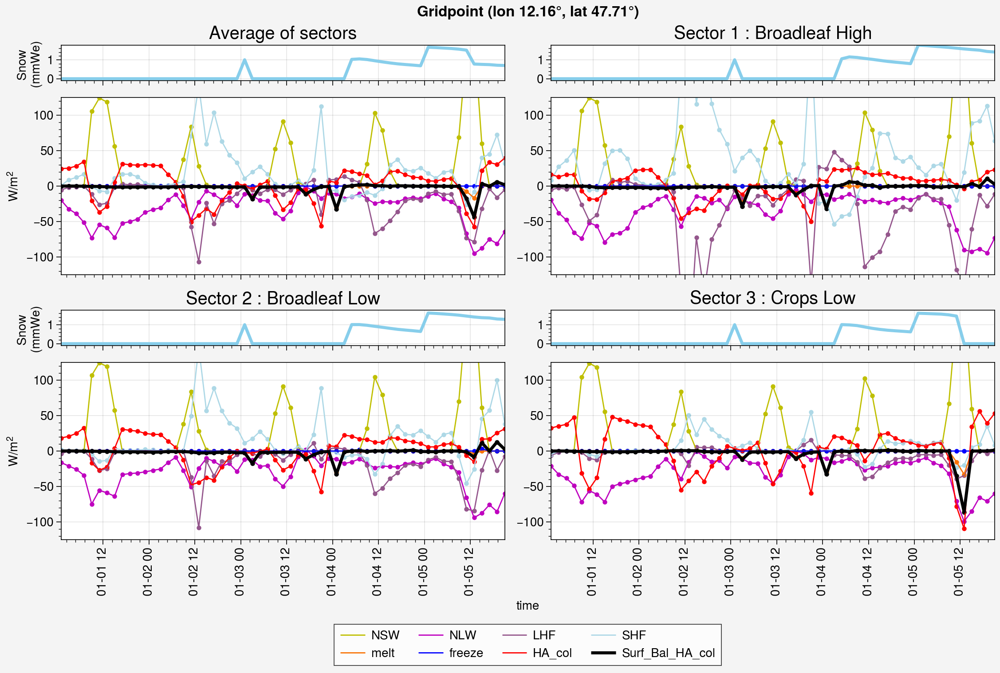

In [26]:
plot_by_mosaic(ds_var = ds_e11_k, ds_var_ave = ds_e11_ave, first=0, last=-1, iloc = i1, jloc = j1, ymin = -125, ymax = 125,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_225527/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_225527/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


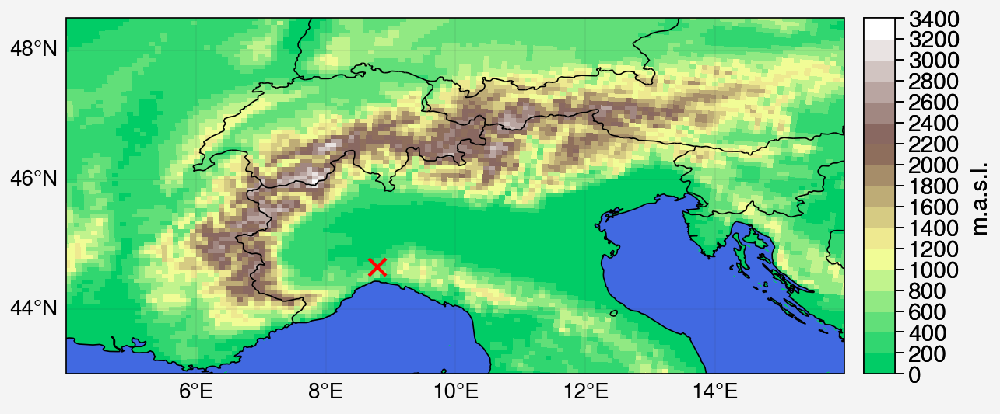

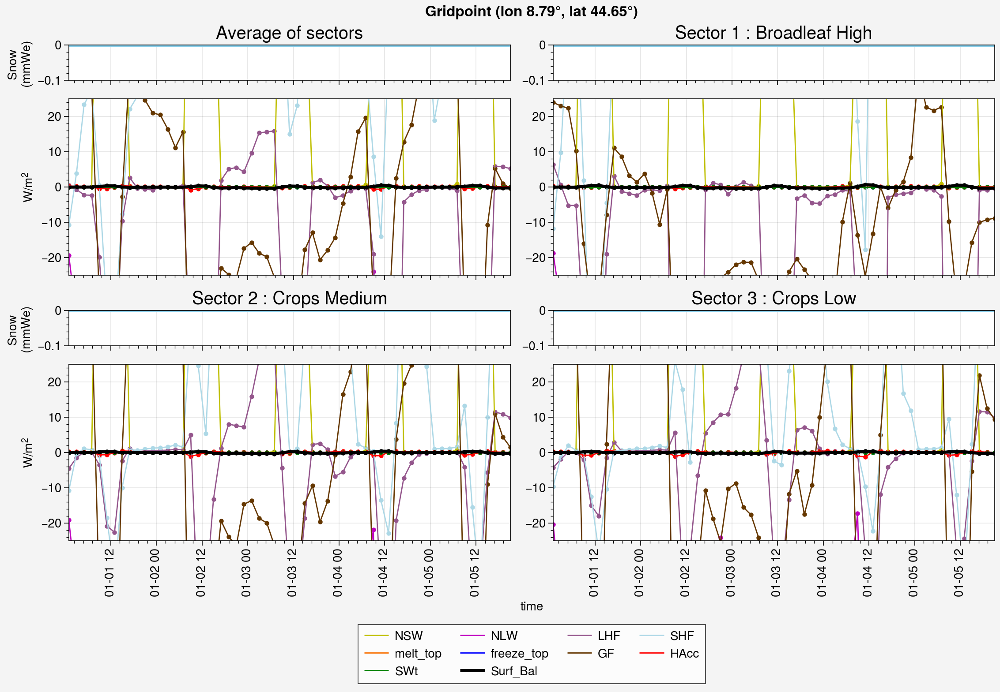

In [27]:
plot_by_mosaic(ds_var = ds_e11_k, ds_var_ave = ds_e11_ave, first=0, last=-1, iloc = i2, jloc = j2, ymin = -25, ymax = 25,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_225527/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_225527/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


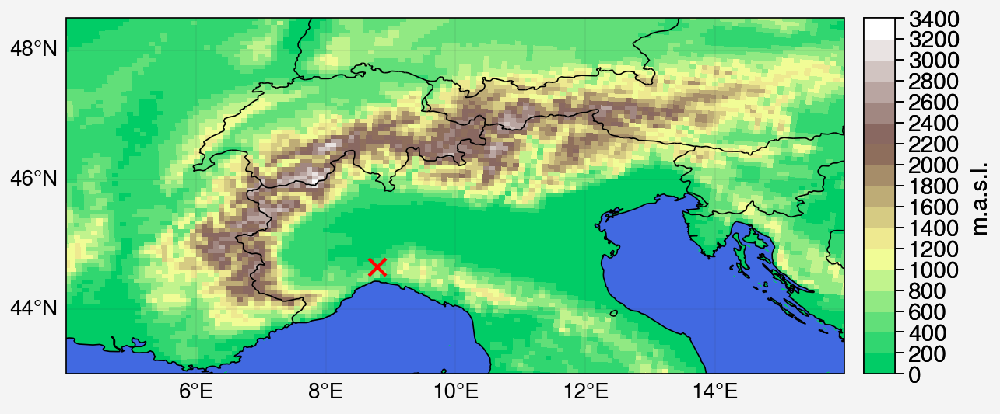

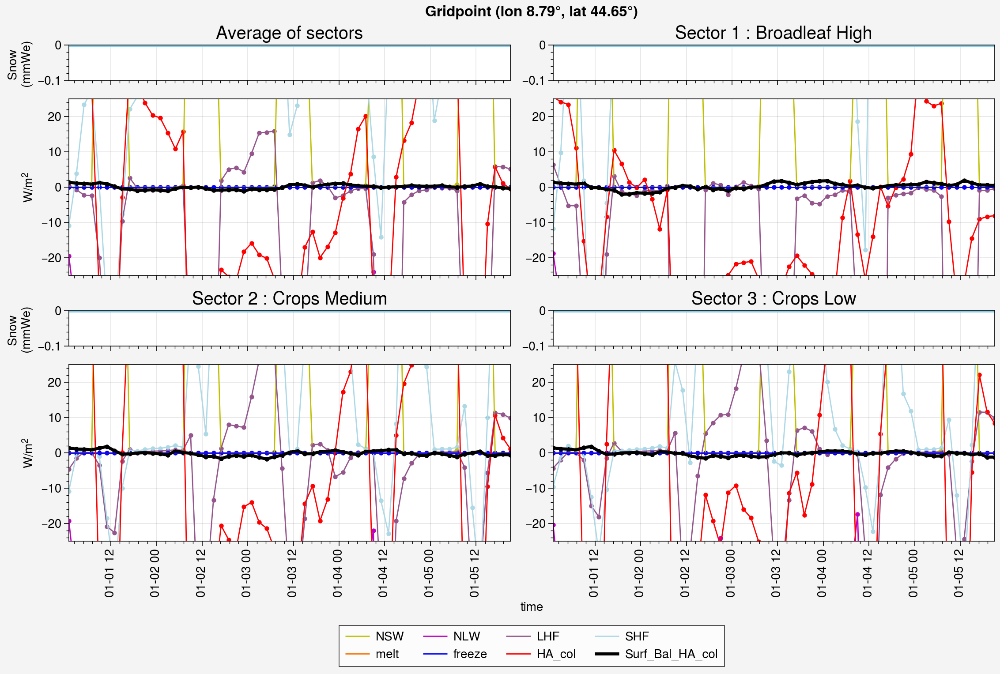

In [28]:
plot_by_mosaic(ds_var = ds_e11_k, ds_var_ave = ds_e11_ave, first=0, last=-1, iloc = i2, jloc = j2, ymin = -25, ymax = 25,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

[68] [104]
528.885


/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_225527/1935158804.py:16: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  longitude_point = round(float(lon[iloc,jloc]),2)
/tmp/ipykernel_225527/1935158804.py:17: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  latitude_point = round(float(lat[iloc,jloc]),2)
/tmp/ipykernel_225527/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in

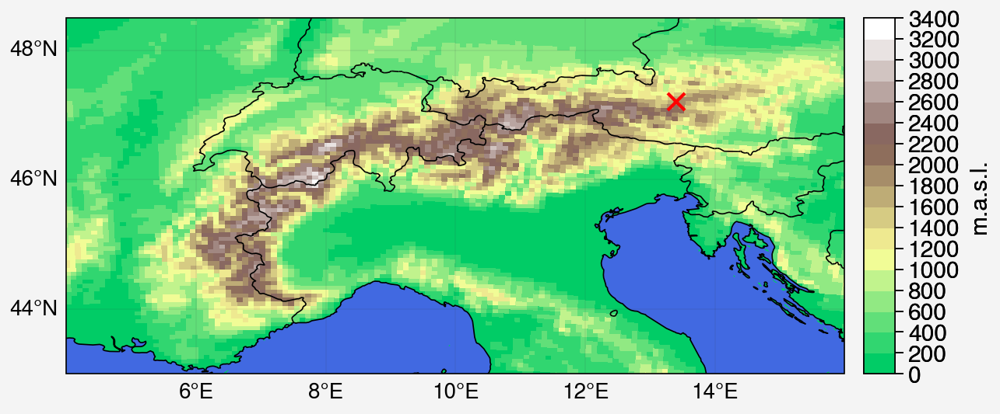

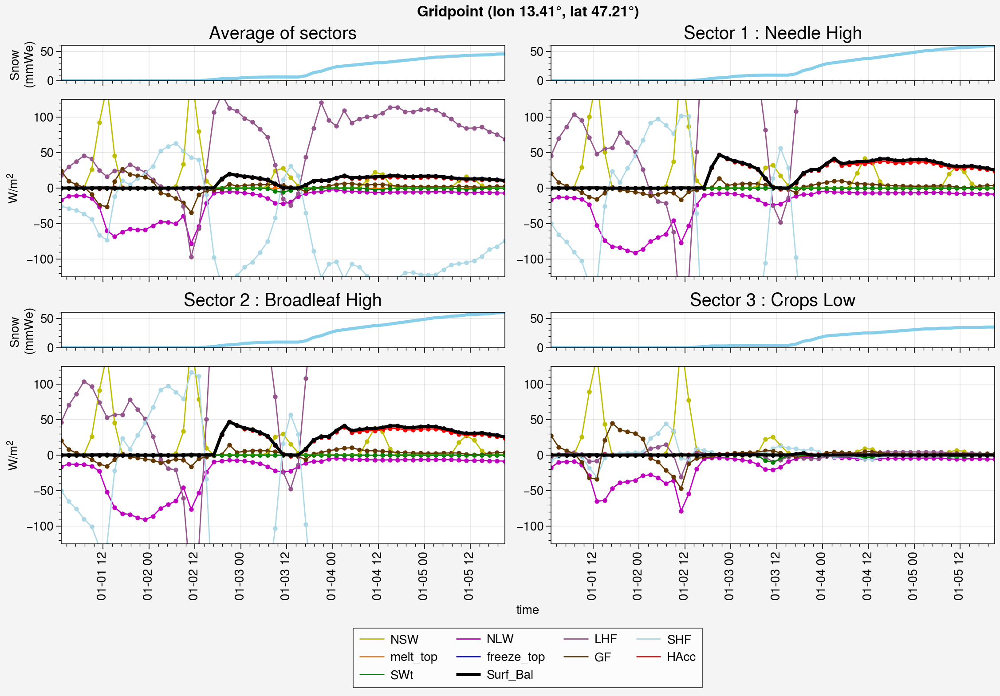

In [52]:
arr_e11_totfreeze = np.array(ds_e11_ave.freeze.sum(axis=0))
i_f, j_f = np.where(arr_e11_totfreeze==arr_e11_totfreeze.max())
print(i_f,j_f)
print(arr_e11_totfreeze.max())

plot_by_mosaic(ds_var = ds_e11_k, ds_var_ave = ds_e11_ave, first=0, last=-1, iloc = i_f, jloc = j_f, ymin = -125, ymax = 125,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_225527/1935158804.py:16: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  longitude_point = round(float(lon[iloc,jloc]),2)
/tmp/ipykernel_225527/1935158804.py:17: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  latitude_point = round(float(lat[iloc,jloc]),2)
/tmp/ipykernel_225527/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in

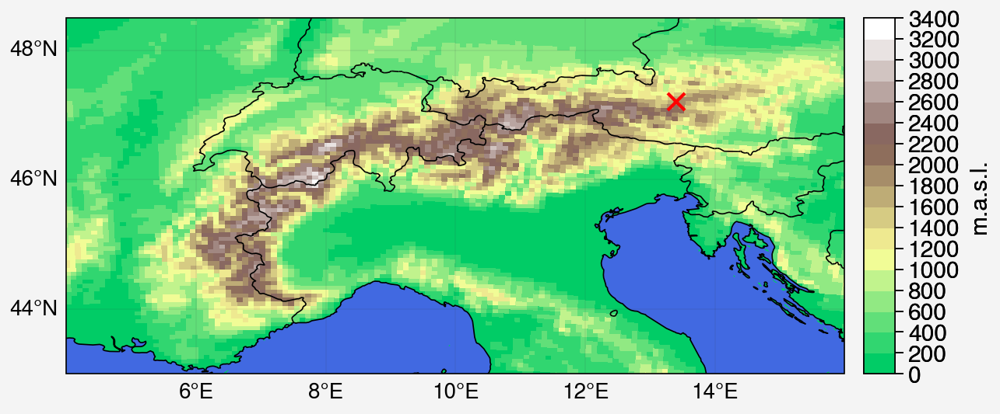

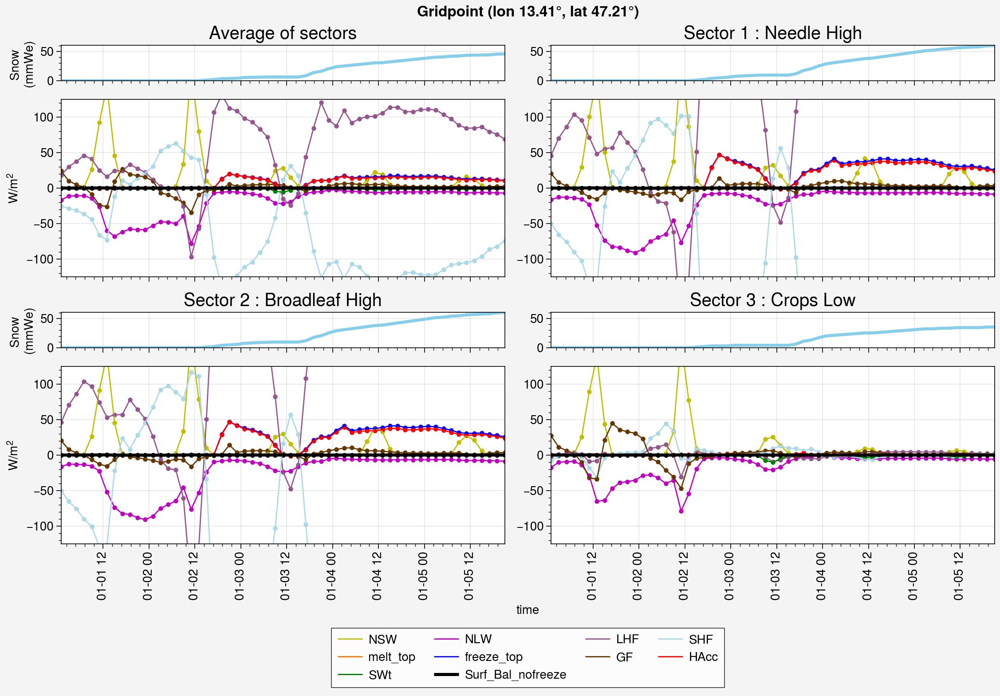

In [30]:
plot_by_mosaic(ds_var = ds_e11_k, ds_var_ave = ds_e11_ave, first=0, last=-1, iloc = i_f, jloc = j_f, ymin = -125, ymax = 125,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal_nofreeze'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_225527/1935158804.py:16: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  longitude_point = round(float(lon[iloc,jloc]),2)
/tmp/ipykernel_225527/1935158804.py:17: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  latitude_point = round(float(lat[iloc,jloc]),2)
/tmp/ipykernel_225527/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in

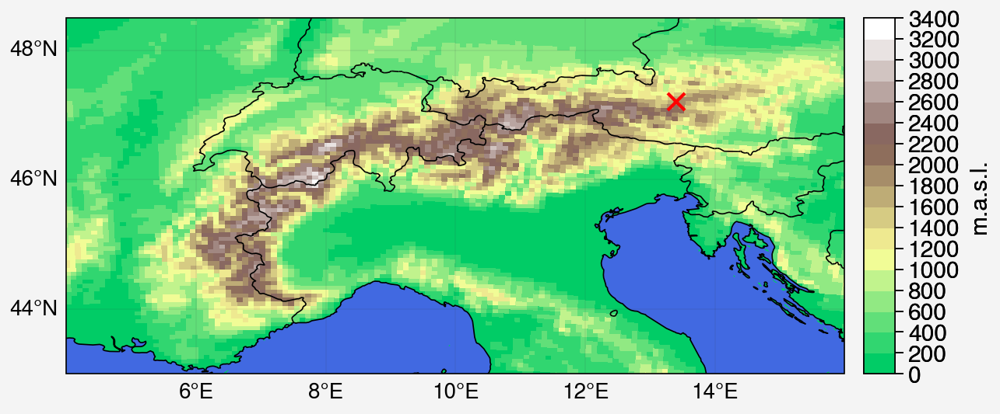

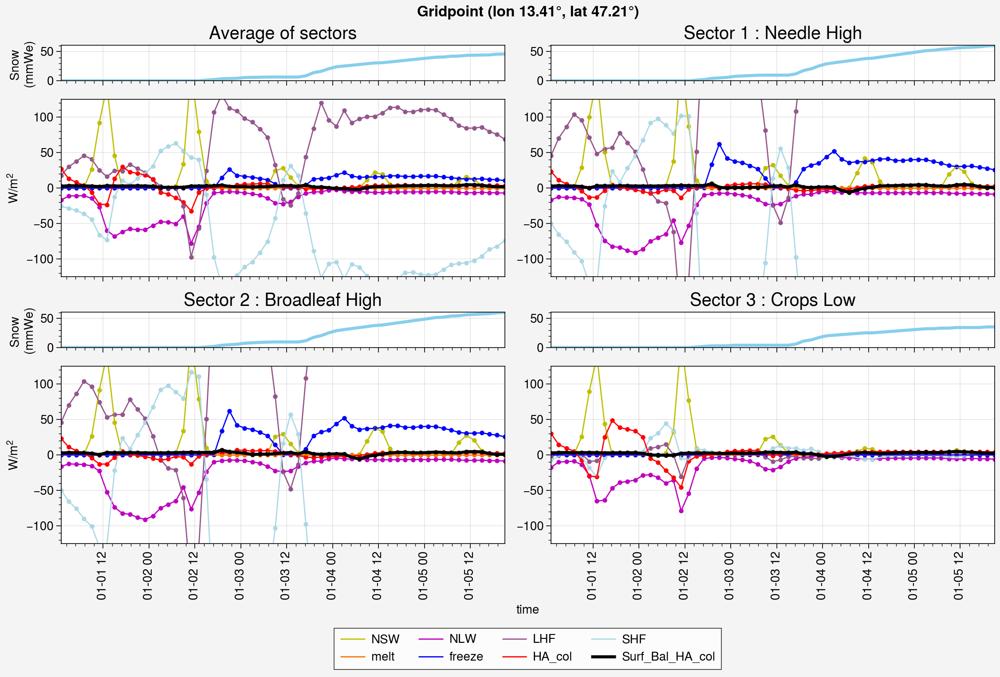

In [31]:
plot_by_mosaic(ds_var = ds_e11_k, ds_var_ave = ds_e11_ave, first=0, last=-1, iloc = i_f, jloc = j_f, ymin = -125, ymax = 125,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

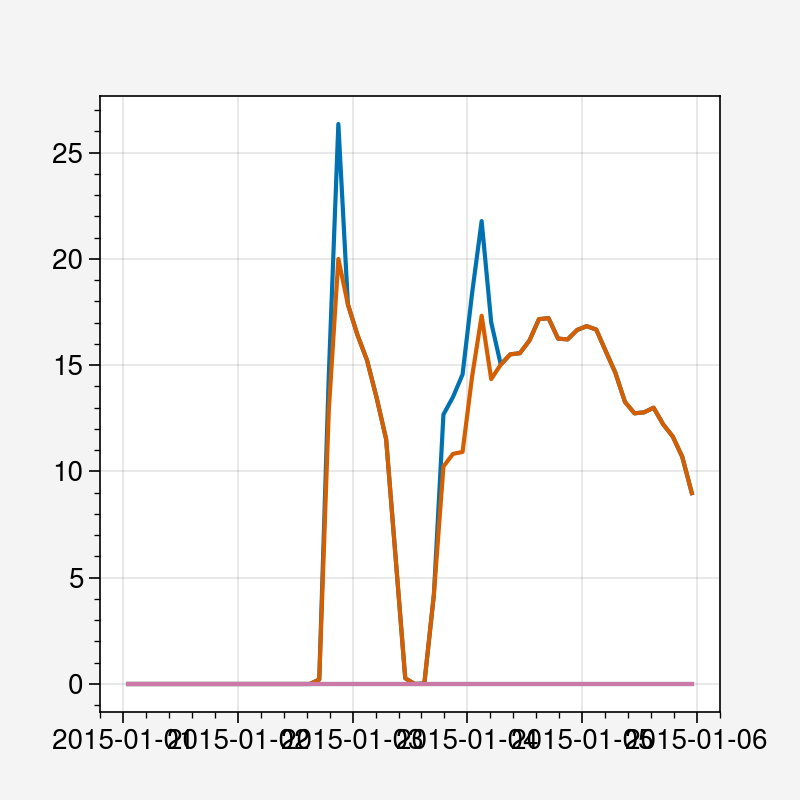

In [32]:
plt.plot(ds_e11_ave.time, ds_e11_ave.freeze[:,i_f[0],j_f[0]])
plt.plot(ds_e11_ave.time, ds_e11_ave.freeze_top[:,i_f[0],j_f[0]])

plt.plot(ds_e11_ave.time, ds_e11_ave.melt[:,i_f[0],j_f[0]])
plt.plot(ds_e11_ave.time, ds_e11_ave.melt_top[:,i_f[0],j_f[0]])

[84] [92]
-442.65826


/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_225527/1935158804.py:16: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  longitude_point = round(float(lon[iloc,jloc]),2)
/tmp/ipykernel_225527/1935158804.py:17: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  latitude_point = round(float(lat[iloc,jloc]),2)
/tmp/ipykernel_225527/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in

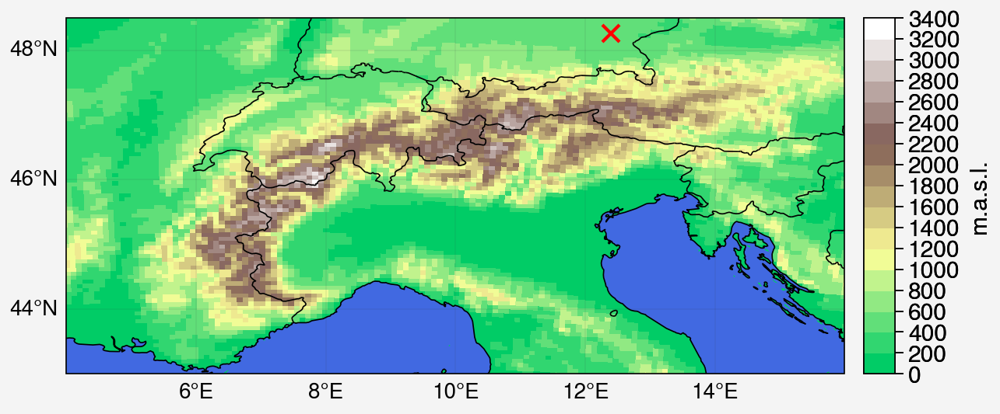

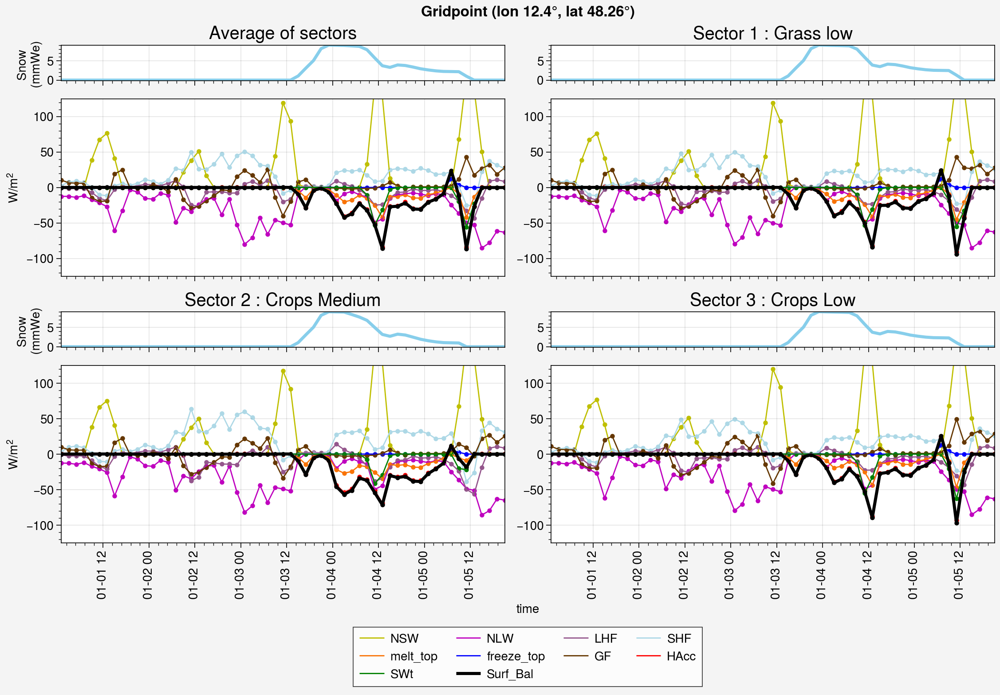

In [50]:
arr_e11_totmelt = np.array(ds_e11_ave.melt.sum(axis=0))
i_m, j_m = np.where(arr_e11_totmelt==arr_e11_totmelt.min())
print(i_m,j_m)
print(arr_e11_totmelt.min())

plot_by_mosaic(ds_var = ds_e11_k, ds_var_ave = ds_e11_ave, first=0, last=-1, iloc = i_m, jloc = j_m, ymin = -125, ymax = 125,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_225527/1935158804.py:16: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  longitude_point = round(float(lon[iloc,jloc]),2)
/tmp/ipykernel_225527/1935158804.py:17: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  latitude_point = round(float(lat[iloc,jloc]),2)
/tmp/ipykernel_225527/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in

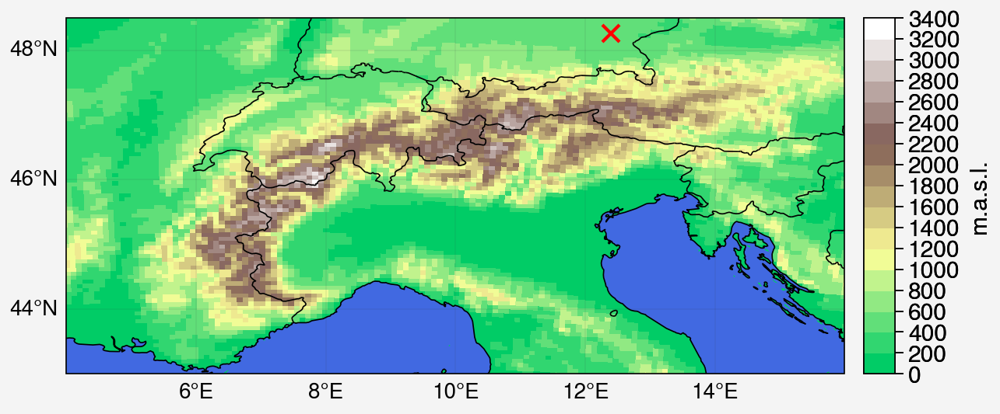

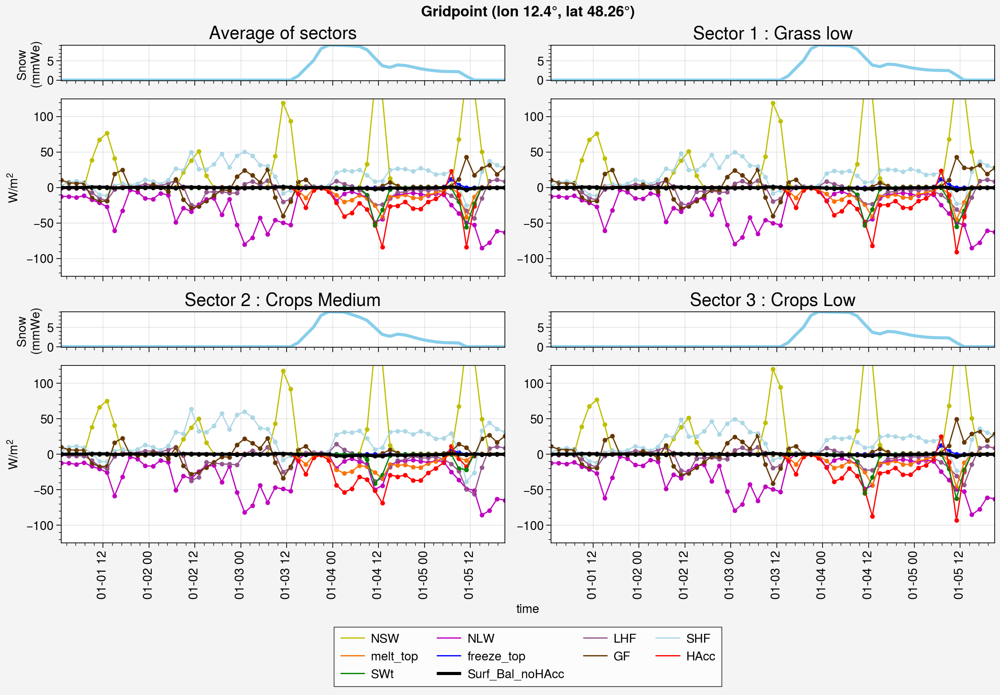

In [34]:
plot_by_mosaic(ds_var = ds_e11_k, ds_var_ave = ds_e11_ave, first=0, last=-1, iloc = i_m, jloc = j_m, ymin = -125, ymax = 125,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal_noHAcc'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_225527/1935158804.py:16: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  longitude_point = round(float(lon[iloc,jloc]),2)
/tmp/ipykernel_225527/1935158804.py:17: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  latitude_point = round(float(lat[iloc,jloc]),2)
/tmp/ipykernel_225527/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in

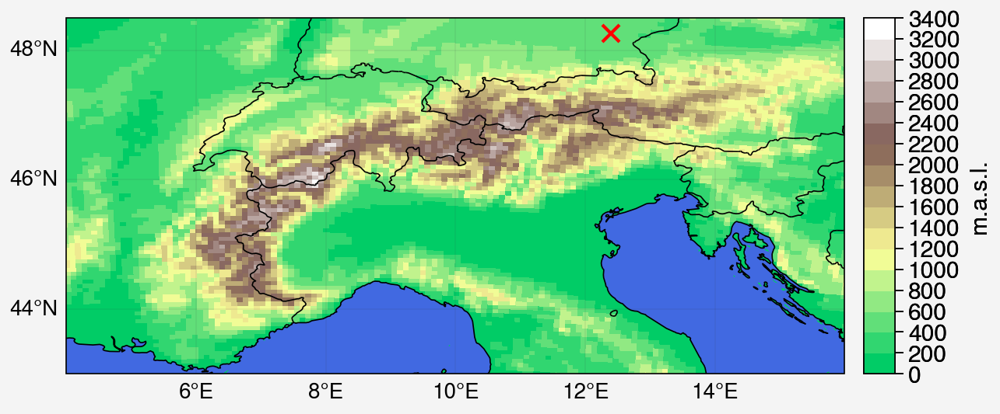

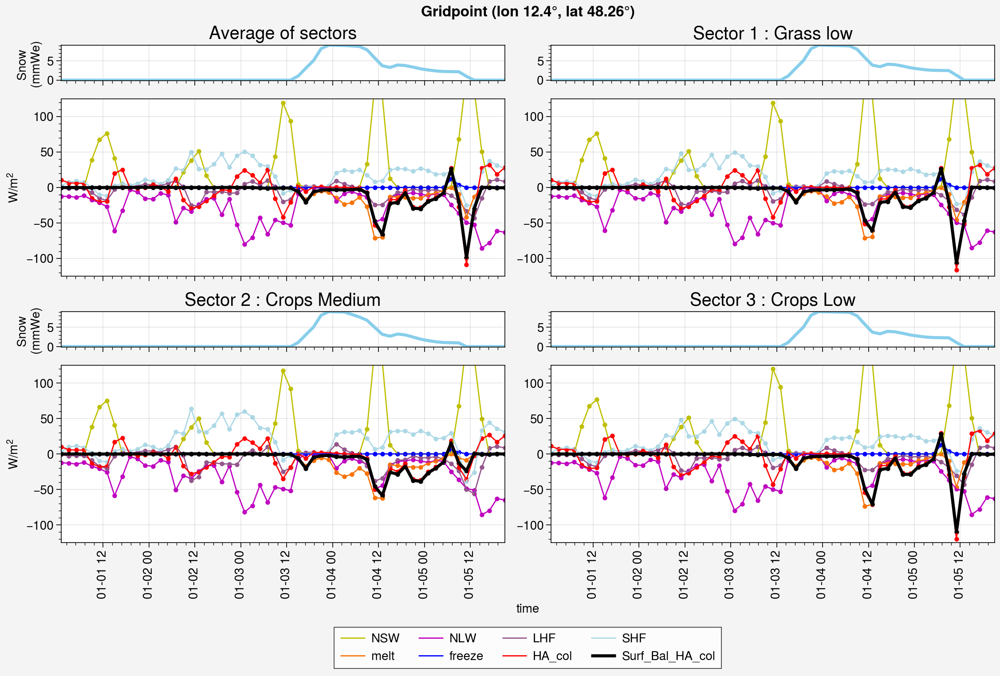

In [35]:
plot_by_mosaic(ds_var = ds_e11_k, ds_var_ave = ds_e11_ave, first=0, last=-1, iloc = i_m, jloc = j_m, ymin = -125, ymax = 125,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

#### e12

In [14]:
ds_e12_k = open_monthly_data_k(month='01',days_in_month='05',sim='e12',day_average=False,HA_col=True,timestep_in_hours = 2)
ds_e12_ave = open_monthly_data_ave(month='01',days_in_month='05',sim='e12',day_average=False,HA_col=True,timestep_in_hours = 2)

In [15]:
ds_day = xr.open_dataset('/bettik/castelli/MARout/EUe/e12/2015/ICE.e12.2015.01.01-05.nc')[["ST2"]].isel(x=slice(imin,imax),y=slice(jmin,jmax))
ds_e12_k["ST2"] = ds_day["ST2"]

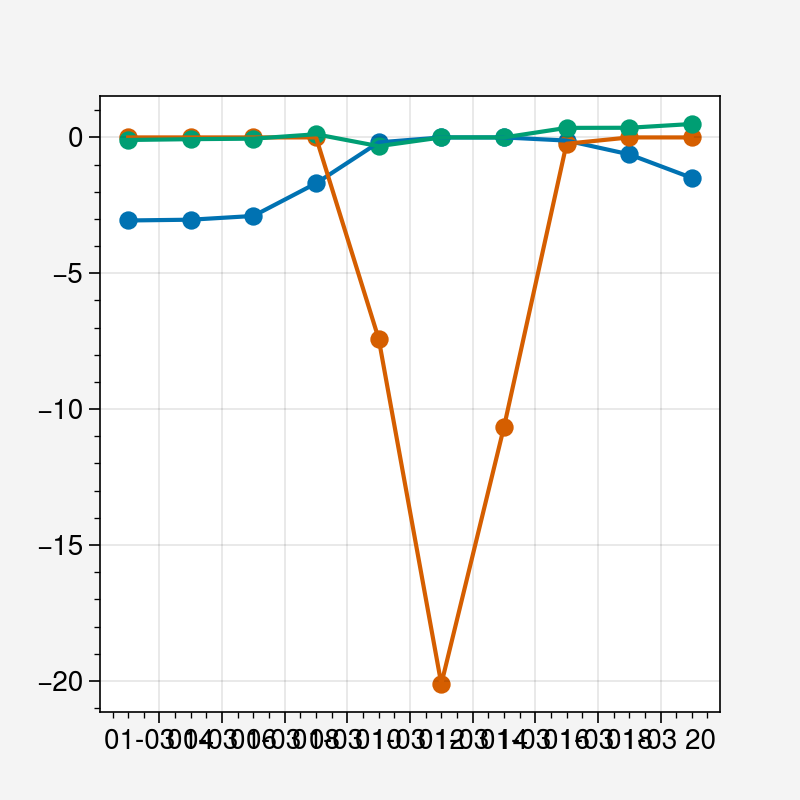

In [44]:
start = 25
end = 35

ds_plo = ds_e12_k

plt.plot(ds_plo.time[start:end],ds_plo['ST2'].sel(sector="1.0")[start:end,i_soil,j_soil])
plt.scatter(ds_plo.time[start:end],ds_plo['ST2'].sel(sector="1.0")[start:end,i_soil,j_soil])
plt.plot(ds_plo.time[start:end],ds_plo['melt_topk'].sel(sector="1.0")[start:end,i_soil,j_soil])
plt.scatter(ds_plo.time[start:end],ds_plo['melt_topk'].sel(sector="1.0")[start:end,i_soil,j_soil])

plt.plot(ds_plo.time[start:end],ds_plo['HAcck'].sel(sector="1.0")[start:end,i_soil,j_soil])
plt.scatter(ds_plo.time[start:end],ds_plo['HAcck'].sel(sector="1.0")[start:end,i_soil,j_soil])
#plt.plot(ds_plo.time,ds_plo['MB'].sel(sector="1.0")[:,i_soil,j_soil])


/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2561210/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_2561210/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


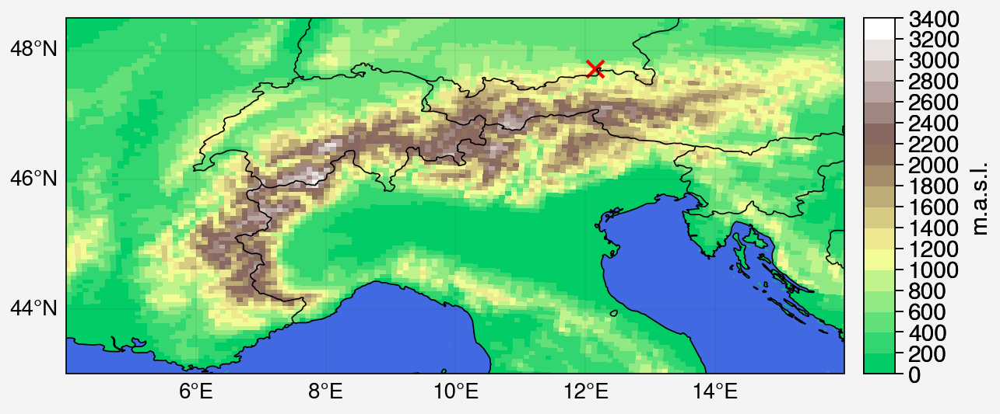

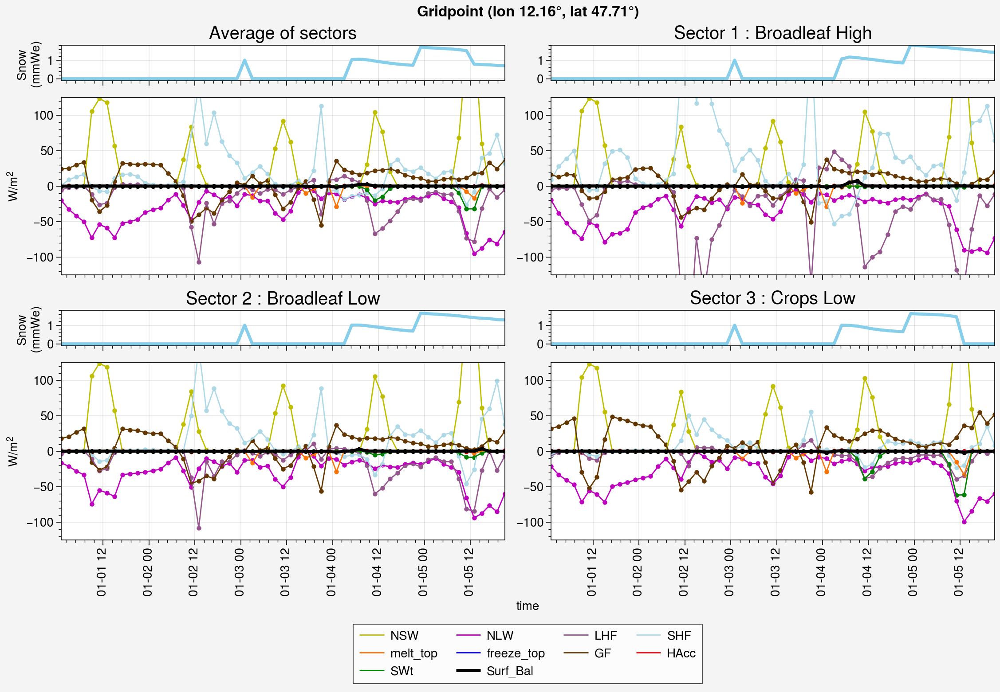

In [45]:
plot_by_mosaic(ds_var = ds_e12_k, ds_var_ave = ds_e12_ave, first=0, last=-1, iloc = i1, jloc = j1, ymin = -125, ymax = 125,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2561210/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_2561210/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


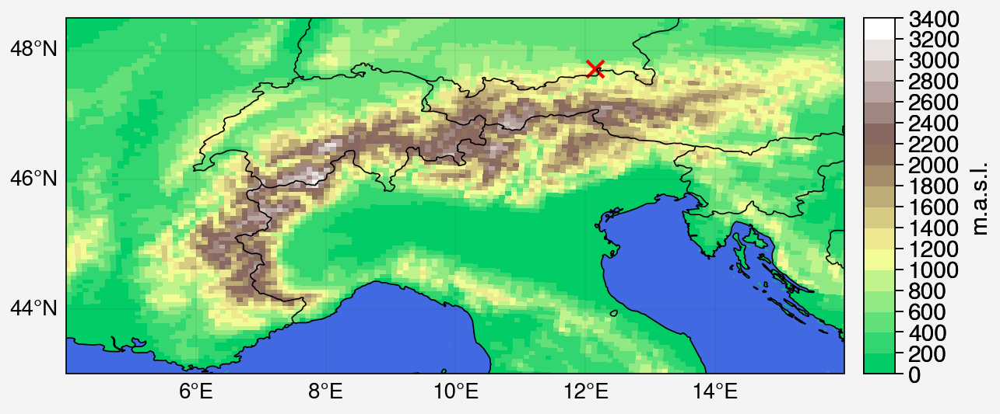

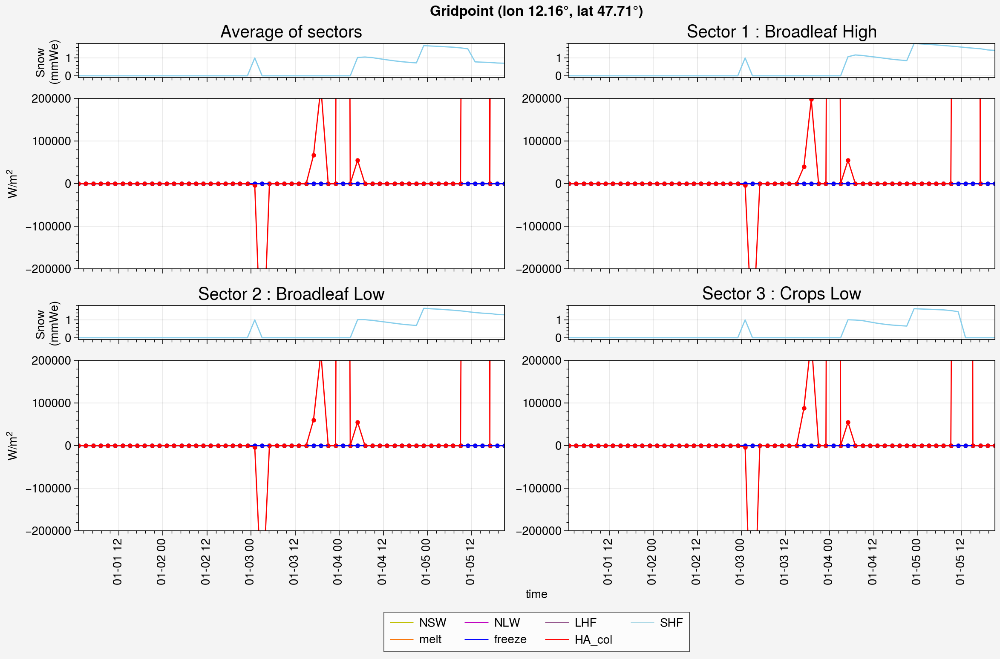

In [46]:
plot_by_mosaic(ds_var = ds_e12_k, ds_var_ave = ds_e12_ave, first=0, last=-1, iloc = i1, jloc = j1, ymin = -200000, ymax = 200000,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r'])

#### e13

In [47]:
ds_e13_k = open_monthly_data_k(month='01',days_in_month='05',sim='e13',day_average=False,HA_col=True,timestep_in_hours = 2)
ds_e13_ave = open_monthly_data_ave(month='01',days_in_month='05',sim='e13',day_average=False,HA_col=True,timestep_in_hours = 2)

In [48]:
ds_day = xr.open_dataset('/bettik/castelli/MARout/EUe/e13/2015/ICE.e13.2015.01.01-05.nc')[["ST2"]].isel(x=slice(imin,imax),y=slice(jmin,jmax))
ds_e13_k["ST2"] = ds_day["ST2"]

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2561210/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_2561210/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


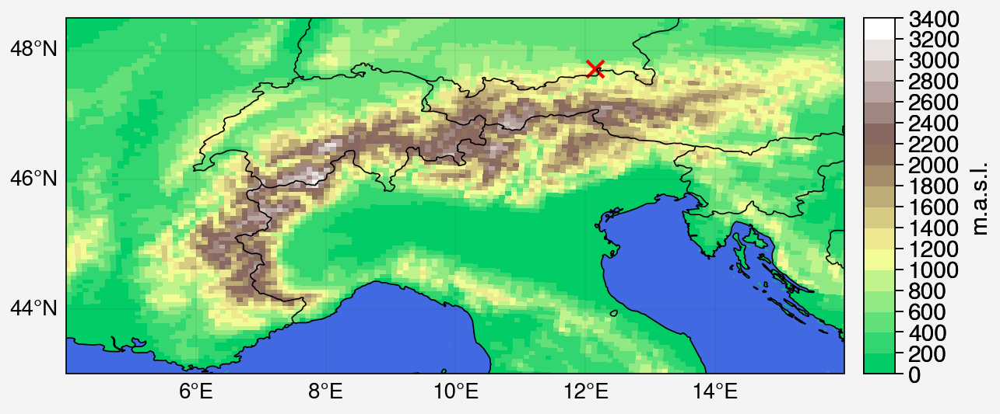

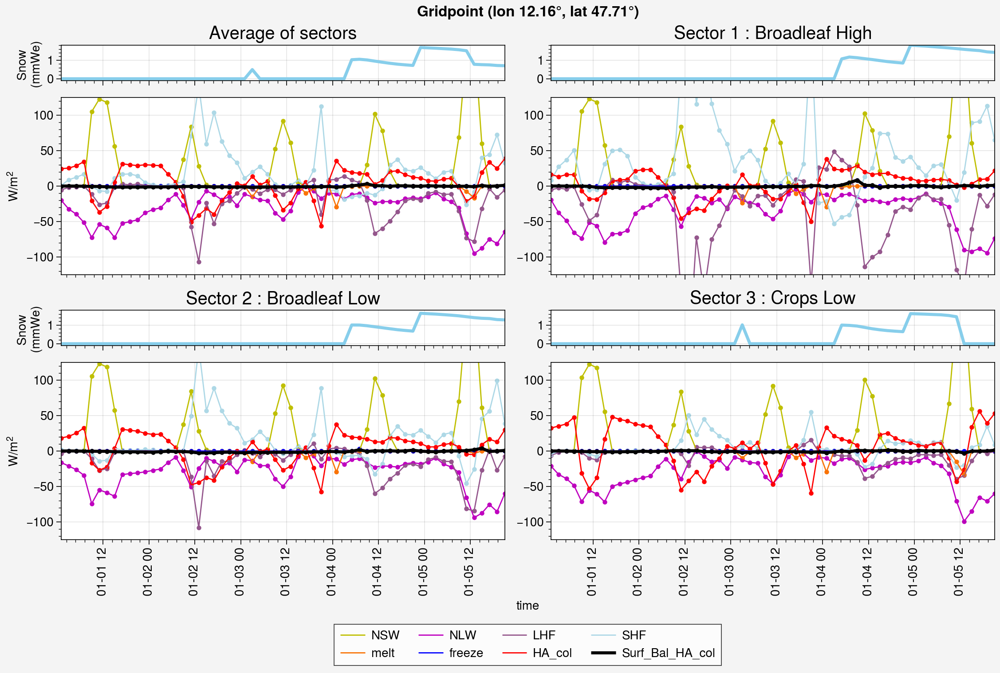

In [51]:
plot_by_mosaic(ds_var = ds_e13_k, ds_var_ave = ds_e13_ave, first=0, last=-1, iloc = i1, jloc = j1, ymin = -125, ymax = 125,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2561210/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_2561210/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


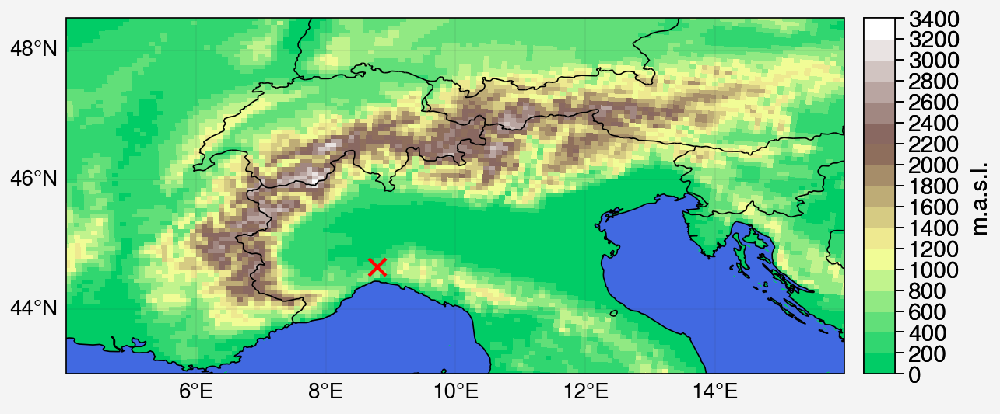

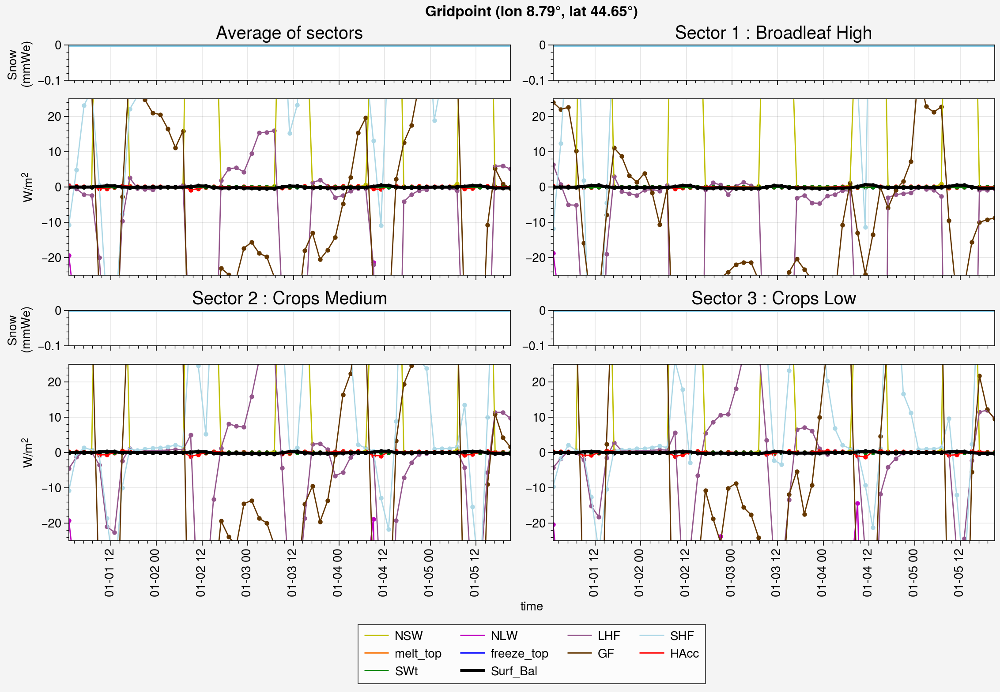

In [52]:
plot_by_mosaic(ds_var = ds_e13_k, ds_var_ave = ds_e13_ave, first=0, last=-1, iloc = i2, jloc = j2, ymin = -25, ymax = 25,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2561210/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_2561210/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


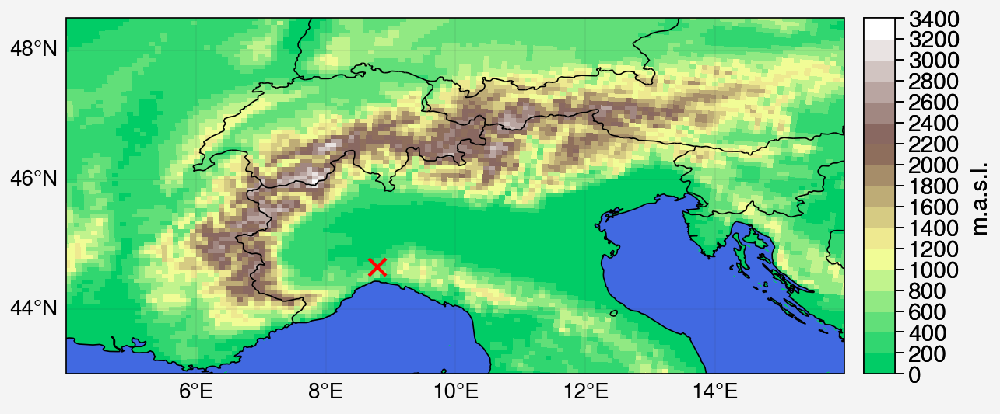

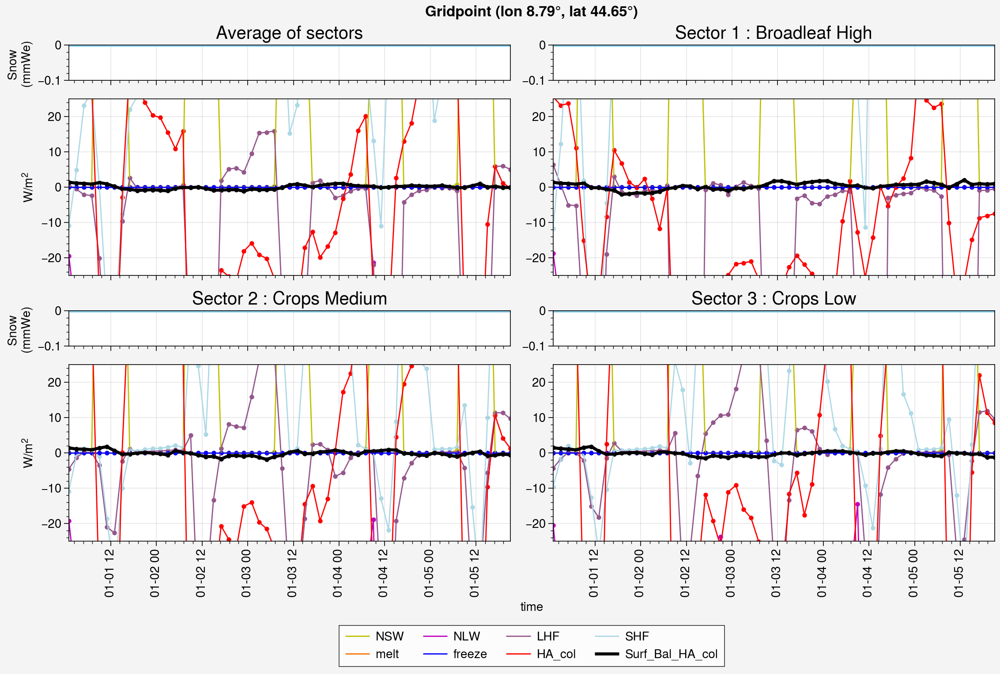

In [53]:
plot_by_mosaic(ds_var = ds_e13_k, ds_var_ave = ds_e13_ave, first=0, last=-1, iloc = i2, jloc = j2, ymin = -25, ymax = 25,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2561210/1935158804.py:16: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  longitude_point = round(float(lon[iloc,jloc]),2)
/tmp/ipykernel_2561210/1935158804.py:17: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  latitude_point = round(float(lat[iloc,jloc]),2)
/tmp/ipykernel_2561210/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize'

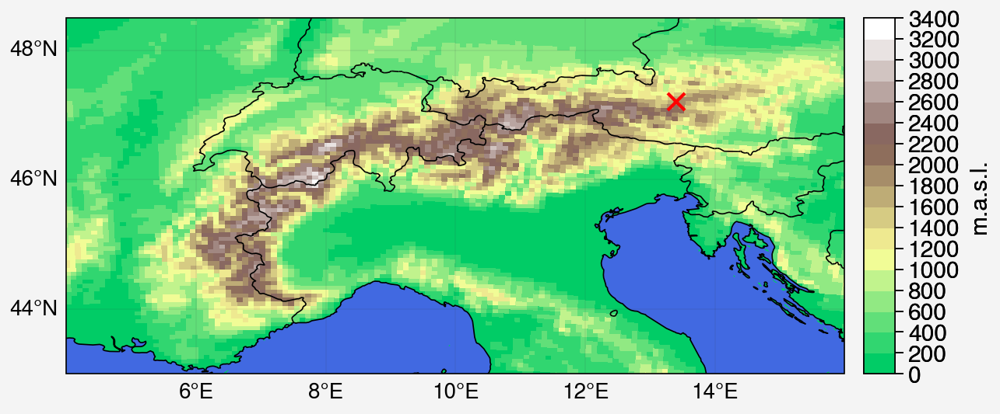

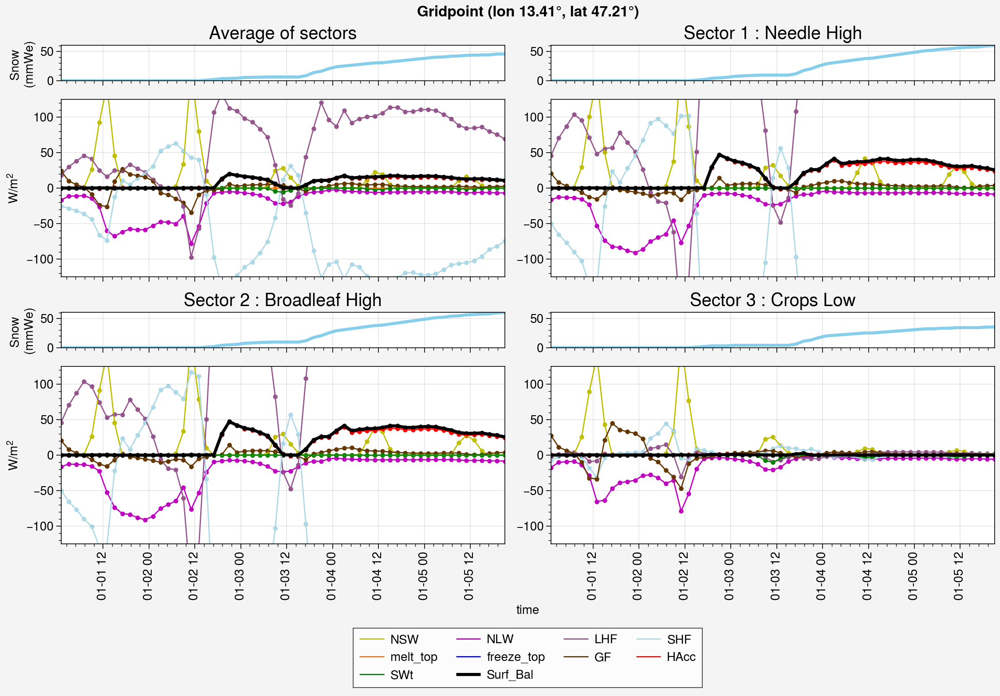

In [54]:
arr_e13_totfreeze = np.array(ds_e13_ave.freeze.sum(axis=0))
i_f, j_f = np.where(arr_e13_totfreeze==arr_e13_totfreeze.max())
i_f,j_f

plot_by_mosaic(ds_var = ds_e13_k, ds_var_ave = ds_e13_ave, first=0, last=-1, iloc = i_f, jloc = j_f, ymin = -125, ymax = 125,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2561210/1935158804.py:16: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  longitude_point = round(float(lon[iloc,jloc]),2)
/tmp/ipykernel_2561210/1935158804.py:17: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  latitude_point = round(float(lat[iloc,jloc]),2)
/tmp/ipykernel_2561210/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize'

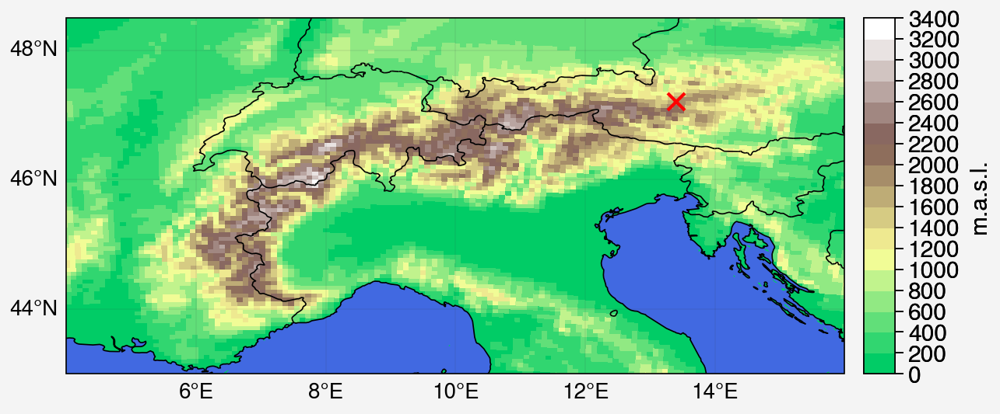

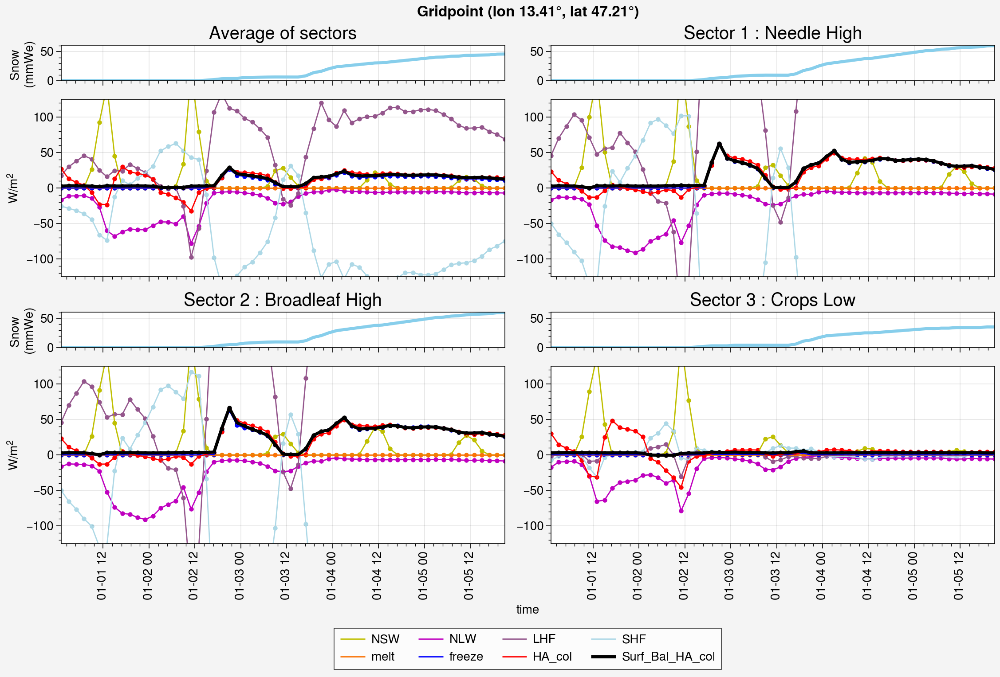

In [55]:
plot_by_mosaic(ds_var = ds_e13_k, ds_var_ave = ds_e13_ave, first=0, last=-1, iloc = i_f, jloc = j_f, ymin = -125, ymax = 125,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_2561210/1935158804.py:16: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  longitude_point = round(float(lon[iloc,jloc]),2)
/tmp/ipykernel_2561210/1935158804.py:17: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  latitude_point = round(float(lat[iloc,jloc]),2)
/tmp/ipykernel_2561210/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize'

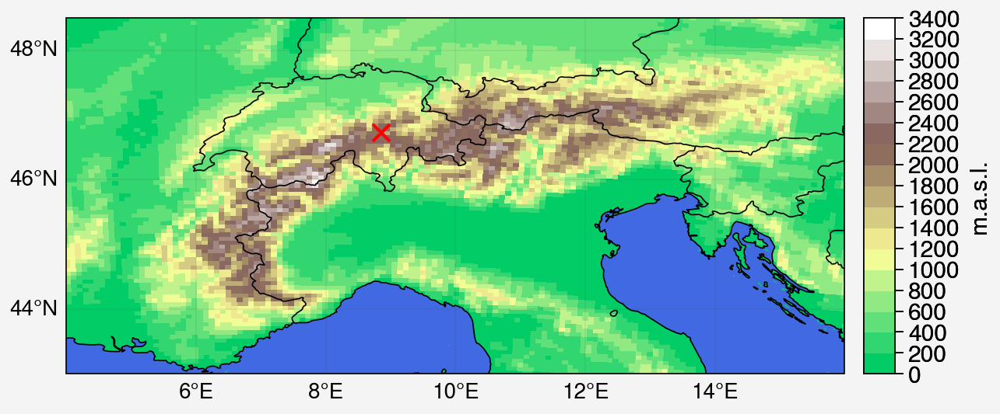

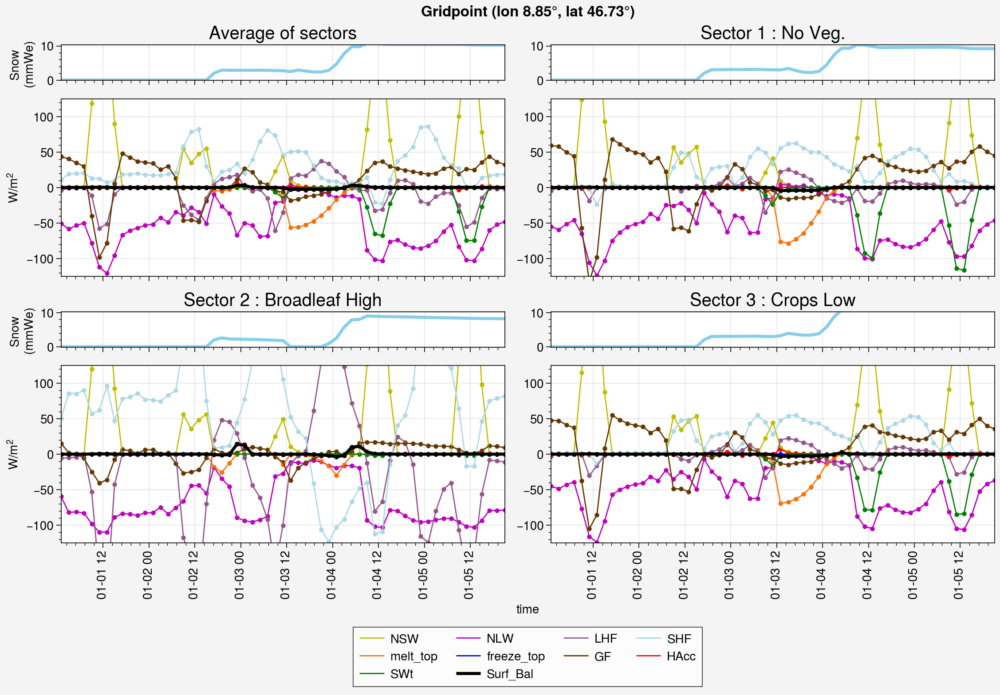

In [56]:
arr_e13_totmelt = np.array(ds_e13_ave.melt.sum(axis=0))
i_m, j_m = np.where(arr_e13_totmelt==arr_e13_totmelt.min())
i_m,j_m

plot_by_mosaic(ds_var = ds_e13_k, ds_var_ave = ds_e13_ave, first=0, last=-1, iloc = i_m, jloc = j_m, ymin = -125, ymax = 125,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

#### e14

In [15]:
ds_e14_k = open_monthly_data_k(month='01',days_in_month='05',sim='e14',day_average=False,HA_col=True,timestep_in_hours = 2)
ds_e14_ave = open_monthly_data_ave(month='01',days_in_month='05',sim='e14',day_average=False,HA_col=True,timestep_in_hours = 2)

In [23]:
ds_day = xr.open_dataset('/bettik/castelli/MARout/EUe/e14/2015/ICE.e14.2015.01.01-05.nc')[["ST2"]].isel(x=slice(imin,imax),y=slice(jmin,jmax))
ds_e14_k["ST2"] = ds_day["ST2"]

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_1191547/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_1191547/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


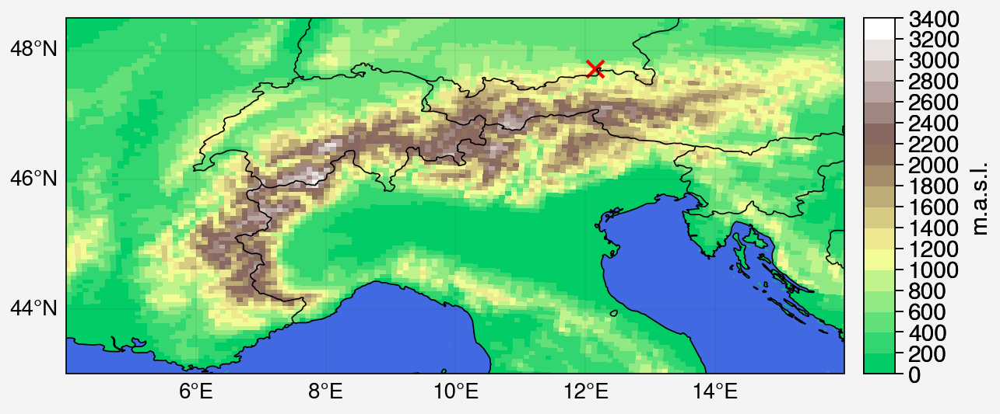

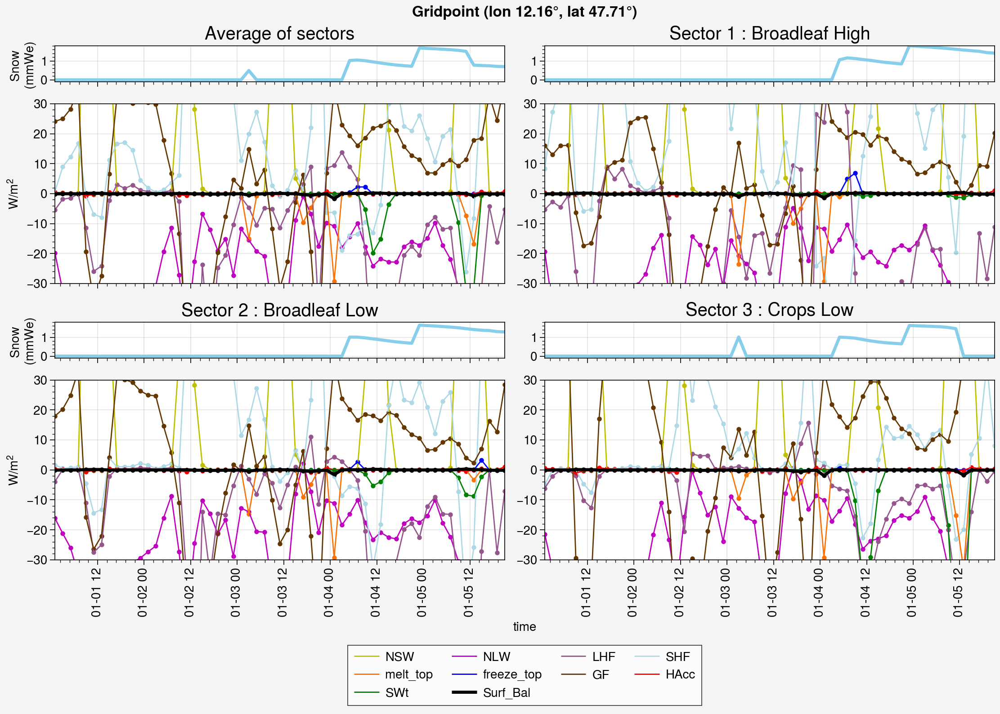

In [24]:
plot_by_mosaic(ds_var = ds_e14_k, ds_var_ave = ds_e14_ave, first=0, last=-1, iloc = i1, jloc = j1, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_1191547/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_1191547/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


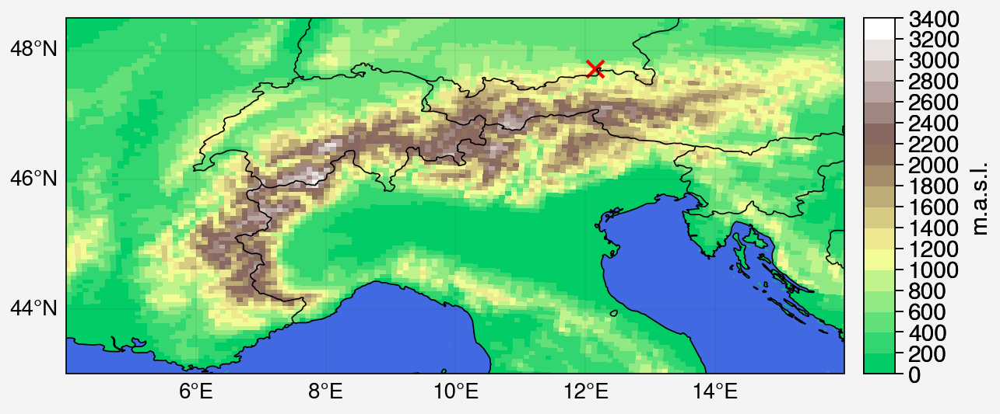

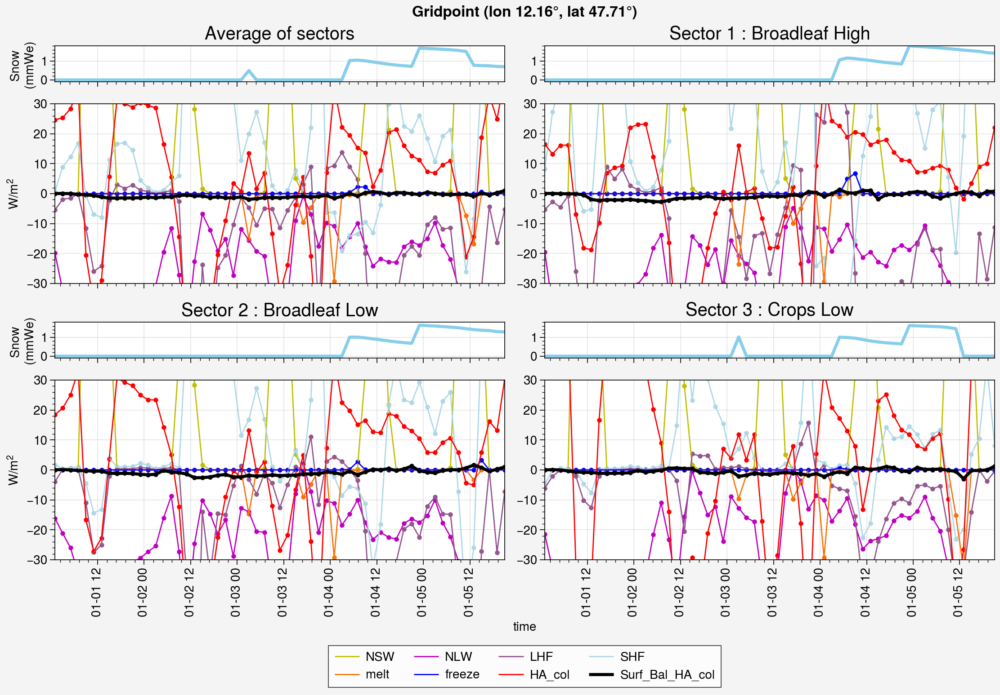

In [25]:
plot_by_mosaic(ds_var = ds_e14_k, ds_var_ave = ds_e14_ave, first=0, last=-1, iloc = i1, jloc = j1, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_1191547/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_1191547/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


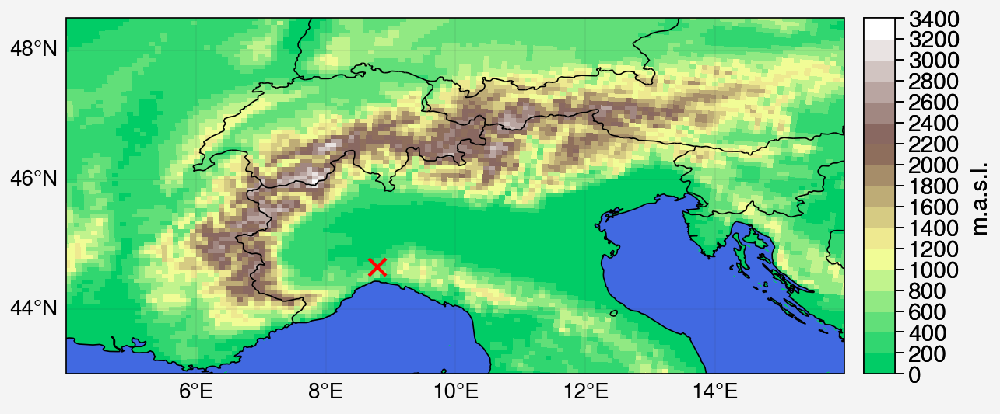

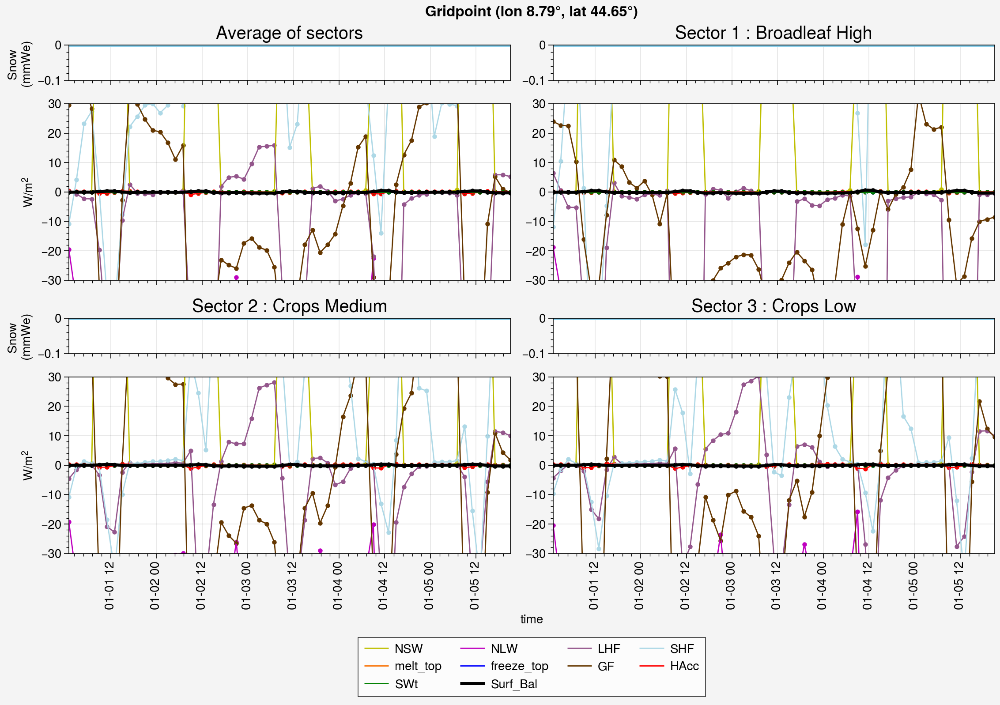

In [26]:
plot_by_mosaic(ds_var = ds_e14_k, ds_var_ave = ds_e14_ave, first=0, last=-1, iloc = i2, jloc = j2, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_1191547/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_1191547/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


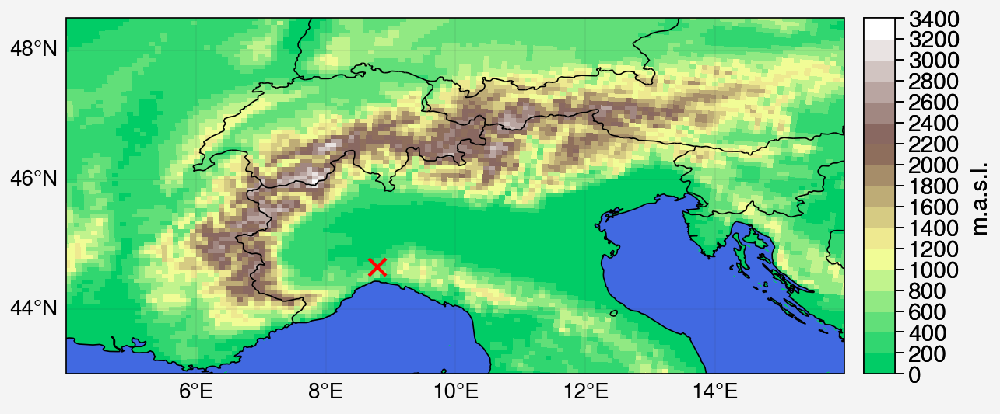

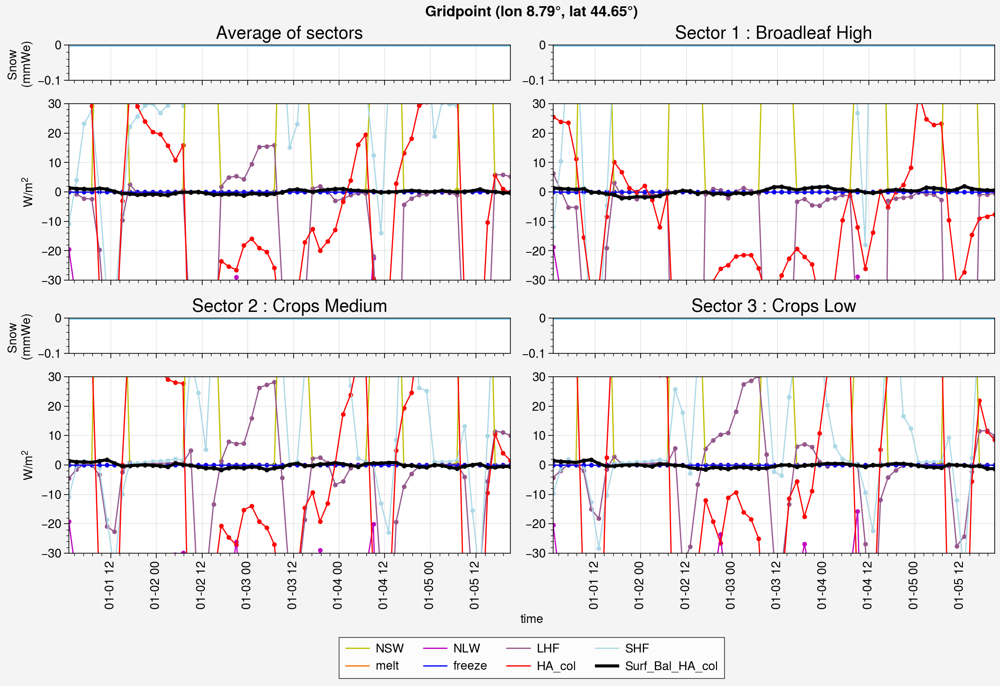

In [27]:
plot_by_mosaic(ds_var = ds_e14_k, ds_var_ave = ds_e14_ave, first=0, last=-1, iloc = i2, jloc = j2, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_1191547/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_1191547/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


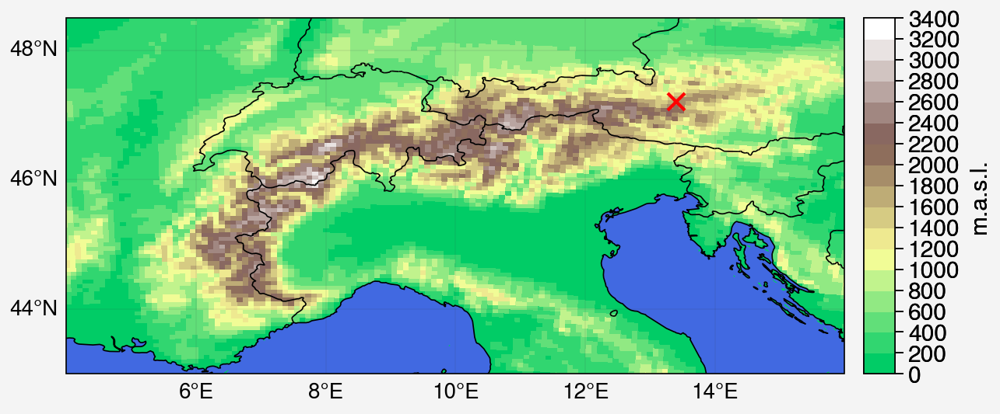

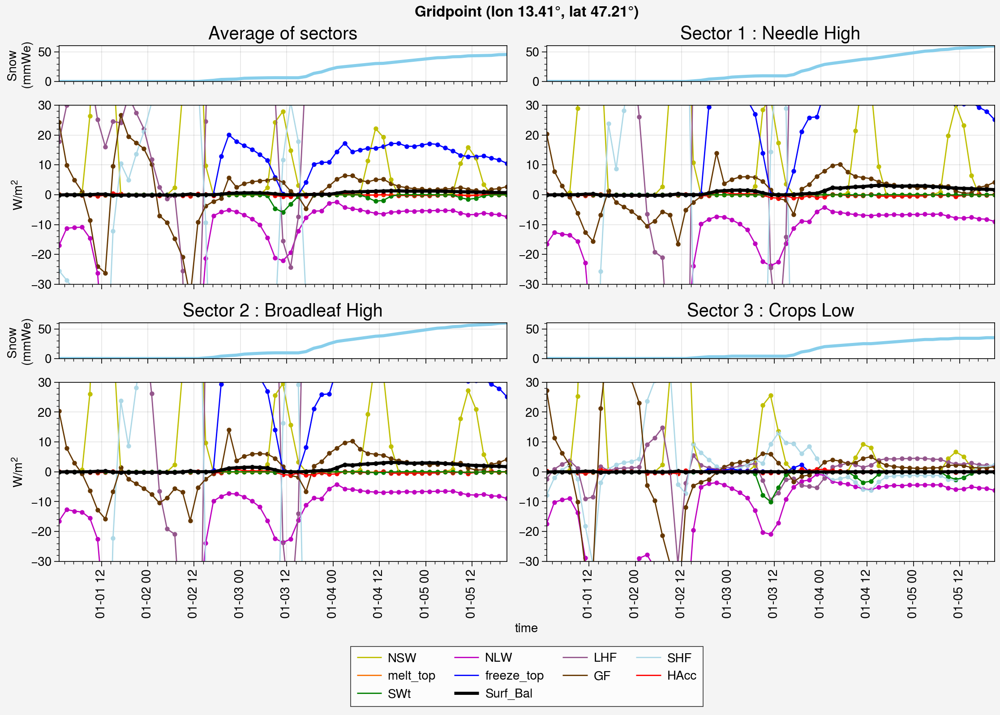

In [28]:
# arr_e14_totfreeze = np.array(ds_e14_ave.freeze.sum(axis=0))
# i_f, j_f = np.where(arr_e14_totfreeze==arr_e14_totfreeze.max())
# print(i_f,j_f)
# print(arr_e14_totfreeze.max())

plot_by_mosaic(ds_var = ds_e14_k, ds_var_ave = ds_e14_ave, first=0, last=-1, iloc = i_f, jloc = j_f, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_1191547/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_1191547/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


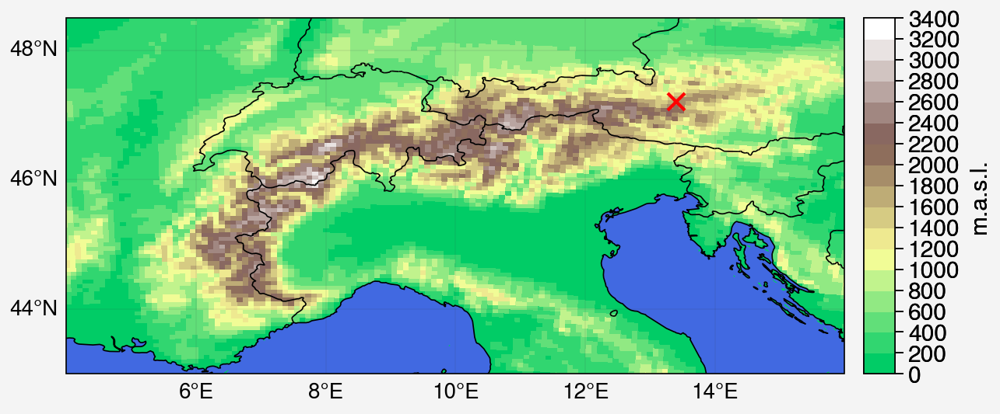

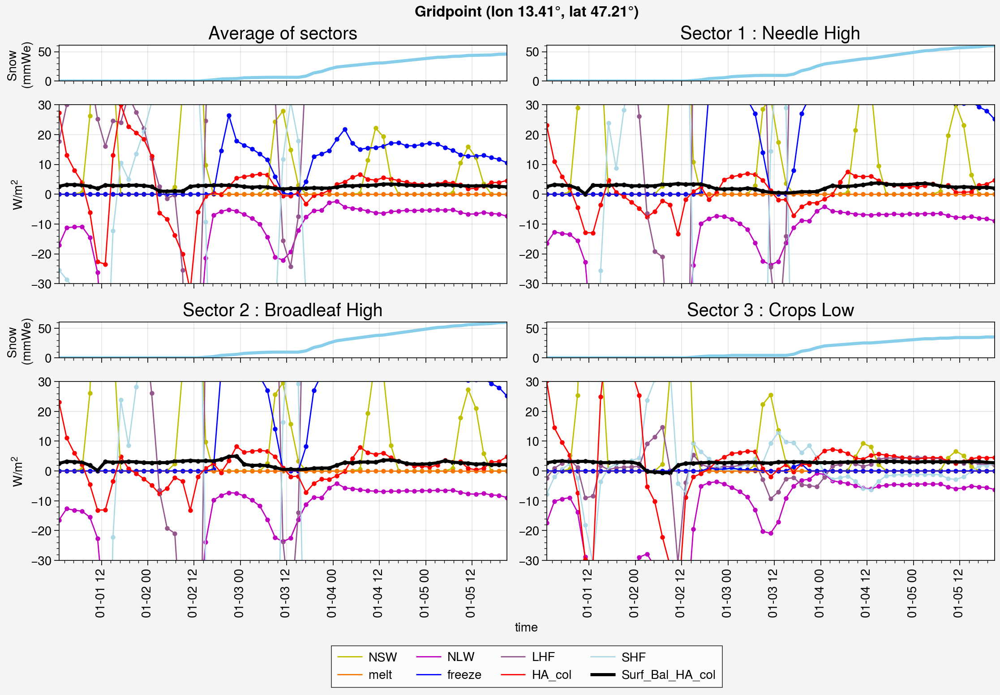

In [29]:
plot_by_mosaic(ds_var = ds_e14_k, ds_var_ave = ds_e14_ave, first=0, last=-1, iloc = i_f, jloc = j_f, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_1191547/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_1191547/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


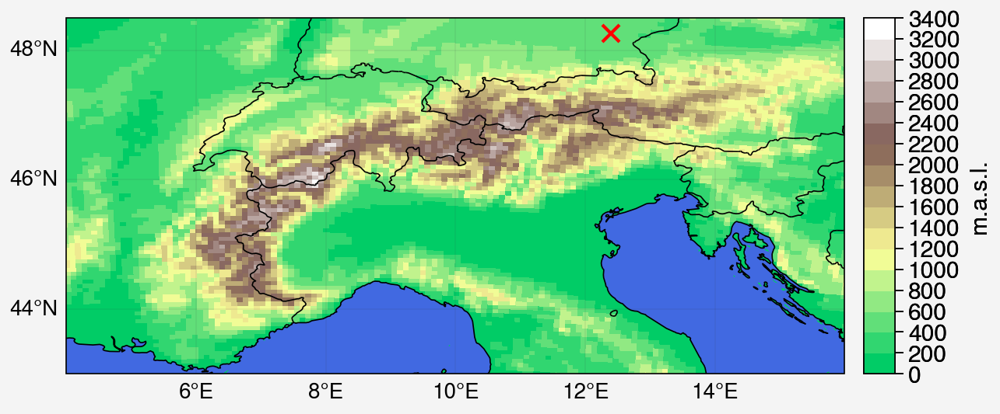

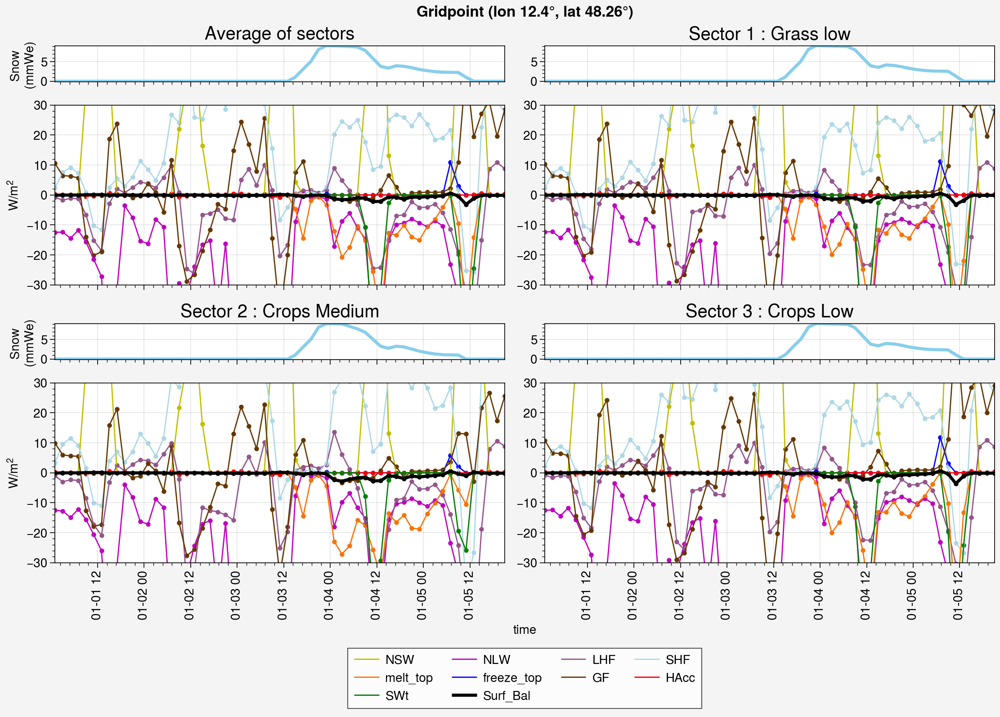

In [30]:
# arr_e14_totmelt = np.array(ds_e14_ave.melt.sum(axis=0))
# i_m, j_m = np.where(arr_e14_totmelt==arr_e14_totmelt.min())
# print(i_m,j_m)
# print(arr_e14_totmelt.min())

plot_by_mosaic(ds_var = ds_e14_k, ds_var_ave = ds_e14_ave, first=0, last=-1, iloc = i_m, jloc = j_m, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_1191547/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_1191547/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


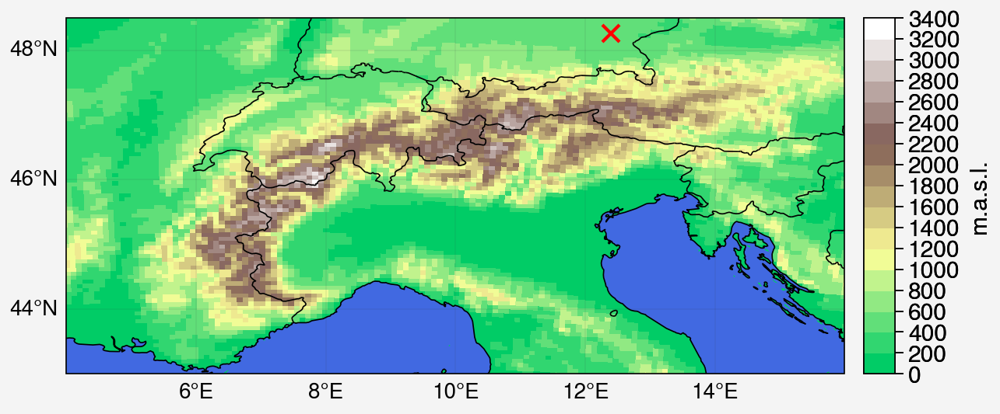

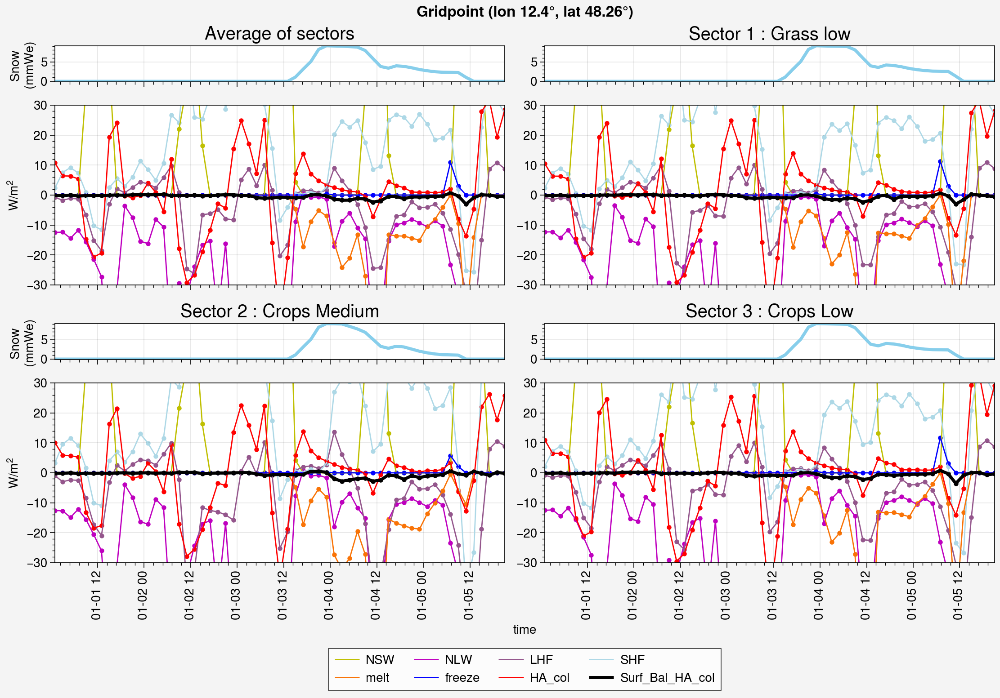

In [31]:
plot_by_mosaic(ds_var = ds_e14_k, ds_var_ave = ds_e14_ave, first=0, last=-1, iloc = i_m, jloc = j_m, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

#### e16 : July 01-05, with limit

In [16]:
ds_e16_k = open_monthly_data_k(year='2015',month='07',days_in_month='05',sim='e16',day_average=False,HA_col=True,timestep_in_hours = 2)
ds_e16_ave = open_monthly_data_ave(year='2015',month='07',days_in_month='05',sim='e16',day_average=False,HA_col=True,timestep_in_hours = 2)

In [24]:
ds_day = xr.open_dataset('/bettik/castelli/MARout/EUe/e16/2015/ICE.e16.2015.07.01-05.nc')[["ST2"]].isel(x=slice(imin,imax),y=slice(jmin,jmax))
ds_e16_k["ST2"] = ds_day["ST2"]

ds_day = xr.open_dataset('/bettik/castelli/MARout/EUe/e16/2015/ICE.e16.2015.07.01-05.nc')[["CC"]].isel(x=slice(imin,imax),y=slice(jmin,jmax))
ds_e16_k["CC"] = ds_day["CC"]
ds_e16_ave["CC"] = ds_day["CC"]

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_411672/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_411672/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


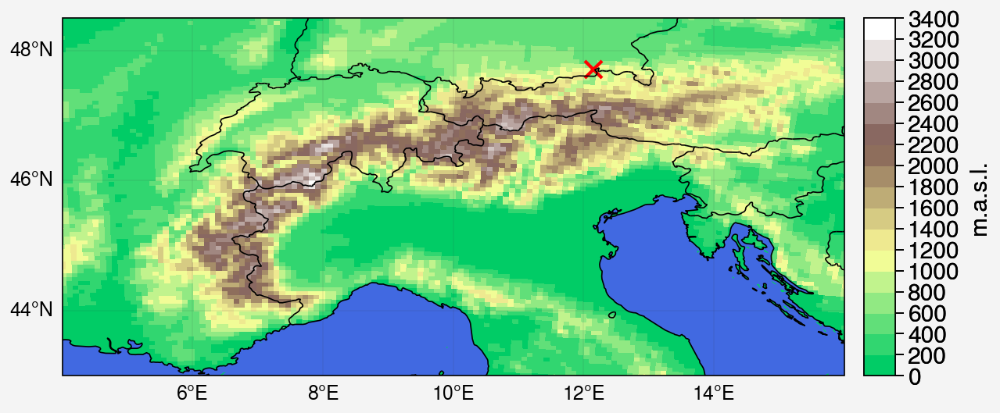

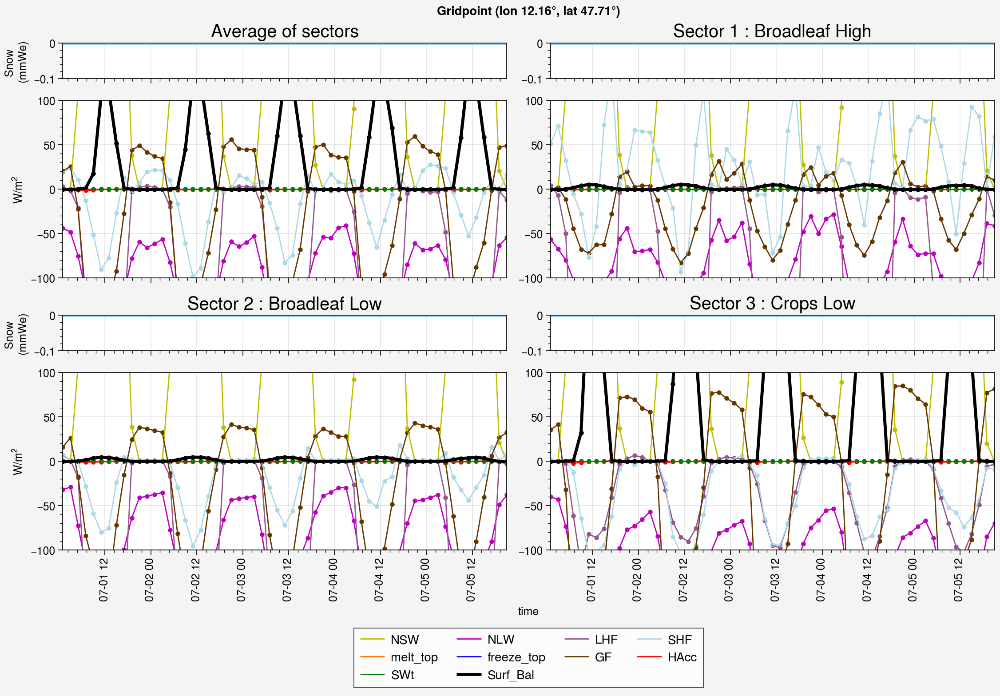

In [18]:
plot_by_mosaic(ds_var = ds_e16_k, ds_var_ave = ds_e16_ave, first=0, last=-1, iloc = i1, jloc = j1, ymin = -100, ymax = 100,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_1191547/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_1191547/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


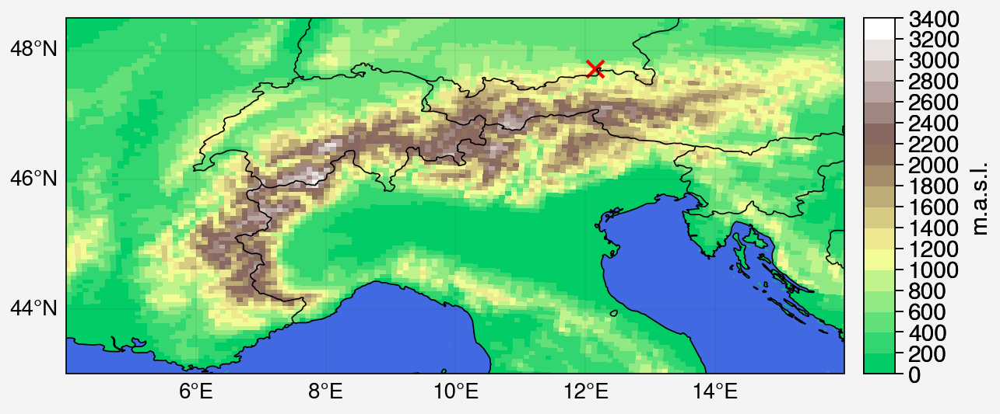

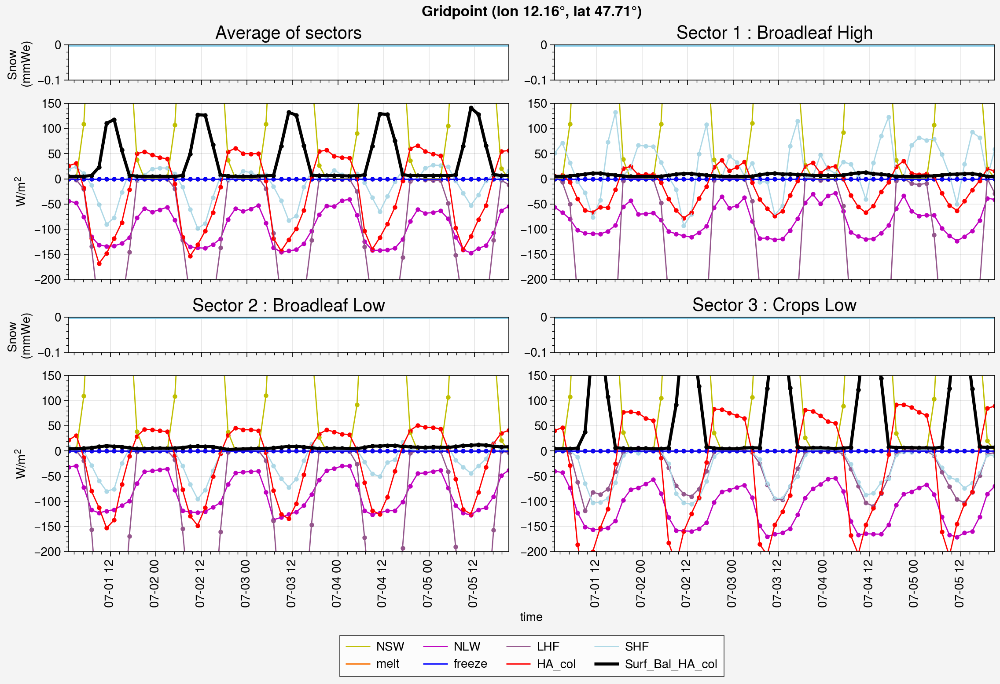

In [39]:
plot_by_mosaic(ds_var = ds_e16_k, ds_var_ave = ds_e16_ave, first=0, last=-1, iloc = i1, jloc = j1, ymin = -200, ymax = 150,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_411672/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_411672/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


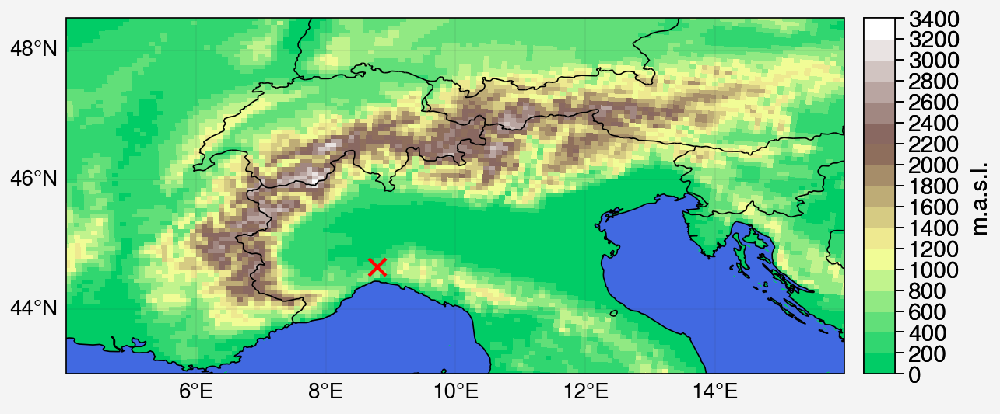

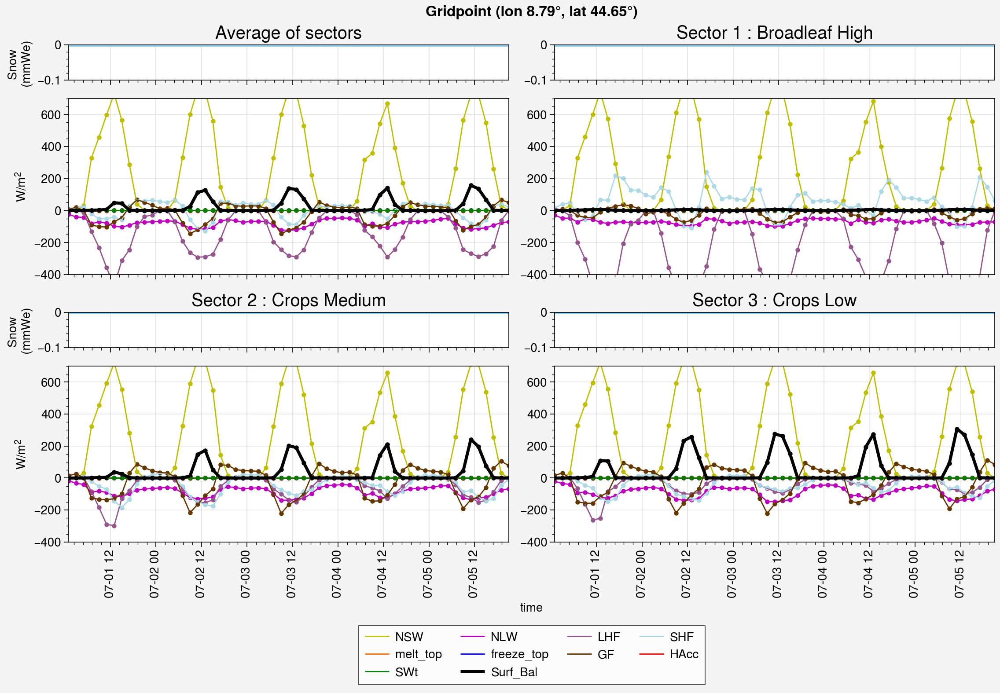

In [21]:
plot_by_mosaic(ds_var = ds_e16_k, ds_var_ave = ds_e16_ave, first=0, last=-1, iloc = i2, jloc = j2, ymin = -400, ymax = 700,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

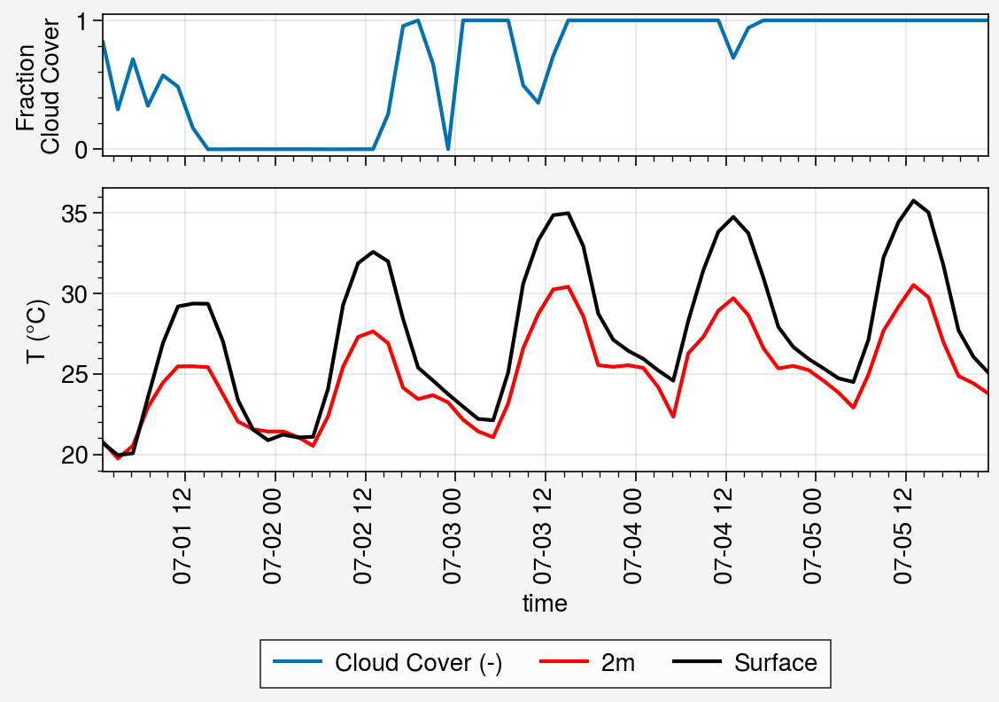

In [28]:
f, axs = pplt.subplots(axwidth=5,axheight=0.8,ncols=1,nrows=2,hratios=(1,2),ref=1,sharey=False)

axs[0].plot(ds_e16_ave.time, ds_e16_ave.CC[:,i2,j2])
axs[0].format(ylabel='Fraction\nCloud Cover')

axs[1].plot(ds_e16_ave.time, ds_e16_ave.TT2[:,i2,j2],label = '2m', c='r')
axs[1].plot(ds_e16_ave.time, ds_e16_ave.ST[:,i2,j2], label = 'Surface', c='k')
axs[1].format(ylabel='T (°C)')

f.legend(loc='b',prop = { "size": 10 },ncols=4)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_1195800/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_1195800/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


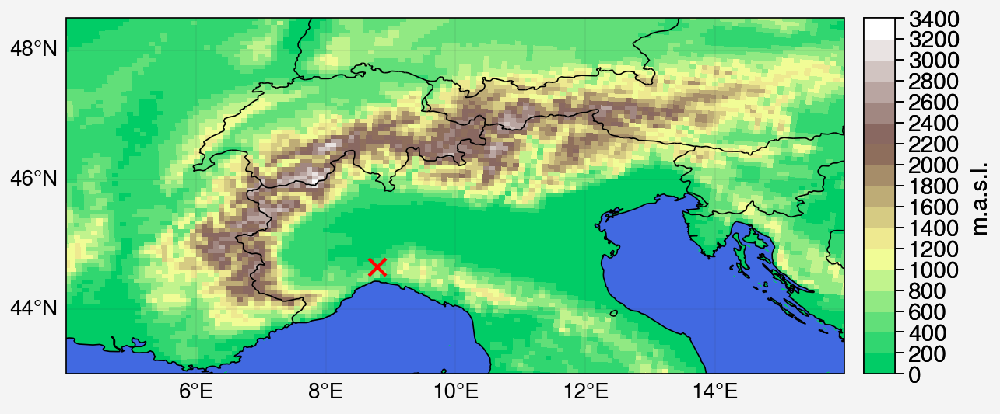

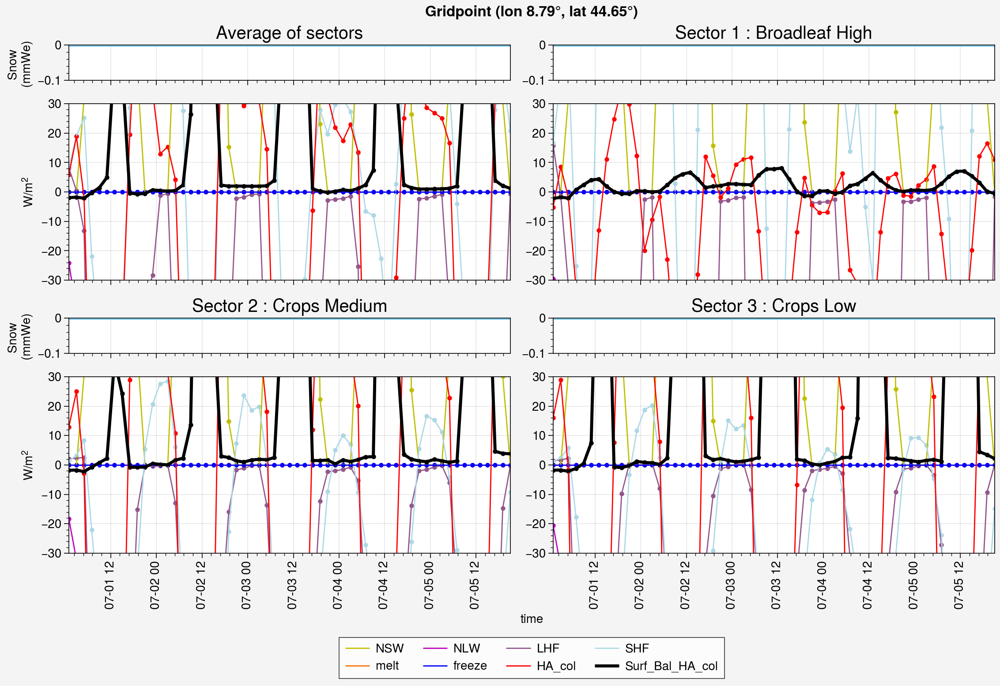

In [48]:
plot_by_mosaic(ds_var = ds_e16_k, ds_var_ave = ds_e16_ave, first=0, last=-1, iloc = i2, jloc = j2, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_1195800/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_1195800/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


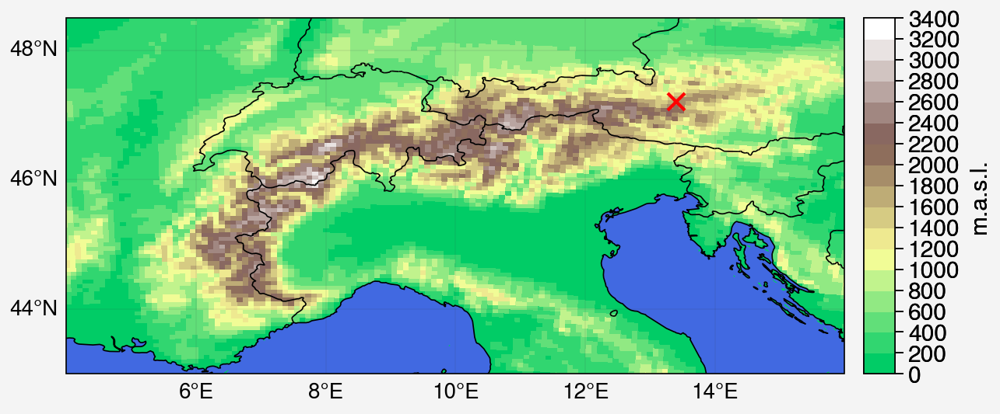

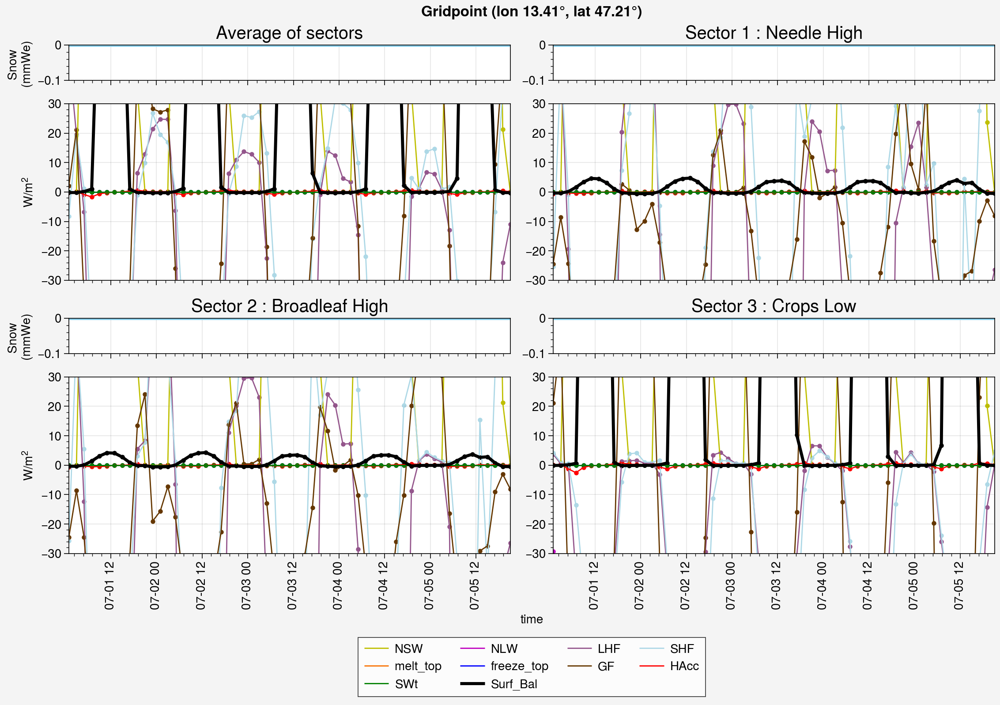

In [49]:
plot_by_mosaic(ds_var = ds_e16_k, ds_var_ave = ds_e16_ave, first=0, last=-1, iloc = i_f, jloc = j_f, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_1195800/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_1195800/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


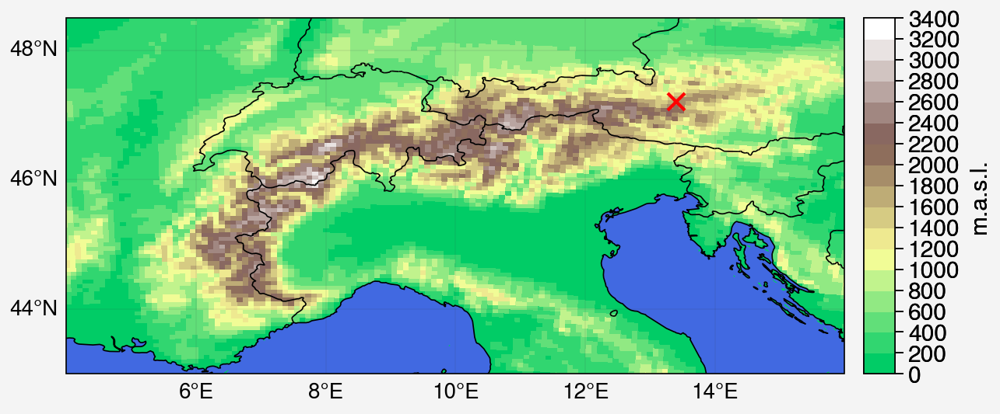

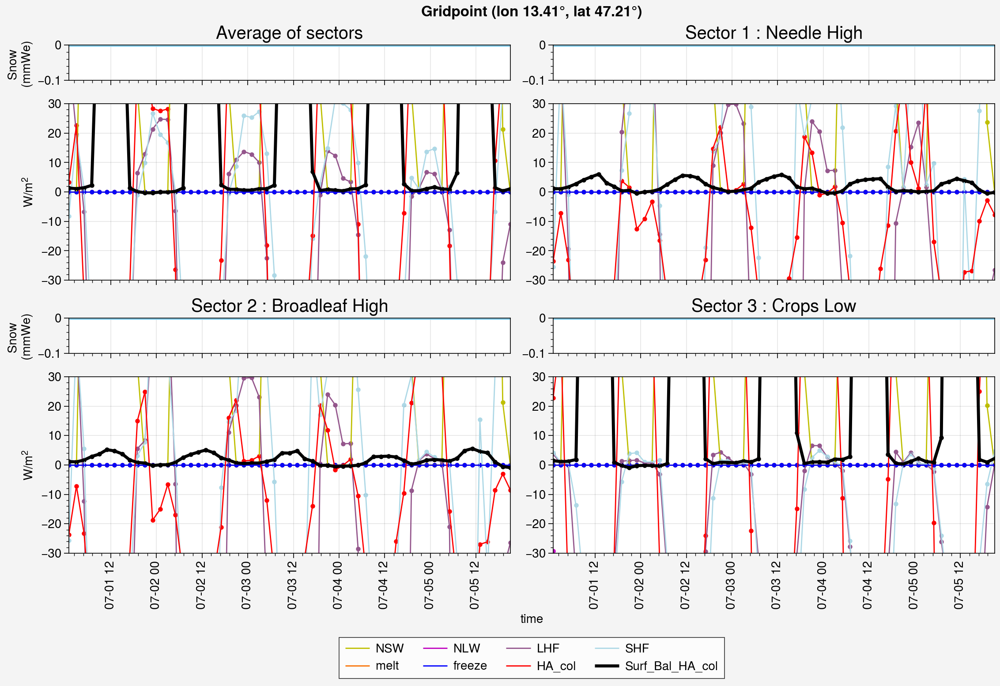

In [50]:
plot_by_mosaic(ds_var = ds_e16_k, ds_var_ave = ds_e16_ave, first=0, last=-1, iloc = i_f, jloc = j_f, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_1195800/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_1195800/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


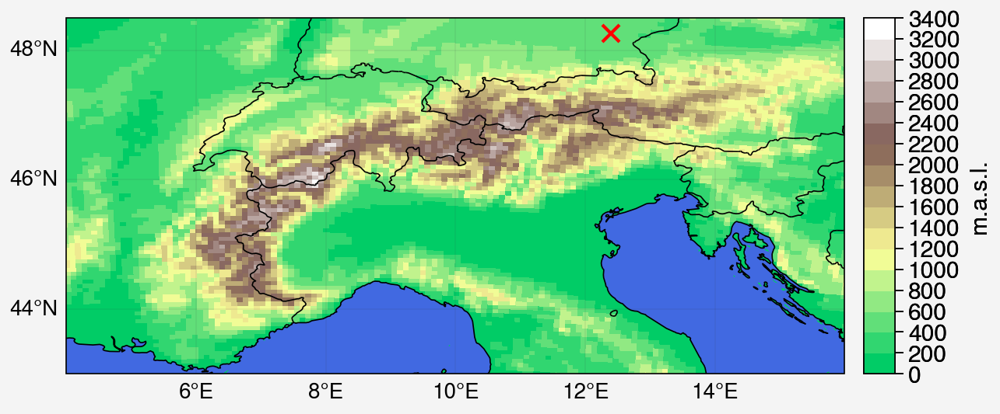

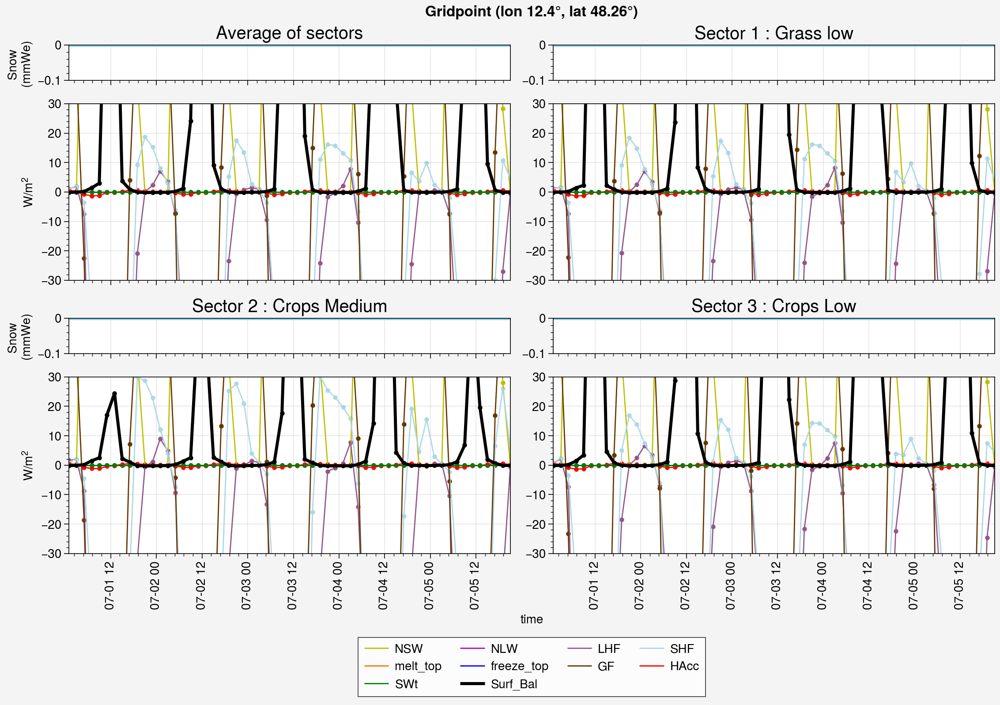

In [51]:
plot_by_mosaic(ds_var = ds_e16_k, ds_var_ave = ds_e16_ave, first=0, last=-1, iloc = i_m, jloc = j_m, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt_top','freeze_top','GF','HAcc','SWt','Surf_Bal'],
               colors = ['y','m','purple','lightblue','orange','blue','brown','r','green','k'])

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/tmp/ipykernel_1195800/1935158804.py:19: ProplotWarning: rc setting 'small' was renamed to 'font.smallsize' in version 0.6.
  pplt.rc.update(small=10, large=12)
/tmp/ipykernel_1195800/1935158804.py:19: ProplotWarning: rc setting 'large' was renamed to 'font.largesize' in version 0.6.
  pplt.rc.update(small=10, large=12)


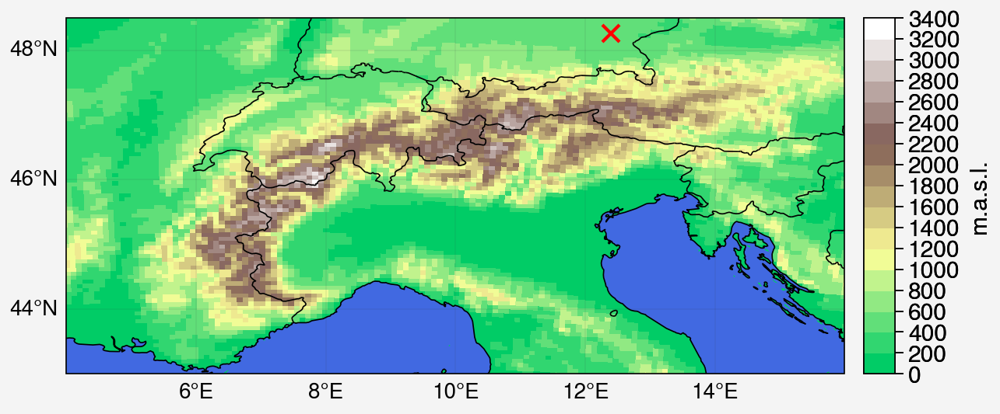

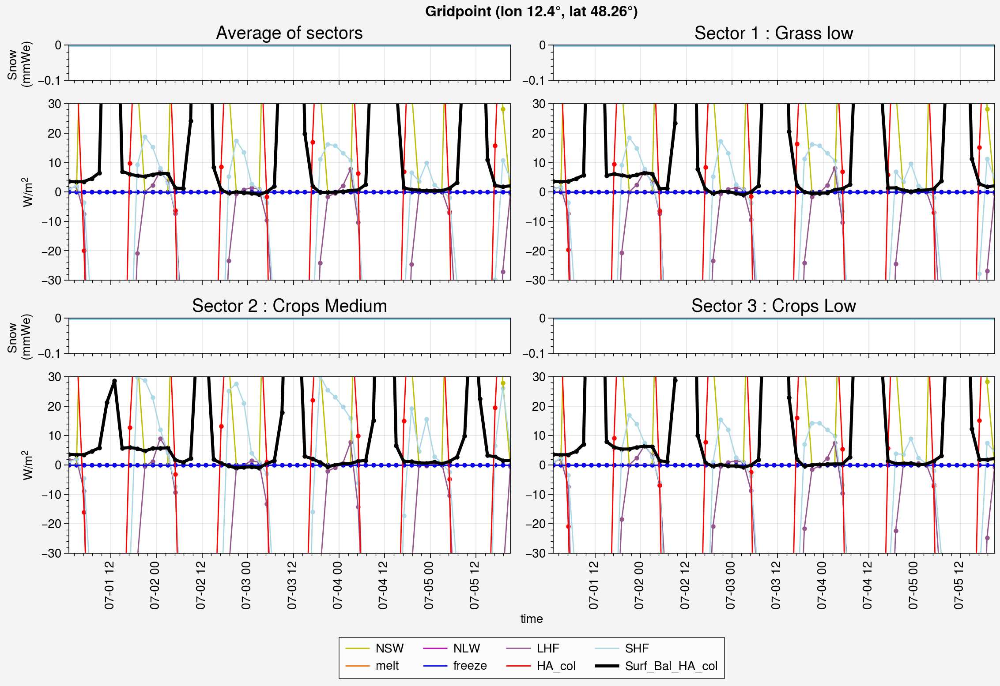

In [52]:
plot_by_mosaic(ds_var = ds_e16_k, ds_var_ave = ds_e16_ave, first=0, last=-1, iloc = i_m, jloc = j_m, ymin = -30, ymax = 30,
               names_var = ['NSW','NLW','LHF','SHF','melt','freeze','HA_col','Surf_Bal_HA_col'],
               colors = ['y','m','purple','lightblue','orange','blue','r','k'])

## Long simulation in small domain

In [38]:
# Coord Grenoble
lon_gre = 5.73
lat_gre = 45.19

# Small domain
small_domain = alps
small_domain[10:70,5:65] = True
small_domain[60:] = False
small_domain[:,60:] = False

In [39]:
print(lon[10:70,5:65].min())
print(lon[10:70,5:65].max())

4.22567
9.710002


In [40]:
print(lat[10:70,5:65].min())
print(lat[10:70,5:65].max())

43.684605
47.432182


In [41]:
lon_mid = (lon[10:70,5:65].min() + lon[10:70,5:65].max())/2
lat_mid = (lat[10:70,5:65].min() + lat[10:70,5:65].max())/2

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "


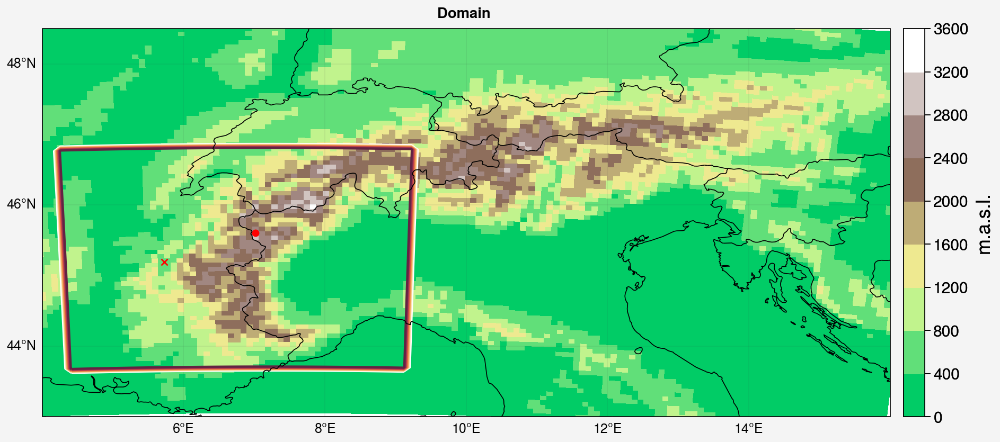

In [42]:
f, axs = pplt.subplots(proj='cyl',axwidth = 8)

colors_land = plt.cm.terrain(np.linspace(0.25, 1, 256))


m = axs.pcolormesh(lon,lat,H,cmap=colors_land)
axs.plot(lon_gre, lat_gre,'rx',markersize=4)
#axs.plot(lon_mid, lat_mid,'ro',markersize=4)
axs.plot(lon[40,35], lat[40,35],'ro',markersize=4)


f.colorbar(m,label= 'm.a.s.l.',labelsize='x-large',ticklabelsize='large')
axs.contour(lon, lat,small_domain)
#axs.contour(lon, lat,alps)

axs.format(**normal_format,suptitle="Domain ")
#axs.format(ocean=True,oceancolor='lightgray',reso='hi')#, latlim=[40.,51.],lonlim=[0.,20.])


In [43]:
alps

array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])

In [44]:
small_domain

array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])

#### Test short sim on new domain

In [23]:
ds_f02_k = open_monthly_data_k(year = '2020', month='01',days_in_month='05',sim='f02',day_average=False,HA_col=True,timestep_in_hours = 4)

# careful, need to change imin, imax, jmin, jmax

In [24]:
ds_f02_k

<xarray.Dataset>
Dimensions:      (time: 90, sector: 3, y: 25, x: 0, ztqlev: 3)
Coordinates:
  * time         (time) datetime64[ns] 2020-01-01T02:00:00 ... 2020-01-15T22:...
  * x            (x) float32 
  * y            (y) float32 -63.0 -56.0 -49.0 -42.0 ... 84.0 91.0 98.0 105.0
  * sector       (sector) float32 1.0 2.0 3.0
  * ztqlev       (ztqlev) float32 2.0 10.0 100.0
Data variables: (12/30)
    GFk          (time, sector, y, x) float32 ...
    SWUk         (time, sector, y, x) float32 ...
    SWD          (time, y, x) float32 ...
    HAcck        (time, sector, y, x) float32 ...
    LWUk         (time, sector, y, x) float32 ...
    LWD          (time, y, x) float32 ...
    ...           ...
    meltk        (time, sector, y, x) float32 
    freezek      (time, sector, y, x) float32 
    melt_topk    (time, sector, y, x) float32 
    freeze_topk  (time, sector, y, x) float32 
    TT2          (time, y, x) float32 ...
    Surf_Balk    (time, y, x, sector) float32 
Attributes:
    title:        ICE - Exp: f02 - 20200101
    institution:  ULg (Xavier Fettweis)
    history:      libUN (2005.04.08) - Thu May 15 15:14:24 2025
    netcdf:       4.8.0 of May  2 2023 12:43:48 $

In [30]:
ds_day = xr.open_dataset('/bettik/castelli/MARout/EUf/f02/2020/ICE.f02.2020.01.01-05.nc')[["GFk","SWUk","SWD","HAcck","LWUk","LWD","SHFk","LHFk",
                                                                                           "MBm","MBr","MBmTop","MBrTop","MB","LON","LAT",
                                                                                           "FRV","VEG","ETSo_d","SAbs_vk","SAbs",
                                                                                           "TTz","ST","SWtk"]].groupby("time.day").mean()

In [29]:
ds_day


<xarray.Dataset>
Dimensions:  (day: 15, sector: 3, y: 60, x: 60, ztqlev: 3)
Coordinates:
  * x        (x) float32 -203.0 -196.0 -189.0 -182.0 ... 189.0 196.0 203.0 210.0
  * y        (y) float32 -203.0 -196.0 -189.0 -182.0 ... 189.0 196.0 203.0 210.0
  * sector   (sector) float32 1.0 2.0 3.0
  * ztqlev   (ztqlev) float32 2.0 10.0 100.0
  * day      (day) int64 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15
Data variables: (12/21)
    GFk      (day, sector, y, x) float32 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0
    SWUk     (day, sector, y, x) float32 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0
    SWD      (day, y, x) float32 0.0 89.4 89.37 89.33 ... 84.72 84.87 85.02 0.0
    HAcck    (day, sector, y, x) float32 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0
    LWUk     (day, sector, y, x) float32 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0
    LWD      (day, y, x) float32 0.0 264.0 264.3 264.5 ... 159.2 157.8 156.4 0.0
    ...       ...
    ETSo_d   (day, y, x) float32 0.0 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    SAbs_vk  (day, sector, y, x) float32 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0
    SAbs     (day, y, x) float32 0.0 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
    TTz      (day, ztqlev, y, x) float32 13.08 13.13 13.18 ... -21.56 -21.94
    ST       (day, y, x) float32 0.0 13.06 13.08 13.11 ... -32.63 -32.89 0.0
    SWtk     (day, sector, y, x) float32 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0
Attributes:
    title:        ICE - Exp: f02 - 20200101
    institution:  ULg (Xavier Fettweis)
    history:      libUN (2005.04.08) - Thu May 15 15:14:24 2025
    netcdf:       4.8.0 of May  2 2023 12:43:48 $

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "


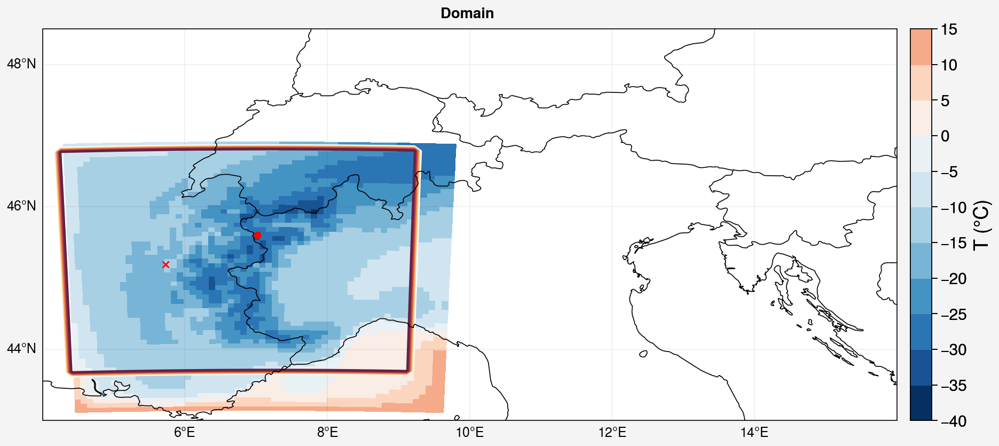

In [46]:
f, axs = pplt.subplots(proj='cyl',axwidth = 8)


m = axs.pcolormesh(ds_day.LON[0],ds_day.LAT[0],ds_day.TTz[0,0],cmap='RdBu_r')
axs.plot(lon_gre, lat_gre,'rx',markersize=4)
#axs.plot(lon_mid, lat_mid,'ro',markersize=4)
axs.plot(lon[40,35], lat[40,35],'ro',markersize=4)


f.colorbar(m,label= 'T (°C)',labelsize='x-large',ticklabelsize='large')
axs.contour(lon, lat,small_domain)
#axs.contour(lon, lat,alps)

axs.format(**normal_format,suptitle="Domain ")

In [36]:
(ds_day.LON[0] == ds_day.LON[14]).all()

<xarray.DataArray 'LON' ()>
array(True)